In [1]:
#!pip install statsmodels matplotlib
#!pip install matplotlib
#!pip install pandas
#!pip install datetime
#!pip install seaborn
#!pip install pmdarima

In [2]:
import pandas as pd
import numpy as np
from datetime import datetime
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf
import statsmodels.api as sm
from scipy.stats import boxcox
import seaborn as sns
from scipy.stats import norm

In [3]:
def model_comparison(actual, forecast):
    n = len(actual)
    error = actual - forecast
    mean = np.mean(actual)
    sd = np.std(actual)
    CV = sd / mean
    FBias = np.sum(error) / np.sum(actual)
    MAPE = np.sum(np.abs(error / actual)) / n
    RMSE = np.sqrt(np.sum(error ** 2) / n)
    ME = np.sum(error) / n
    MAD = np.sum(np.abs(error)) / n
    MADP = np.sum(np.abs(error)) / np.sum(np.abs(actual))
    WMAPE = MAD / mean
    l = pd.DataFrame({
        'n': [n],
        'mean': [mean],
        'sd': [sd],
        'CV': [CV],
        'FBias': [FBias],
        'MAPE': [MAPE],
        'RMSE': [RMSE],
        'ME': [ME],
        'MAD': [MAD],
        'MADP': [MADP],
        'WMAPE': [WMAPE]
    })
    return l

In [4]:
production_data = pd.read_csv("production.csv")
production_data['date'] = pd.to_datetime(production_data['date'])
production_data['hour'] = pd.to_timedelta(production_data['hour'], unit='h')
production_data['date_hour'] = production_data['date'] + production_data['hour']
production_data = production_data.drop(['date', 'hour'], axis=1)
production_data = production_data.sort_values(by='date_hour')
production_data = production_data.drop_duplicates()


In [5]:
weather_data = pd.read_csv("processed_weather.csv")
weather_data['date'] = weather_data['date'].astype(str)
weather_data['hour'] = weather_data['hour'].apply(lambda x: f"{x:02d}")
weather_data['date_hour'] = pd.to_datetime(weather_data['date'] + ' ' + weather_data['hour'])
weather_data = weather_data.drop(['date', 'hour'], axis=1)
weather_data = weather_data.sort_values(by='date_hour')
weather_data = weather_data.drop_duplicates()
weather_data = weather_data[(weather_data['date_hour'] >= '2022-01-01 00:00:00') & (weather_data['date_hour'] <= '2024-05-09 23:00:00')]

zero_tmp_indices = weather_data[weather_data['tmp_surface'] == 0].index
avg_tmp = (weather_data['tmp_surface'].shift(-1) + weather_data['tmp_surface'].shift(1)) / 2
weather_data.loc[zero_tmp_indices, 'tmp_surface'] = avg_tmp[zero_tmp_indices]
weather_data['tmp_surface'].fillna(method='bfill', inplace=True)
weather_data['tmp_surface'].fillna(method='ffill', inplace=True)

def aggregate_data(data, variable_name):
    aggregated_data = data.groupby(['lon', 'lat', 'date_hour'])[variable_name].mean().unstack(level=[0, 1])
    aggregated_data.columns = [f"{variable_name}_{lon}_{lat}" for lon, lat in aggregated_data.columns]
    return aggregated_data

dswrf_surface_data = aggregate_data(weather_data, 'dswrf_surface')
tcdc_low_cloud_layer_data = aggregate_data(weather_data, 'tcdc_low.cloud.layer')
tcdc_middle_cloud_layer_data = aggregate_data(weather_data, 'tcdc_middle.cloud.layer')
tcdc_high_cloud_layer_data = aggregate_data(weather_data, 'tcdc_high.cloud.layer')
tcdc_entire_atmosphere_data = aggregate_data(weather_data, 'tcdc_entire.atmosphere')
uswrf_top_of_atmosphere_data = aggregate_data(weather_data, 'uswrf_top_of_atmosphere')
csnow_surface_data = aggregate_data(weather_data, 'csnow_surface')
dlwrf_surface_data = aggregate_data(weather_data, 'dlwrf_surface')
uswrf_surface_data = aggregate_data(weather_data, 'uswrf_surface')
tmp_surface_data = aggregate_data(weather_data, 'tmp_surface')

dataframes = [dswrf_surface_data, tcdc_low_cloud_layer_data, tcdc_middle_cloud_layer_data,
              tcdc_high_cloud_layer_data, tcdc_entire_atmosphere_data, uswrf_top_of_atmosphere_data,
              csnow_surface_data, dlwrf_surface_data, uswrf_surface_data, tmp_surface_data]

widen_weather_data = pd.concat(dataframes, axis=1)
print(widen_weather_data.head(6))
#widen_weather_data.to_excel("widen_weather_data.xlsx", index=True)

/var/folders/52/b15y7xys6618m05jfvfgq1g40000gn/T/ipykernel_57377/1737224031.py:13: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  weather_data['tmp_surface'].fillna(method='bfill', inplace=True)
/var/folders/52/b15y7xys6618m05jfvfgq1g40000gn/T/ipykernel_57377/1737224031.py:14: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  weather_data['tmp_surface'].fillna(method='ffill', inplace=True)


                     dswrf_surface_34.5_37.75  dswrf_surface_34.5_38.0  \
date_hour                                                                
2022-01-01 04:00:00                      0.00                     0.00   
2022-01-01 05:00:00                      0.00                     0.00   
2022-01-01 06:00:00                      0.00                     0.00   
2022-01-01 07:00:00                      0.00                     0.00   
2022-01-01 08:00:00                      0.00                     0.00   
2022-01-01 09:00:00                      6.98                     7.08   

                     dswrf_surface_34.5_38.25  dswrf_surface_34.5_38.5  \
date_hour                                                                
2022-01-01 04:00:00                      0.00                     0.00   
2022-01-01 05:00:00                      0.00                     0.00   
2022-01-01 06:00:00                      0.00                     0.00   
2022-01-01 07:00:00                  

In [6]:
#production_data = production_data[(production_data['date_hour'] >= '2022-01-01 04:00:00') & (production_data['date_hour'] <= '2024-04-16 23:00:00')]
#production_data.to_excel("production_data.xlsx", index=False)
print(production_data)

       production           date_hour
0             0.0 2022-01-01 00:00:00
1             0.0 2022-01-01 01:00:00
2             0.0 2022-01-01 02:00:00
3             0.0 2022-01-01 03:00:00
4             0.0 2022-01-01 04:00:00
...           ...                 ...
20995         0.0 2024-05-24 19:00:00
20996         0.0 2024-05-24 20:00:00
20997         0.0 2024-05-24 21:00:00
20998         0.0 2024-05-24 22:00:00
20999         0.0 2024-05-24 23:00:00

[21000 rows x 2 columns]


In [7]:
merged_data = pd.merge(production_data, widen_weather_data, on='date_hour')
data_to_corr = merged_data.drop(['date_hour'], axis=1)
correlation_matrix = data_to_corr.corr()

#correlation_matrix.to_excel("correlation_matrix.xlsx", index=False)
print(correlation_matrix)

                          production  dswrf_surface_34.5_37.75  \
production                  1.000000                  0.603508   
dswrf_surface_34.5_37.75    0.603508                  1.000000   
dswrf_surface_34.5_38.0     0.605539                  0.983201   
dswrf_surface_34.5_38.25    0.607775                  0.973676   
dswrf_surface_34.5_38.5     0.599347                  0.974647   
...                              ...                       ...   
tmp_surface_35.5_37.75      0.554554                  0.690715   
tmp_surface_35.5_38.0       0.526741                  0.669415   
tmp_surface_35.5_38.25      0.533932                  0.688636   
tmp_surface_35.5_38.5       0.518725                  0.656628   
tmp_surface_35.5_38.75      0.557725                  0.725353   

                          dswrf_surface_34.5_38.0  dswrf_surface_34.5_38.25  \
production                               0.605539                  0.607775   
dswrf_surface_34.5_37.75                 0.983201

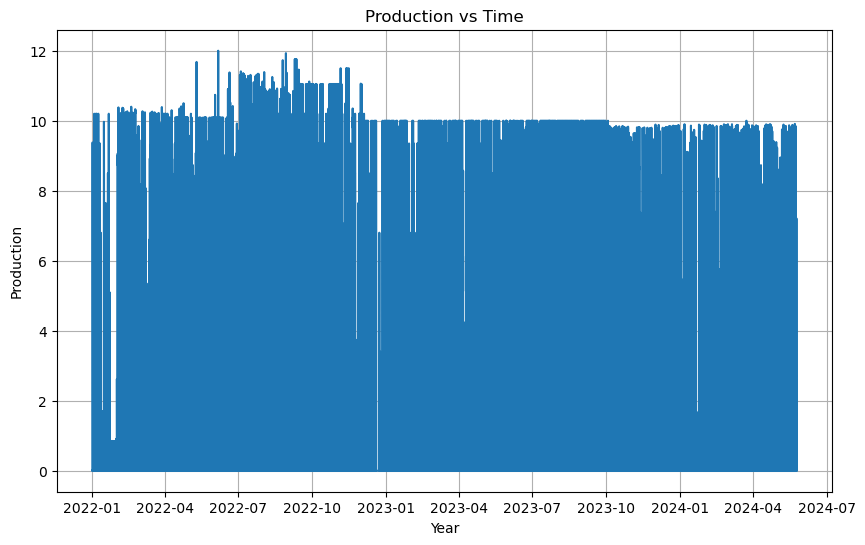

In [8]:
start_date = production_data['date_hour'].min()
ts_production = pd.Series(production_data['production'].values, 
                          index=production_data['date_hour'])

plt.figure(figsize=(10, 6))
plt.plot(ts_production.index, ts_production.values)
plt.title('Production vs Time')
plt.xlabel('Year')
plt.ylabel('Production')
plt.grid(True)
plt.show()

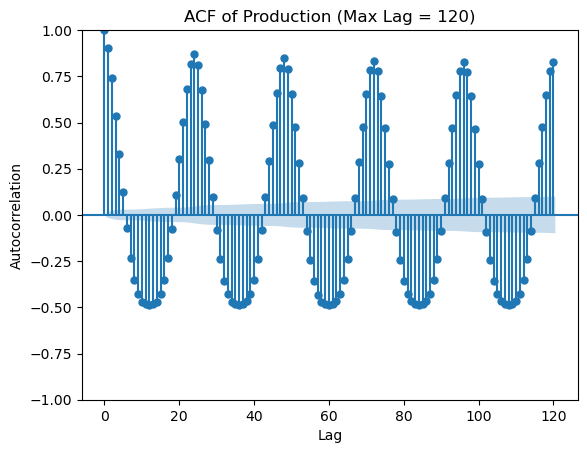

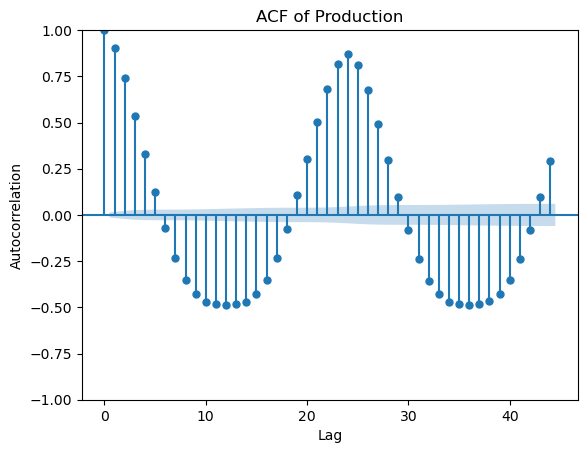

In [9]:
plot_acf(ts_production, lags=120)
plt.title('ACF of Production (Max Lag = 120)')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

plot_acf(ts_production)
plt.title('ACF of Production')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

In [10]:
def calculate_weights(data_point, grid_points):
    weights = []
    for grid_point in grid_points:
        distance = ((grid_point[0] - data_point[0]) ** 2 + (grid_point[1] - data_point[1]) ** 2)
        inv_distance = 1 / distance
        weights.append(inv_distance)

    total_weight = sum(weights)
    weights = [weight / total_weight for weight in weights]
    return weights

data_point = [38.29, 34.97]
grid_points = [[37.75, 34.5], [37.75, 34.75], [37.75, 35], [37.75, 35.25], [37.75, 35.5],
               [38, 34.5], [38, 34.75], [38, 35], [38, 35.25], [38, 35.5],
               [38.25, 34.5], [38.25, 34.75], [38.25, 35], [38.25, 35.25], [38.25, 35.5],
               [38.5, 34.5], [38.5, 34.75], [38.5, 35], [38.5, 35.25], [38.5, 35.5],
               [38.75, 34.5], [38.75, 34.75], [38.75, 35], [38.75, 35.25], [38.75, 35.5]
               ]

weights = calculate_weights(data_point, grid_points)
print("Weights for grid points:", weights)

Weights for grid points: [0.0035530422159244005, 0.00535568863429781, 0.0062254158484145415, 0.004921443609895269, 0.003180670979320956, 0.005970275854627074, 0.013742899137066127, 0.021422754537191262, 0.011205748527146132, 0.004988860645647245, 0.008183973643421381, 0.036418682713225375, 0.7283736542644993, 0.02276167669576544, 0.0064457845510132415, 0.0068714495685330305, 0.01968577443958109, 0.04046520301469402, 0.014864768454377413, 0.005602874263573044, 0.004210252336789015, 0.007003592829466331, 0.008569101814876428, 0.006279083226418066, 0.003697328194236022]


In [11]:
colnames = ['DSWRF_surface_data', 'TCDC_low_cloud_layer_data', 'TCDC_middle_cloud_layer_data',
              'TCDC_high_cloud_layer_data', 'TCDC_entire_atmosphere_data', 'USWRF_top_of_atmosphere_data',
              'CSNOW_surface_data', 'DLWRF_surface_data', 'USWRF_surface_data', 'TMP_surface_data']

print(production_data)
weighted_weather_data = pd.DataFrame()
for i in range(0, 250, 25):
    subset = widen_weather_data.iloc[:, i:i+25]
    weighted_subset = subset.mul(weights, axis=1)
    weighted_weather_data[colnames[i//25]] = weighted_subset.sum(axis=1)

print(weighted_weather_data.head(24))
#weighted_weather_data.to_excel("weighted_weather_data.xlsx", index=True)

#hour_18_data = weighted_weather_data[weighted_weather_data.index.hour == 18]
#hour_18_data.to_excel("hour_18_data.xlsx", index=True)

       production           date_hour
0             0.0 2022-01-01 00:00:00
1             0.0 2022-01-01 01:00:00
2             0.0 2022-01-01 02:00:00
3             0.0 2022-01-01 03:00:00
4             0.0 2022-01-01 04:00:00
...           ...                 ...
20995         0.0 2024-05-24 19:00:00
20996         0.0 2024-05-24 20:00:00
20997         0.0 2024-05-24 21:00:00
20998         0.0 2024-05-24 22:00:00
20999         0.0 2024-05-24 23:00:00

[21000 rows x 2 columns]
                     DSWRF_surface_data  TCDC_low_cloud_layer_data  \
date_hour                                                            
2022-01-01 04:00:00            0.000000                   0.575237   
2022-01-01 05:00:00            0.000000                   0.720000   
2022-01-01 06:00:00            0.000000                   2.053901   
2022-01-01 07:00:00            0.000000                   2.774758   
2022-01-01 08:00:00            0.000000                   3.268855   
2022-01-01 09:00:00         

In [12]:
merged_data = pd.merge(production_data, weighted_weather_data, on='date_hour', how='inner')
#merged_data = merged_data[(merged_data['date_hour'].dt.hour >= 7) & (merged_data['date_hour'].dt.hour <= 20)]
print(merged_data)
regression_1_data = merged_data
regression_2_data = merged_data

       production           date_hour  DSWRF_surface_data  \
0             0.0 2022-01-01 04:00:00            0.000000   
1             0.0 2022-01-01 05:00:00            0.000000   
2             0.0 2022-01-01 06:00:00            0.000000   
3             0.0 2022-01-01 07:00:00            0.000000   
4             3.4 2022-01-01 08:00:00            0.000000   
...           ...                 ...                 ...   
20631         0.0 2024-05-09 19:00:00          356.028278   
20632         0.0 2024-05-09 20:00:00          287.600006   
20633         0.0 2024-05-09 21:00:00          239.666645   
20634         0.0 2024-05-09 22:00:00            0.000000   
20635         0.0 2024-05-09 23:00:00            0.000000   

       TCDC_low_cloud_layer_data  TCDC_middle_cloud_layer_data  \
0                       0.575237                      1.101368   
1                       0.720000                      0.880516   
2                       2.053901                      1.061507   
3  

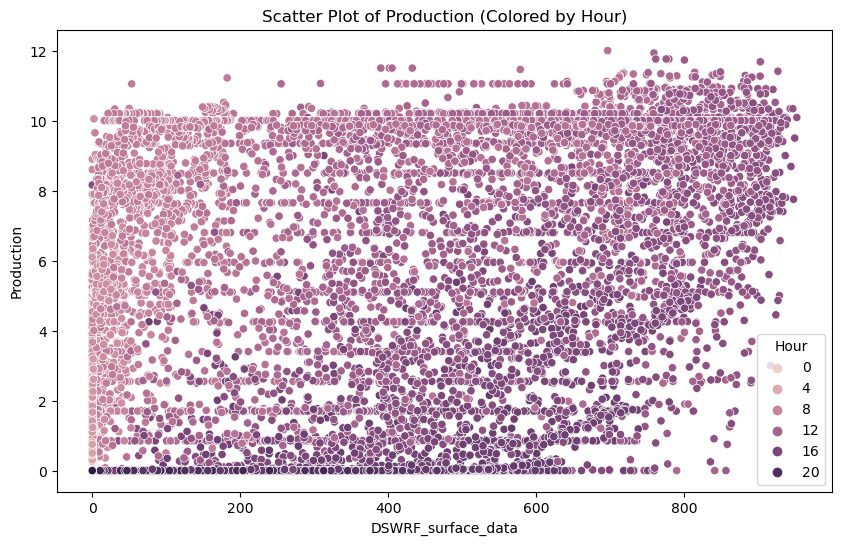

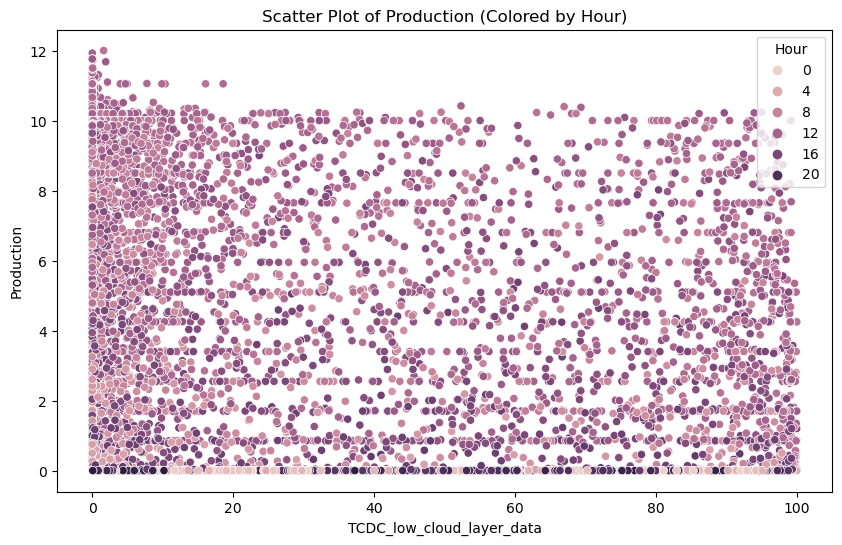

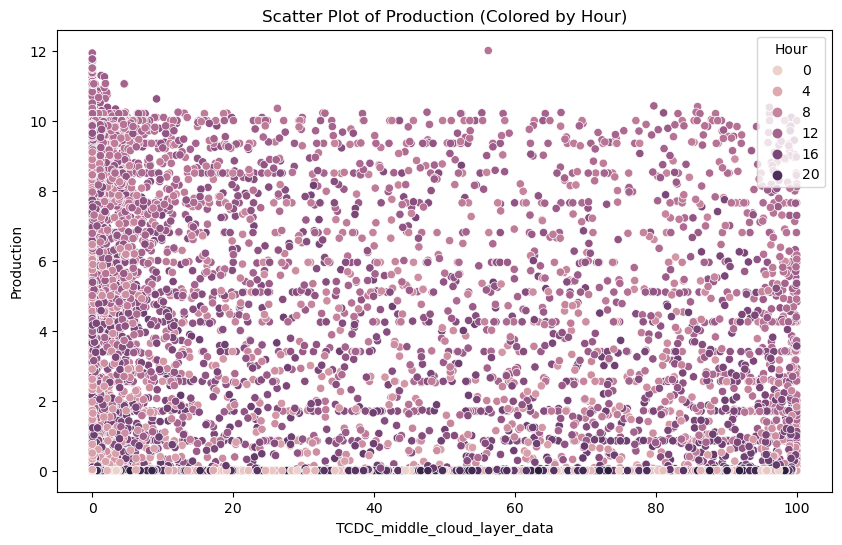

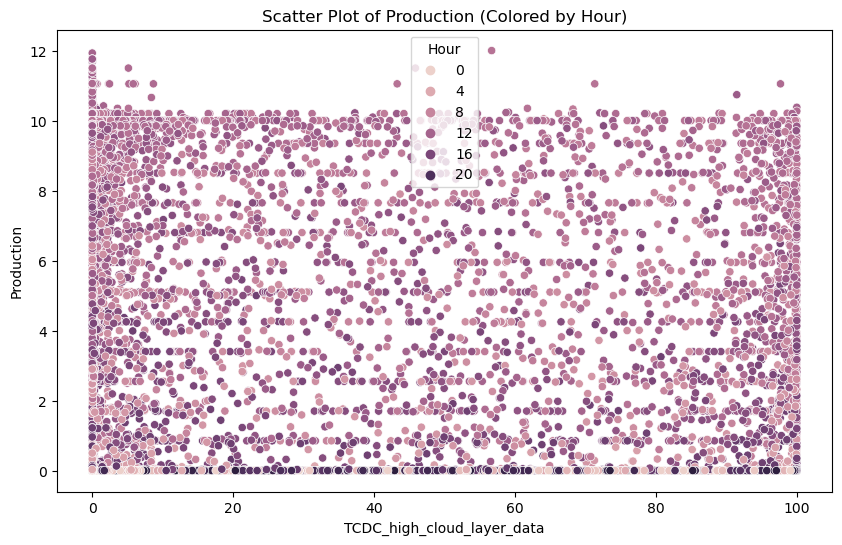

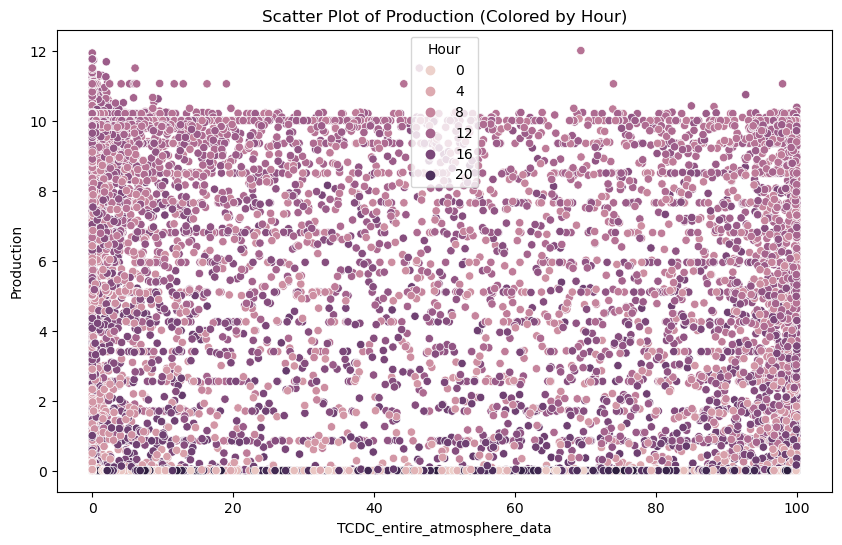

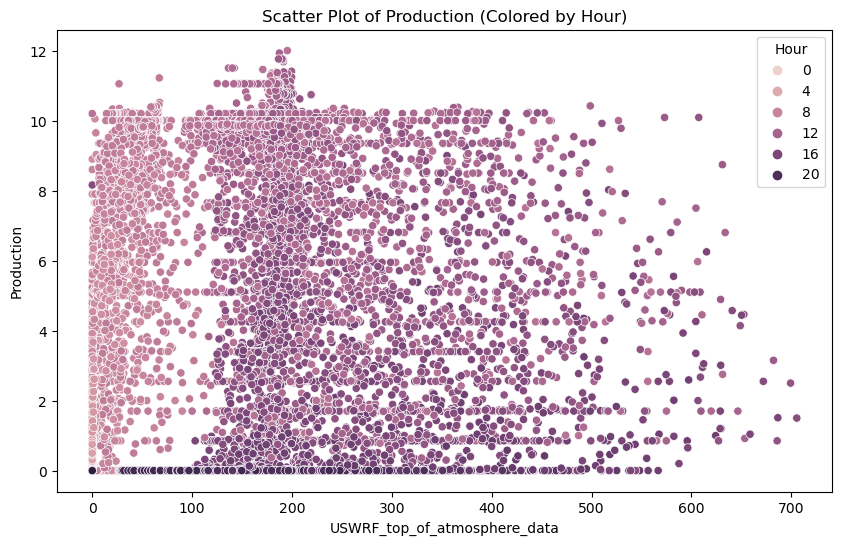

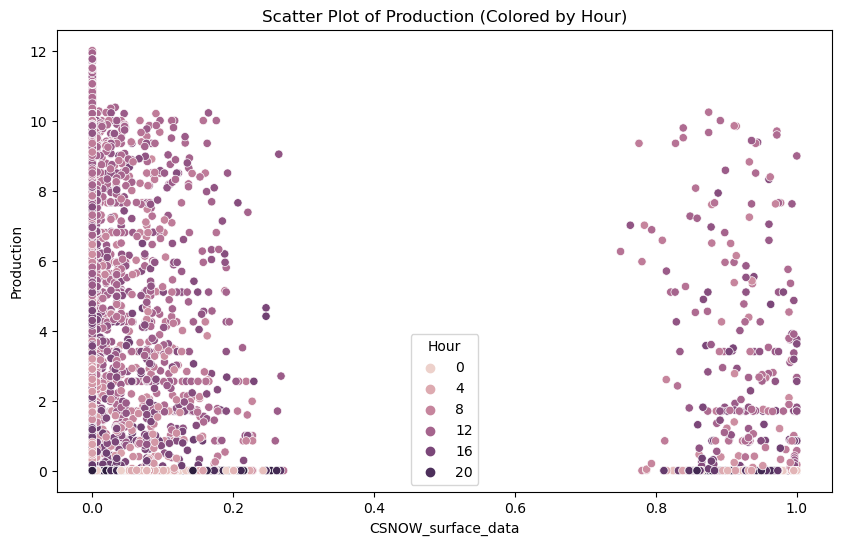

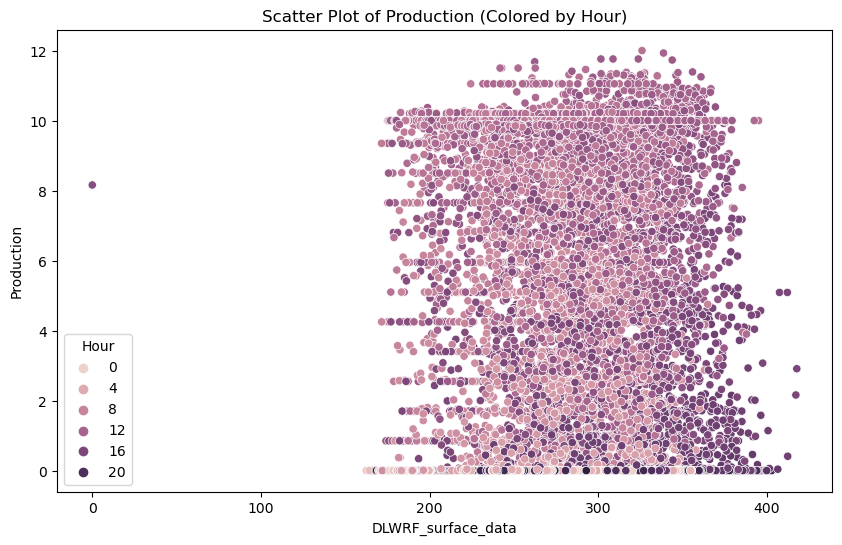

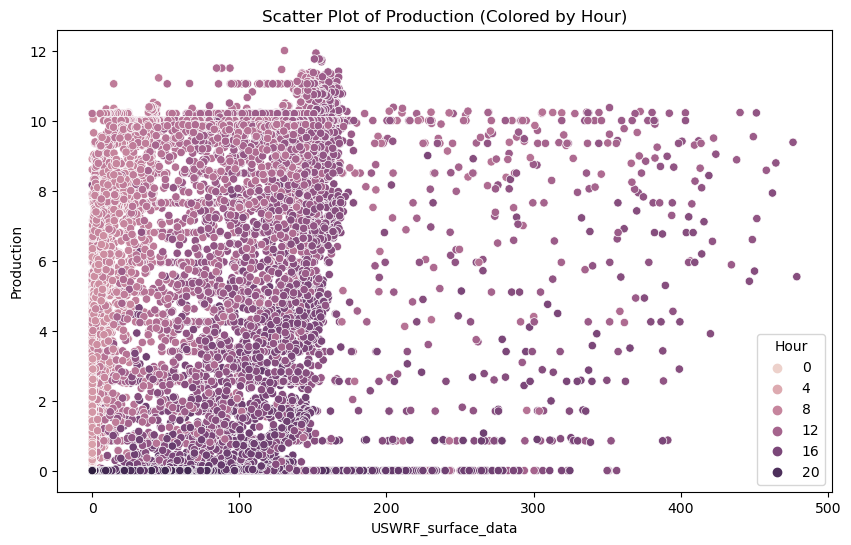

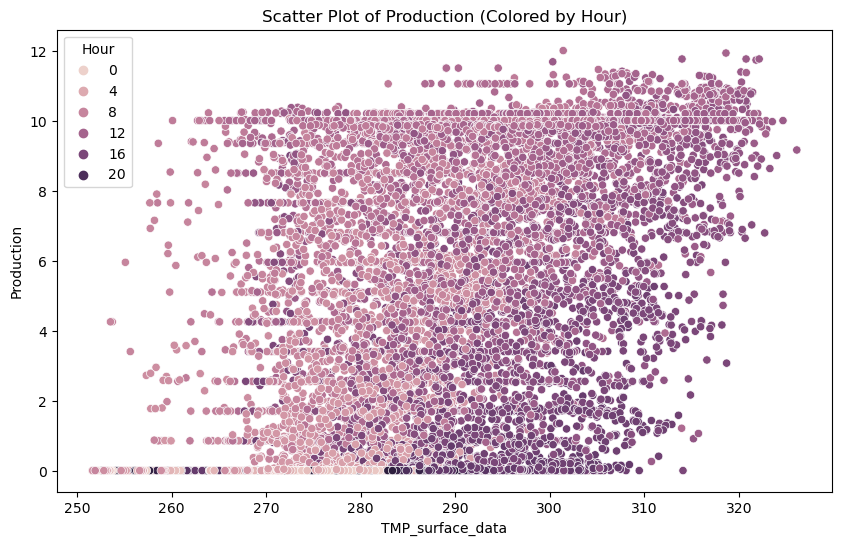

In [13]:
regression_1_data['hour'] = regression_1_data['date_hour'].dt.hour

for colname in colnames:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(x=colname, y='production', hue='hour', data=regression_1_data)
    plt.title('Scatter Plot of Production (Colored by Hour)')
    plt.xlabel(colname)
    plt.ylabel('Production')
    plt.legend(title='Hour')
    plt.show()

In [14]:
regression_1_data = pd.merge(production_data, weighted_weather_data, on='date_hour', how='inner')
regression_1_data.reset_index(drop=True, inplace=True)

regression_1_endo = regression_1_data['production']
regression_1_data = regression_1_data.drop(['date_hour', 'production'], axis=1)

exogenous_data_with_const = sm.add_constant(regression_1_data)
#When we add constant, there exists an outlier residual with 80 value, so I did not include constant term here.
model_1 = sm.OLS(regression_1_endo, regression_1_data)
result_1 = model_1.fit()

print(result_1.summary())

                                 OLS Regression Results                                
Dep. Variable:             production   R-squared (uncentered):                   0.610
Model:                            OLS   Adj. R-squared (uncentered):              0.610
Method:                 Least Squares   F-statistic:                              3224.
Date:                Wed, 05 Jun 2024   Prob (F-statistic):                        0.00
Time:                        11:26:08   Log-Likelihood:                         -50637.
No. Observations:               20636   AIC:                                  1.013e+05
Df Residuals:                   20626   BIC:                                  1.014e+05
Df Model:                          10                                                  
Covariance Type:            nonrobust                                                  
                                   coef    std err          t      P>|t|      [0.025      0.975]
-----------------------

0.05292352740058875
-0.2538636583883101
-0.2140306835715277
-0.21594929881151226
0.2807547269981371
0.08853945801493379
-23.58588148201226
1.4551506642510807
0.015111137846024402
-2.8313712769659585
                            OLS Regression Results                            
Dep. Variable:             production   R-squared:                       0.557
Model:                            OLS   Adj. R-squared:                  0.556
Method:                 Least Squares   F-statistic:                     2589.
Date:                Wed, 05 Jun 2024   Prob (F-statistic):               0.00
Time:                        11:26:09   Log-Likelihood:                -47867.
No. Observations:               20636   AIC:                         9.576e+04
Df Residuals:                   20625   BIC:                         9.584e+04
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
           

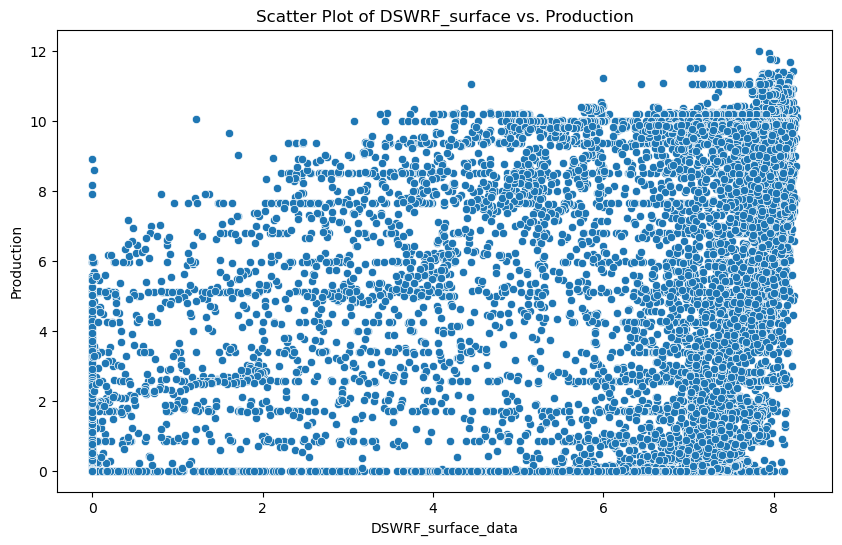

In [15]:
transformed_variables = {}
for column in ['DSWRF_surface_data', 'TCDC_low_cloud_layer_data', 'TCDC_middle_cloud_layer_data',
              'TCDC_high_cloud_layer_data', 'TCDC_entire_atmosphere_data', 'USWRF_top_of_atmosphere_data',
              'CSNOW_surface_data', 'DLWRF_surface_data', 'USWRF_surface_data', 'TMP_surface_data']:
    transformed_data, lambda_value = boxcox(regression_2_data[column] + 1)
    transformed_variables[column] = transformed_data
    print(lambda_value)

#regression_2_data['tr_production'], lambda_value = boxcox(regression_2_data['production'] + 1)
transformed_df = pd.DataFrame(transformed_variables)

exogenous_data_with_const = sm.add_constant(transformed_df)
model_2 = sm.OLS(regression_2_data['production'], exogenous_data_with_const)
result_2 = model_2.fit()

print(result_2.summary())

plt.figure(figsize=(10, 6))
sns.scatterplot(x=transformed_variables['DSWRF_surface_data'], y=regression_1_endo)
plt.title('Scatter Plot of DSWRF_surface vs. Production')
plt.xlabel('DSWRF_surface_data')
plt.ylabel('Production')
plt.show()

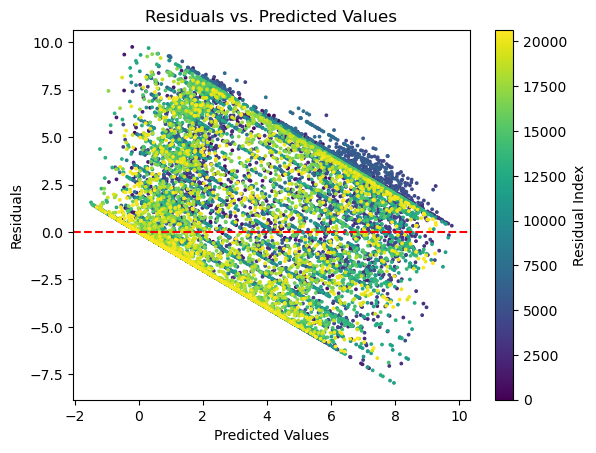

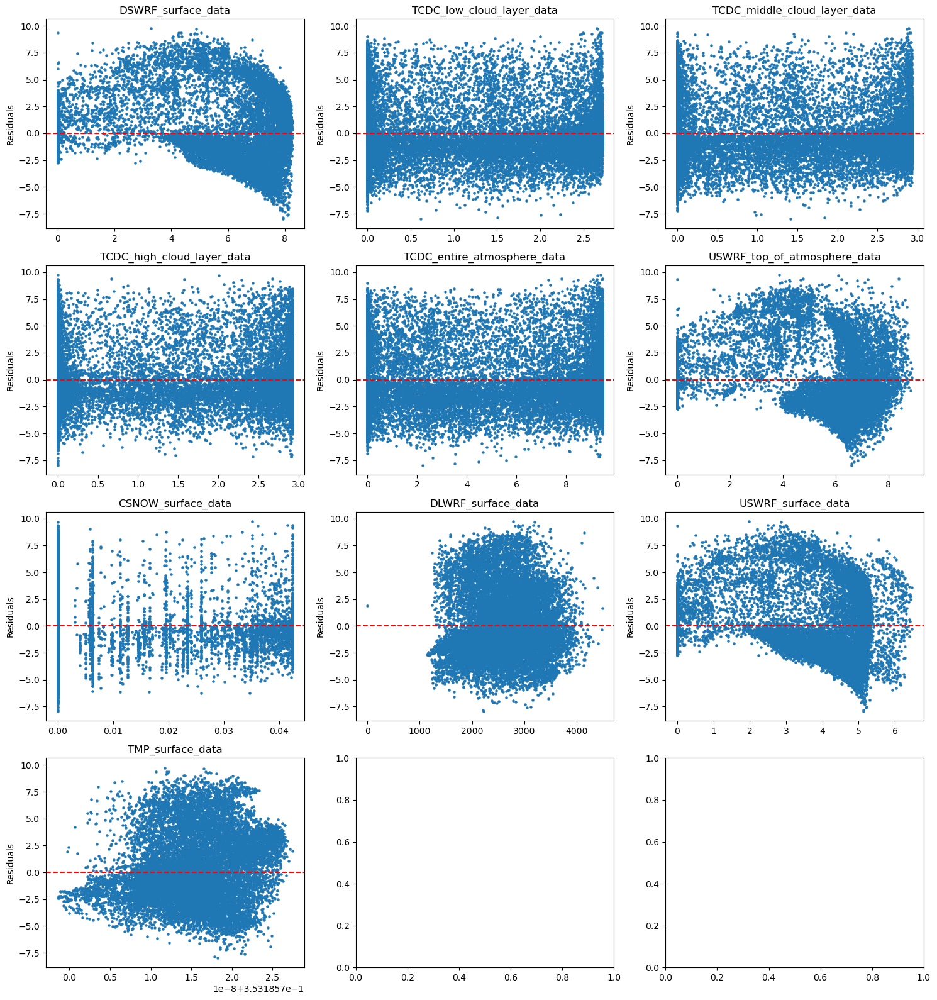

In [16]:
residuals_1 = result_1.resid
predicted_values_1 = result_1.predict()

colors = range(len(residuals_1))
plt.scatter(predicted_values_1, residuals_1, c=colors, cmap='viridis', s=3)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

num_columns = transformed_df.shape[1]
num_rows = (num_columns + 2) // 3

fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 4*num_rows))
axes = axes.flatten()

for i, column in enumerate(transformed_df.columns):
    if i < num_columns:
        axes[i].scatter(transformed_df[column][np.arange(len(transformed_df[column]))], residuals_1, s=5)
        axes[i].axhline(y=0, color='red', linestyle='--')
        axes[i].set_title('{}'.format(column))
        axes[i].set_ylabel('Residuals')

plt.tight_layout()
plt.show()

In [17]:
#print(extreme_residual_index_1)
#print(regression_1_endo[extreme_residual_index_1])
#print(regression_1_data.iloc[extreme_residual_index_1]) 

<Figure size 800x600 with 0 Axes>

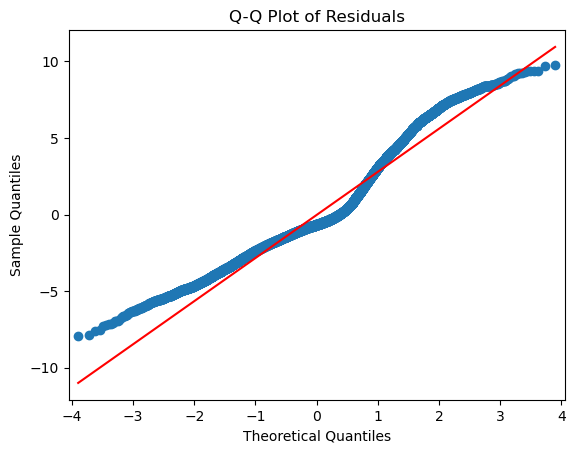

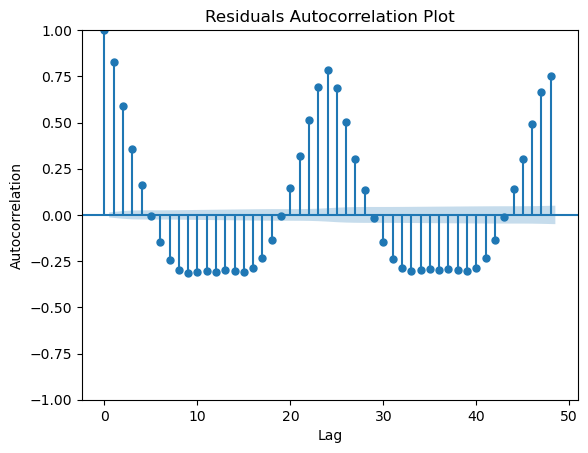

/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


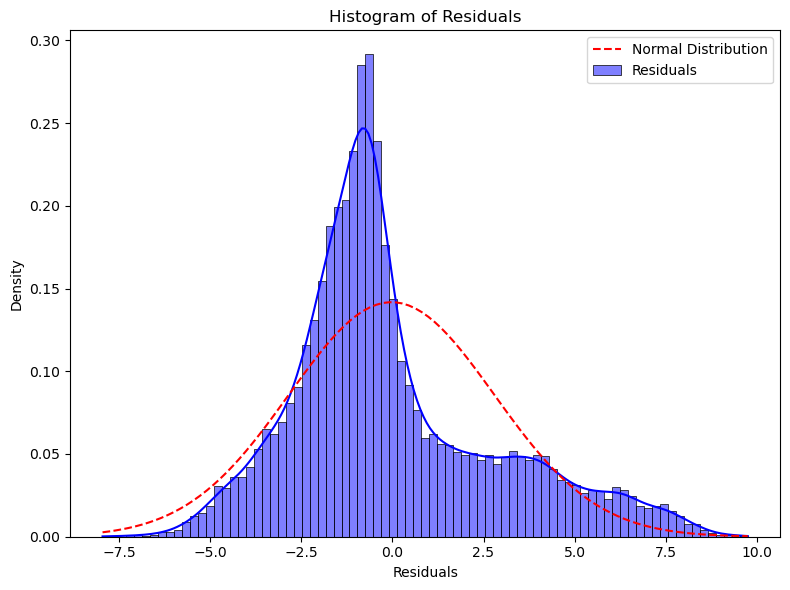

In [18]:
plt.figure(figsize=(8, 6))
sm.qqplot(residuals_1, line='s')
plt.title('Q-Q Plot of Residuals')
plt.show()

sm.graphics.tsa.plot_acf(residuals_1, lags=48)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Residuals Autocorrelation Plot')
plt.show()

mean_residuals = np.mean(residuals_1)
std_residuals = np.std(residuals_1)

plt.figure(figsize=(8, 6))
sns.histplot(residuals_1, kde=True, stat='density', color='blue', label='Residuals')

sns.lineplot(x=np.linspace(min(residuals_1), max(residuals_1), 100),
             y=norm.pdf(np.linspace(min(residuals_1), max(residuals_1), 100), mean_residuals, std_residuals),
             color='red', linestyle='--', label='Normal Distribution')

plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()

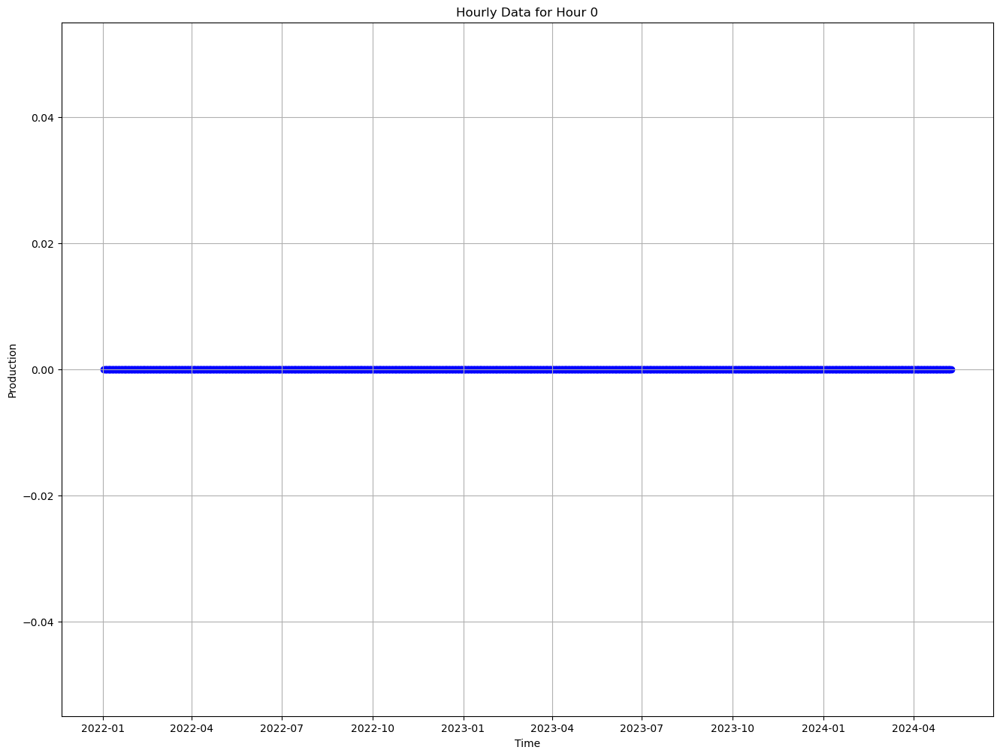

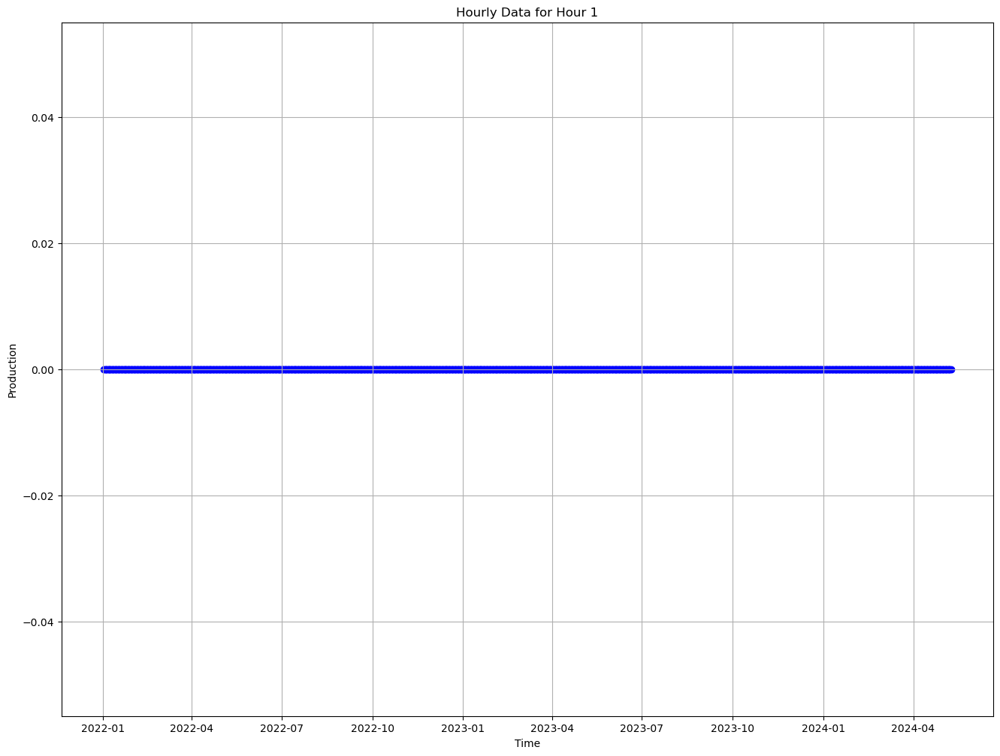

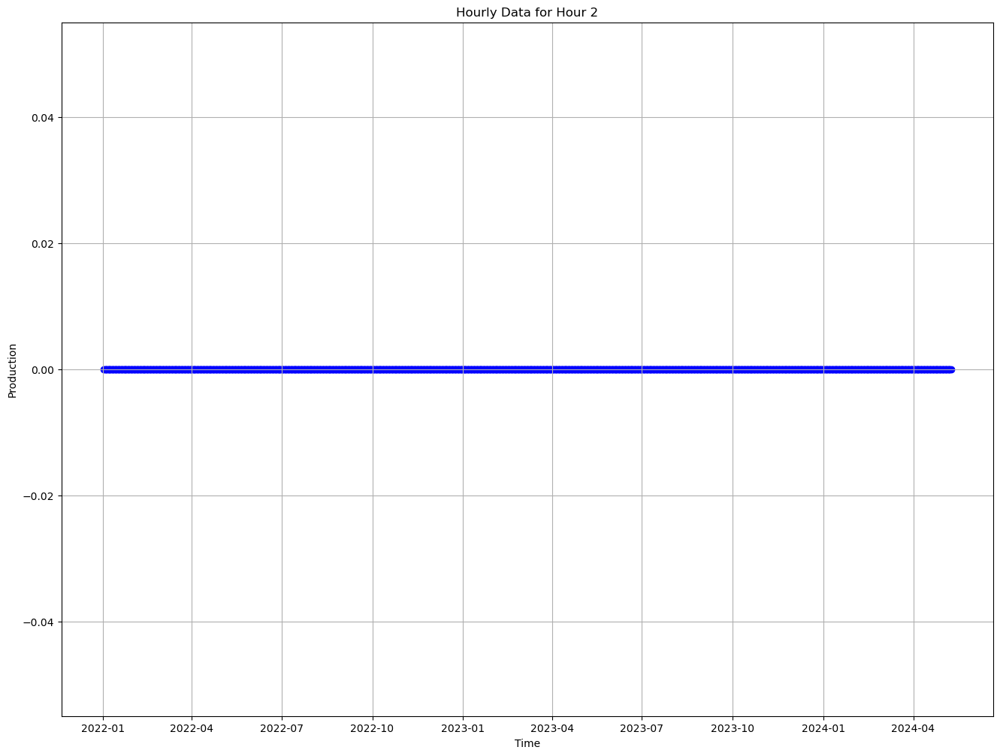

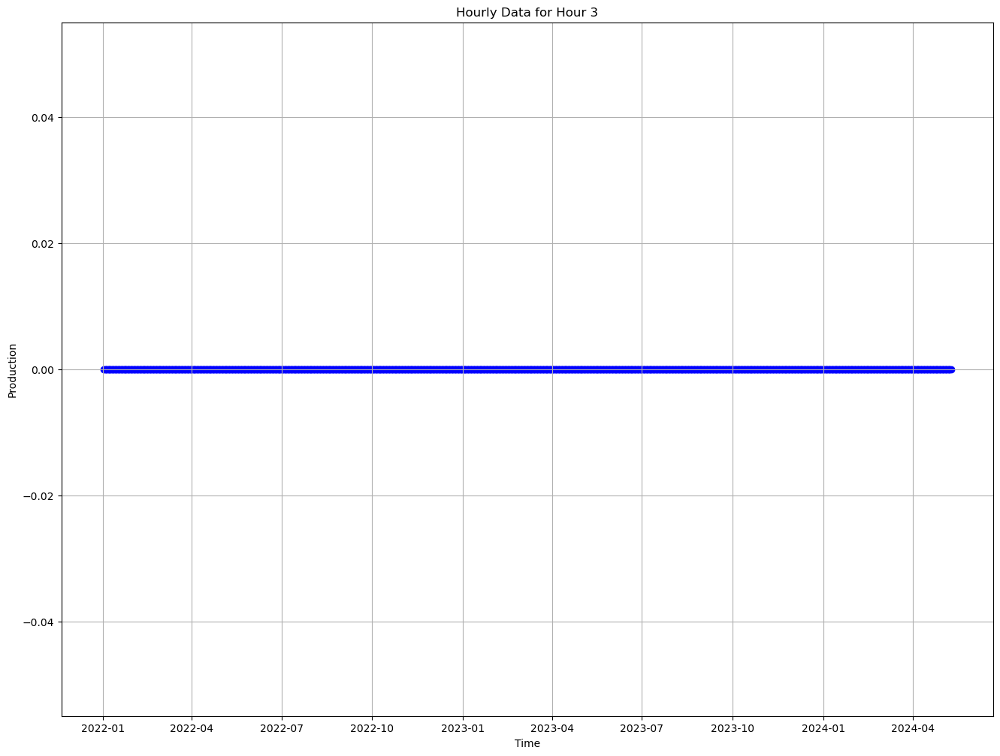

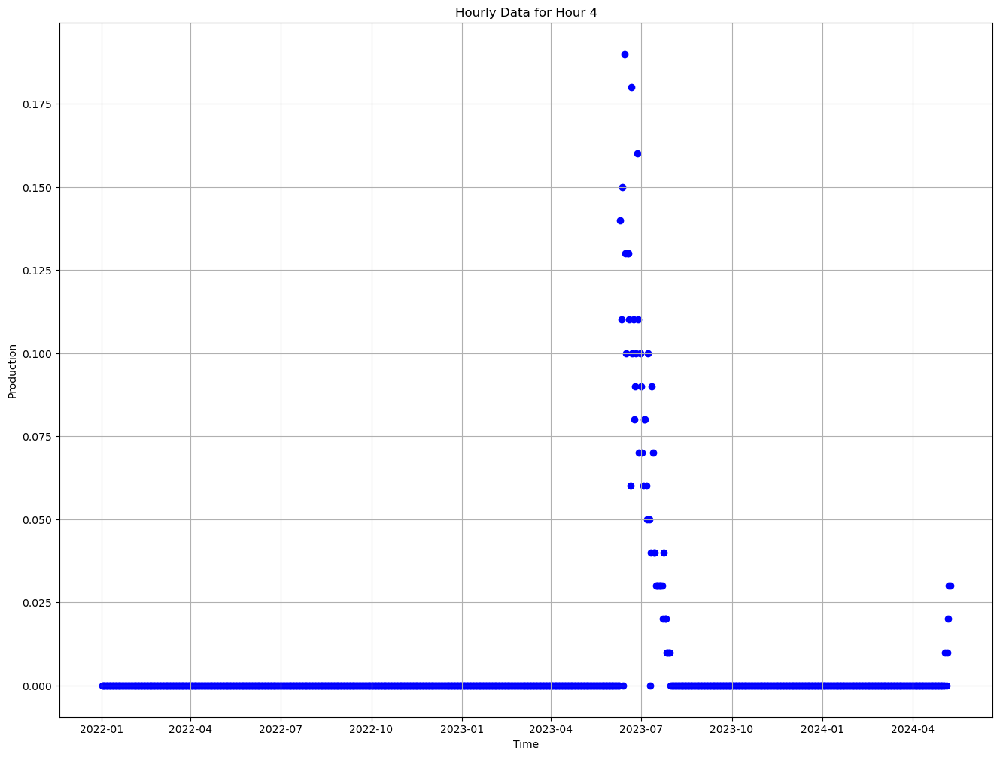

...

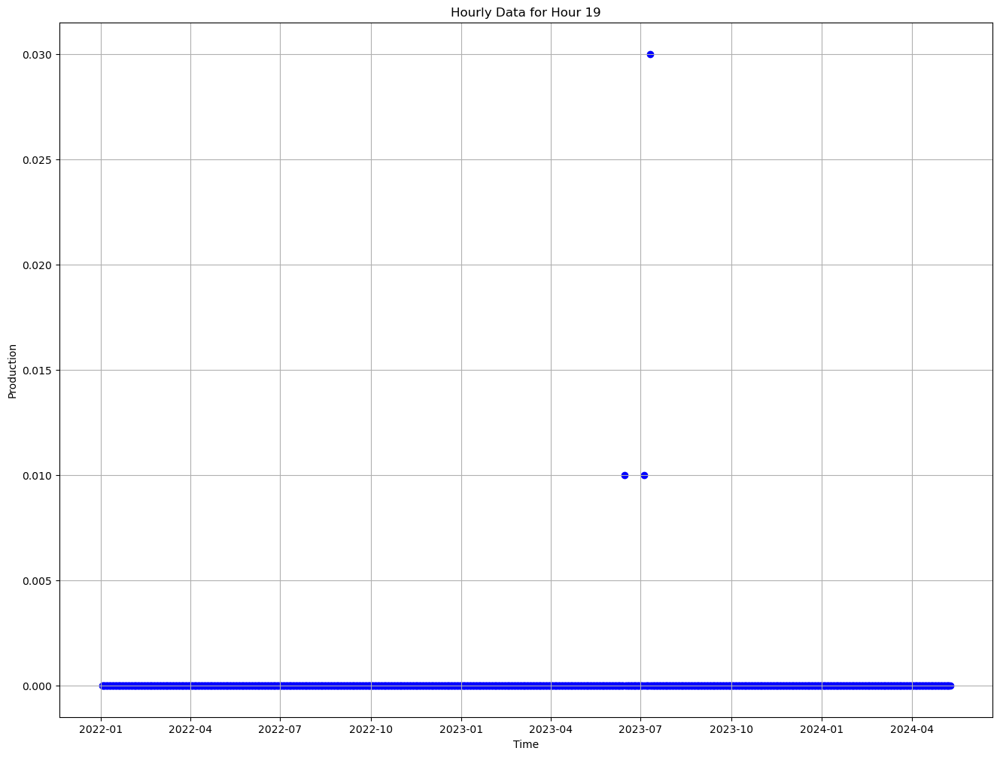

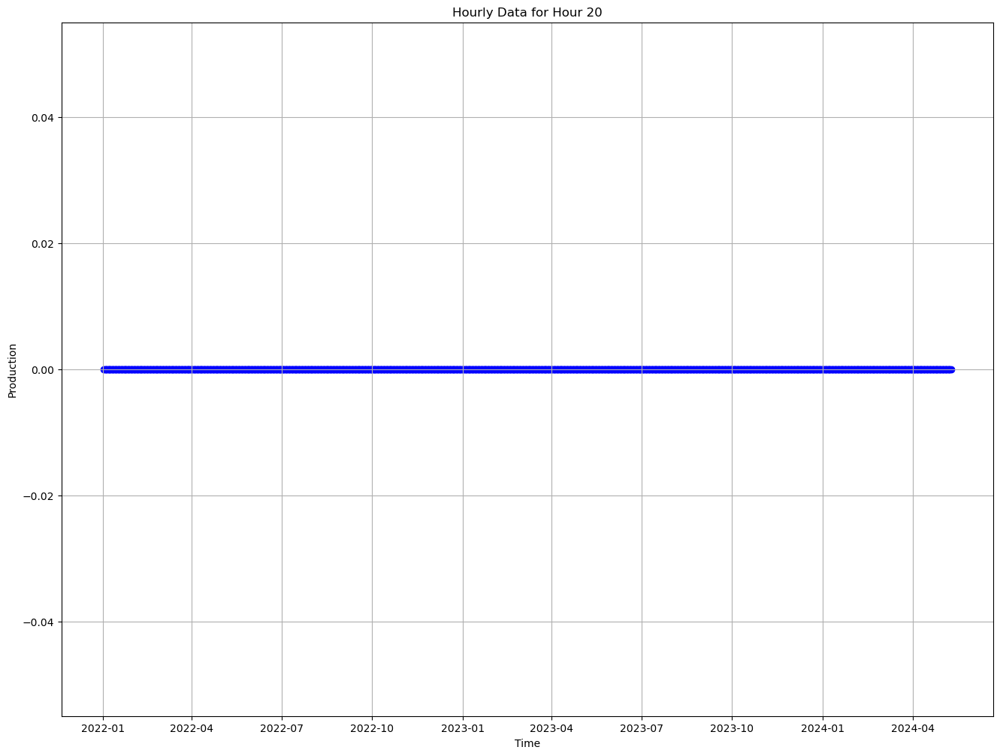

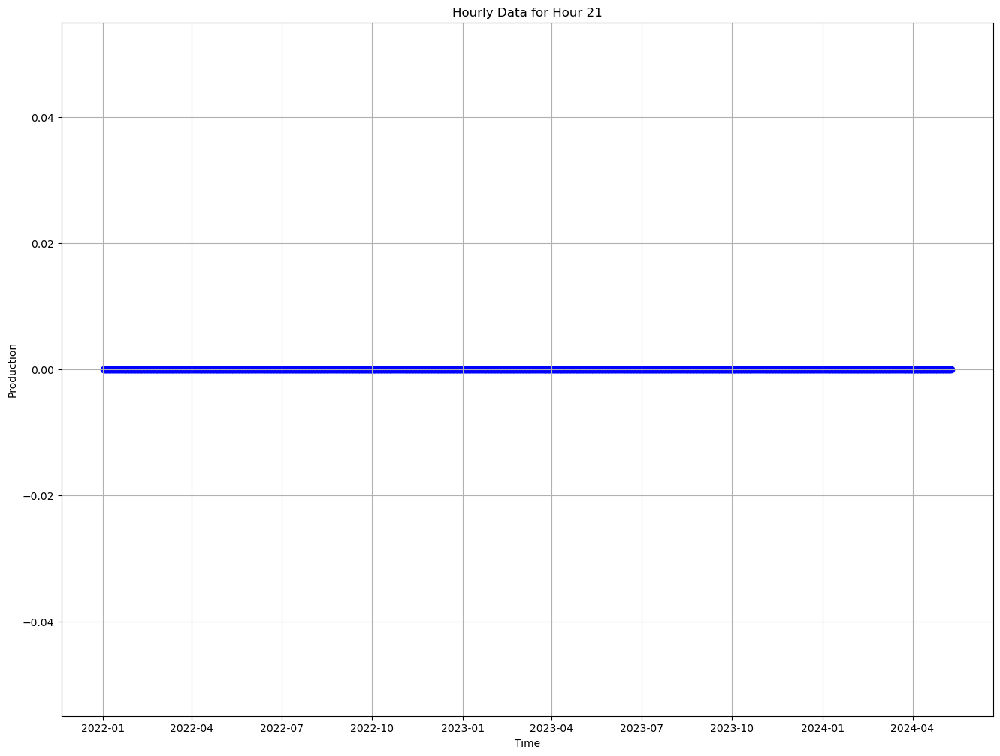

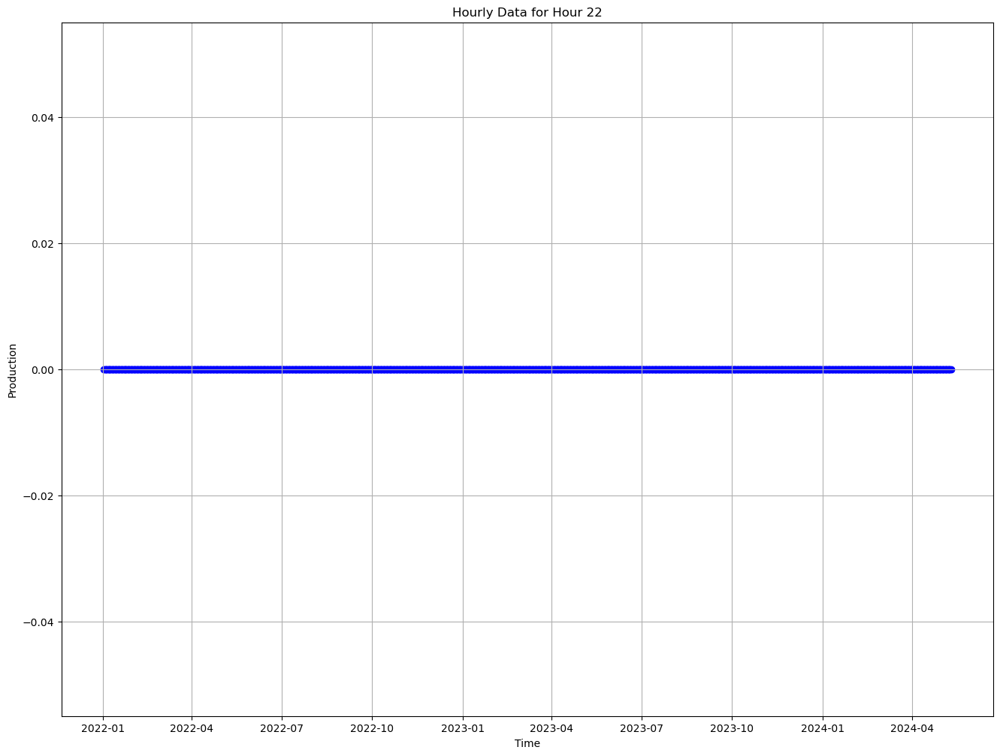

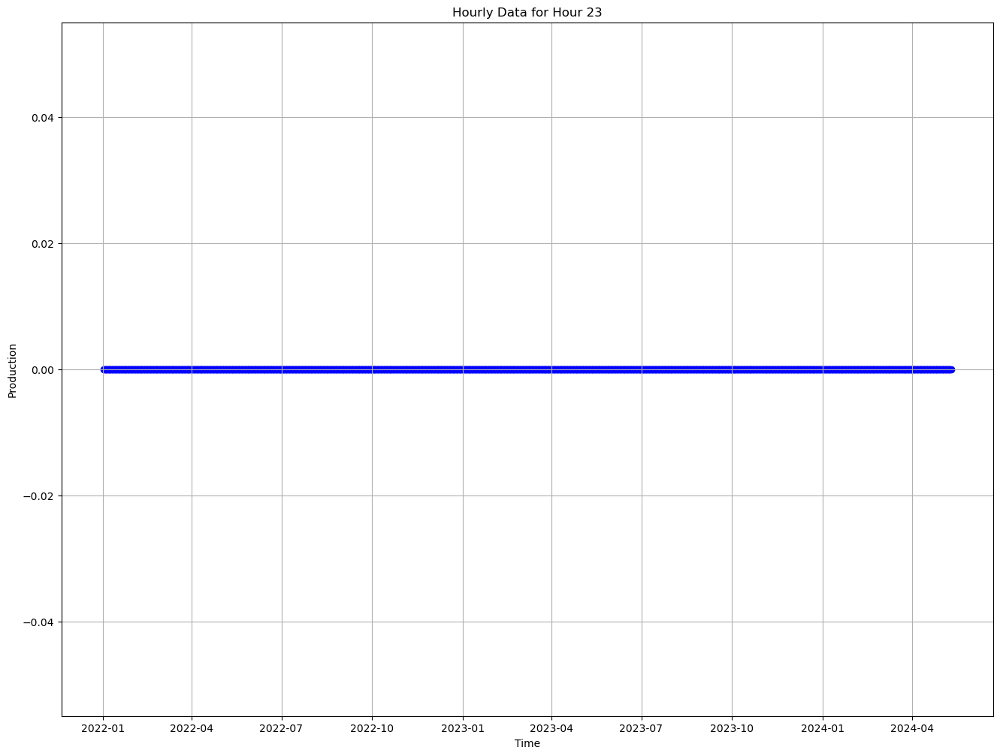

In [19]:
hourly_data = merged_data.groupby(merged_data['date_hour'].dt.hour)
hourly_datasets = {}
for hour, group in hourly_data:
    hourly_datasets[hour] = group

for hour in range(24):
    plt.figure(figsize=(16, 12))
    plt.scatter(hourly_datasets[hour]['date_hour'], hourly_datasets[hour]['production'], marker='o', color='blue')
    plt.xlabel('Time')
    plt.ylabel('Production')
    plt.title(f'Hourly Data for Hour {hour}')
    plt.grid(True)
    plt.show()

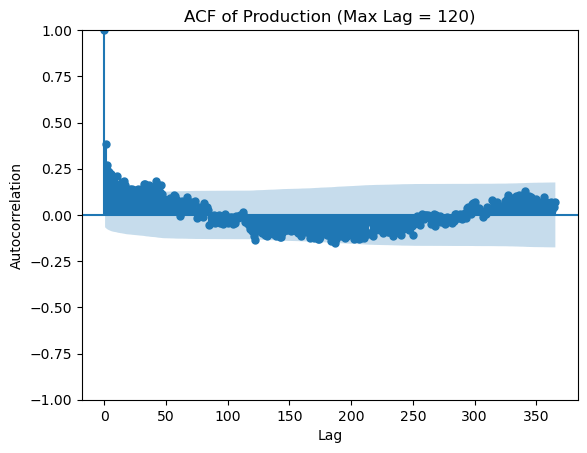

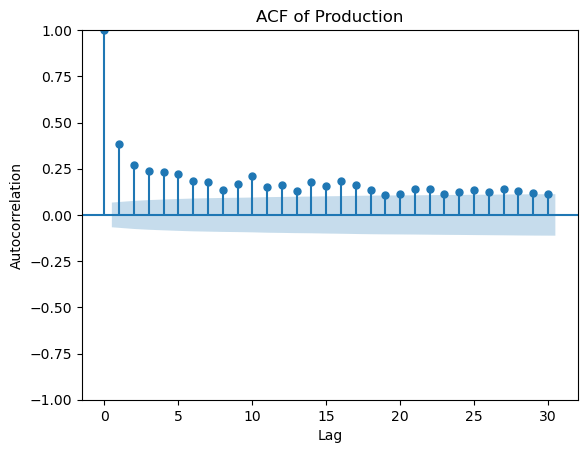

In [20]:
plot_acf(hourly_datasets[12]['production'], lags=365)
plt.title('ACF of Production (Max Lag = 120)')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

plot_acf(hourly_datasets[12]['production'])
plt.title('ACF of Production')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.show()

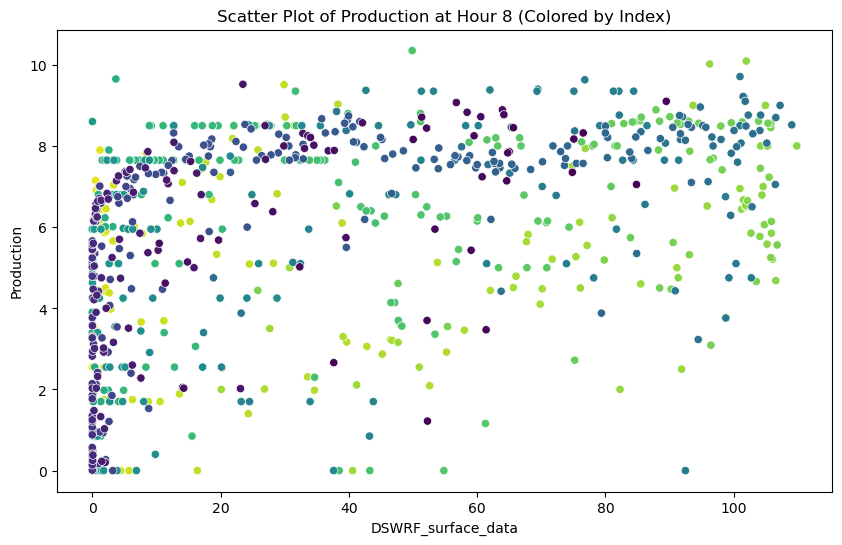

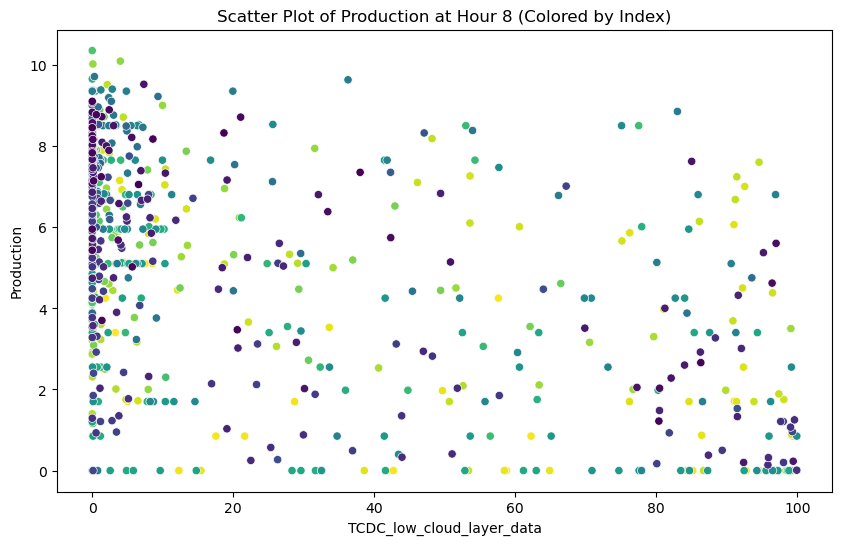

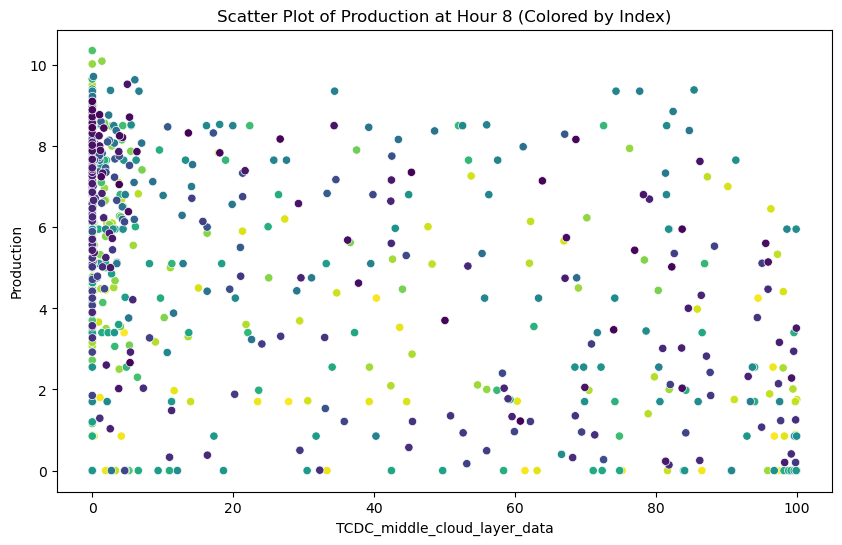

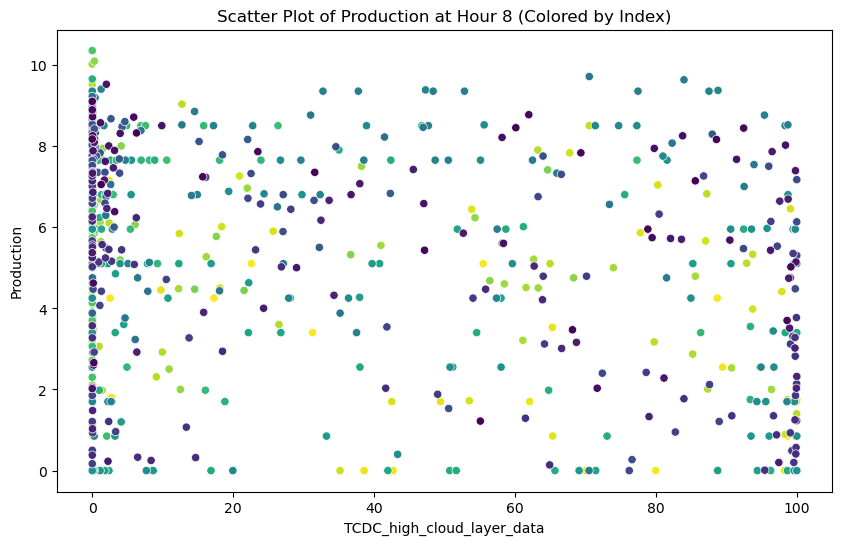

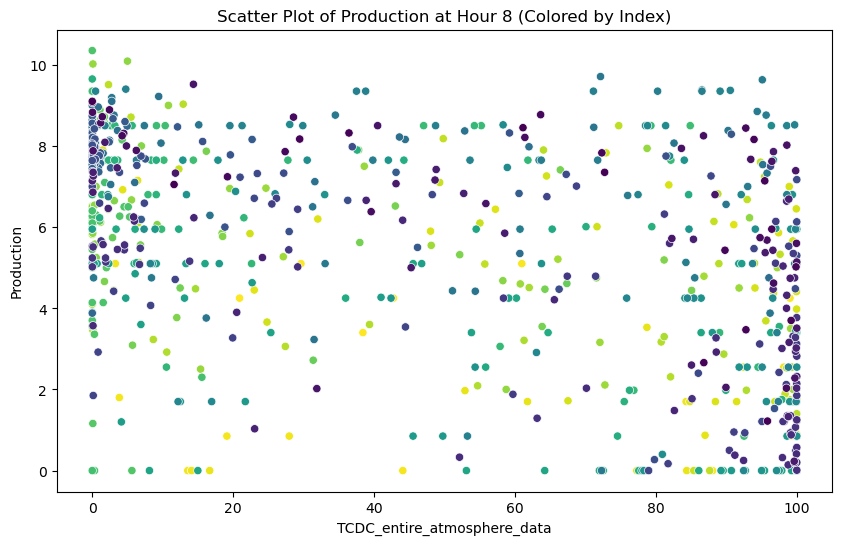

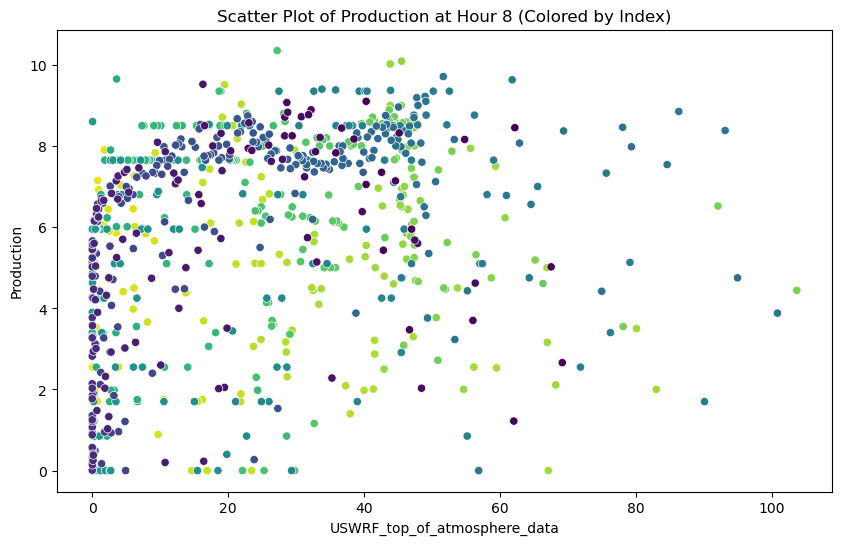

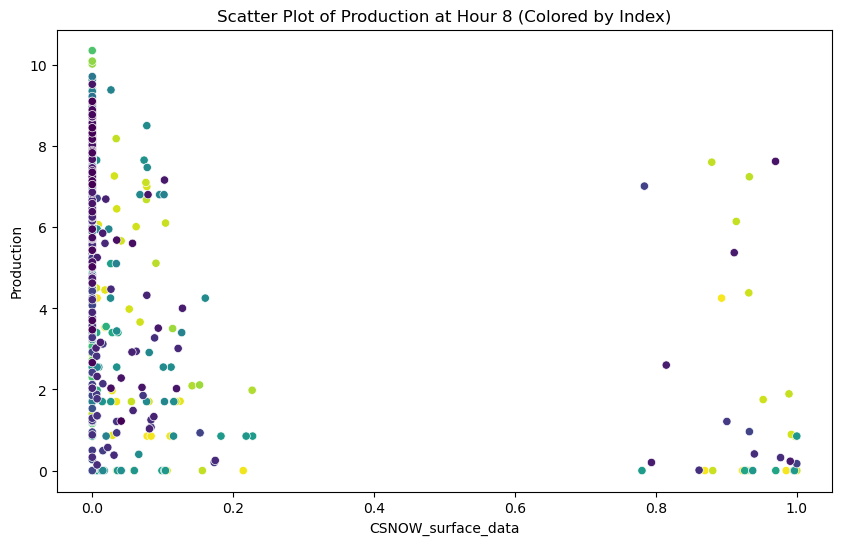

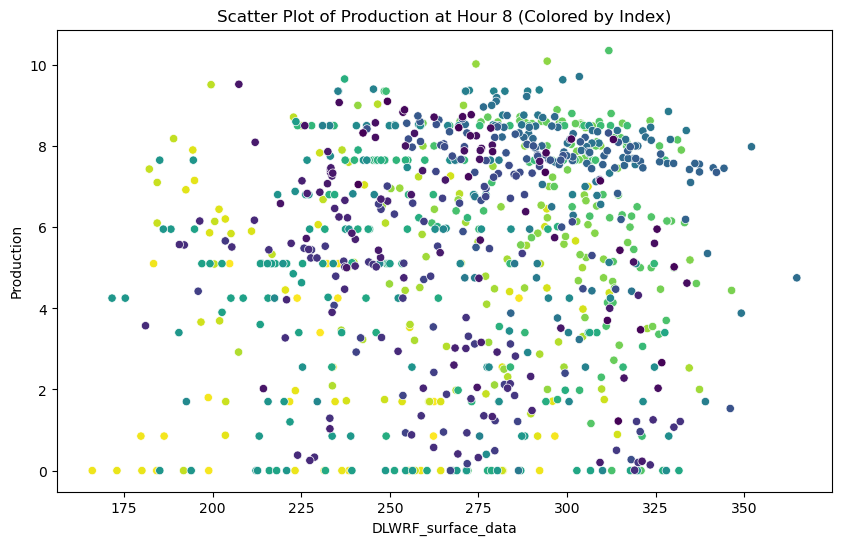

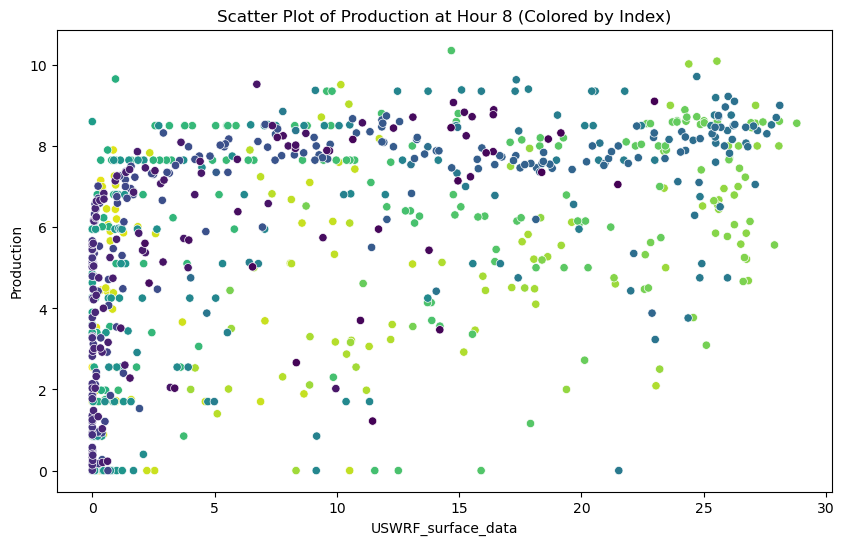

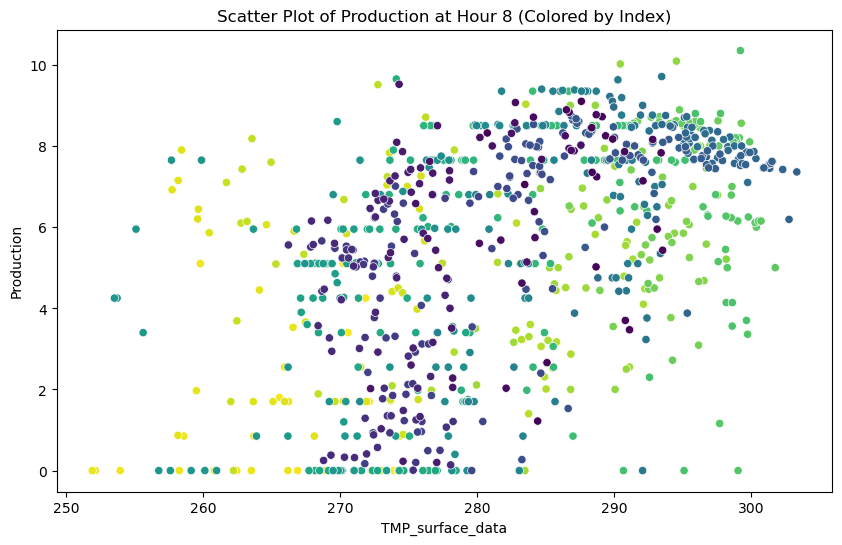

In [21]:
for colname in colnames:
    plt.figure(figsize=(10, 6))
    colormap = plt.cm.viridis_r
    norm = plt.Normalize(vmin=0, vmax=len(hourly_datasets[8]))
    colors = [colormap(norm(i)) for i in range(len(hourly_datasets[8]))]
    sns.scatterplot(x=colname, y='production', data=hourly_datasets[8], hue=range(len(hourly_datasets[8])), palette=colors, legend=False)
    plt.title('Scatter Plot of Production at Hour 8 (Colored by Index)')
    plt.xlabel(colname)
    plt.ylabel('Production')
    plt.show()

In [22]:
regression_3_data = hourly_datasets[12]
regression_3_endo = regression_3_data['production']
regression_3_data = regression_3_data.drop(['hour', 'date_hour', 'production', 'TCDC_low_cloud_layer_data', 'TCDC_middle_cloud_layer_data',
              'TCDC_high_cloud_layer_data', 'TCDC_entire_atmosphere_data', 'USWRF_top_of_atmosphere_data',
              'CSNOW_surface_data', 'DLWRF_surface_data', 'USWRF_surface_data', 'TMP_surface_data'], axis=1)


exogenous_data_with_const = sm.add_constant(regression_3_data)
model_3 = sm.OLS(regression_3_endo, exogenous_data_with_const)
result_3 = model_3.fit()
print(result_3.summary())

                            OLS Regression Results                            
Dep. Variable:             production   R-squared:                       0.284
Model:                            OLS   Adj. R-squared:                  0.283
Method:                 Least Squares   F-statistic:                     339.8
Date:                Wed, 05 Jun 2024   Prob (F-statistic):           3.52e-64
Time:                        11:26:28   Log-Likelihood:                -1993.9
No. Observations:                 860   AIC:                             3992.
Df Residuals:                     858   BIC:                             4001.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  3.8805      0

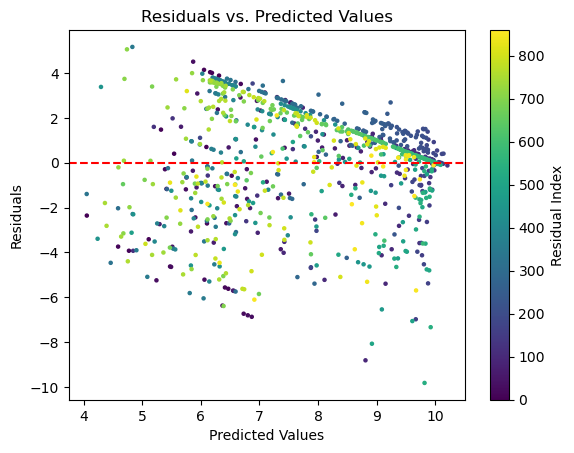

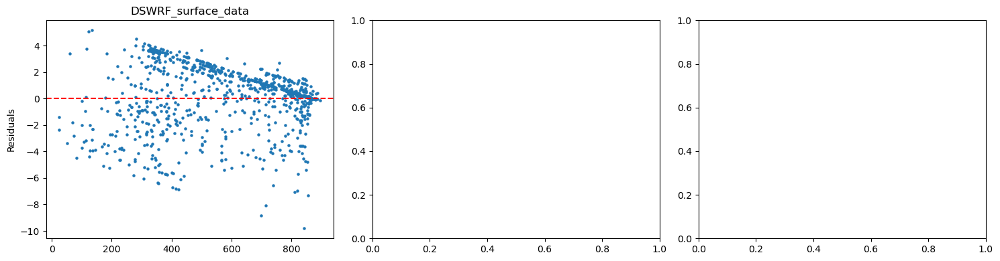

In [23]:
residuals_3 = result_3.resid
predicted_values_3 = result_3.predict()

colors = range(len(residuals_3))
plt.scatter(predicted_values_3, residuals_3, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

num_columns = regression_3_data.shape[1]
num_rows = (num_columns + 2) // 3

fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 4*num_rows))
axes = axes.flatten()

for i, column in enumerate(regression_3_data.columns):
    if i < num_columns:
        axes[i].scatter(regression_3_data[column], residuals_3[:len(regression_3_data)], s=5)
        axes[i].axhline(y=0, color='red', linestyle='--')
        axes[i].set_title('{}'.format(column))
        axes[i].set_ylabel('Residuals')

plt.tight_layout()
plt.show()

/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


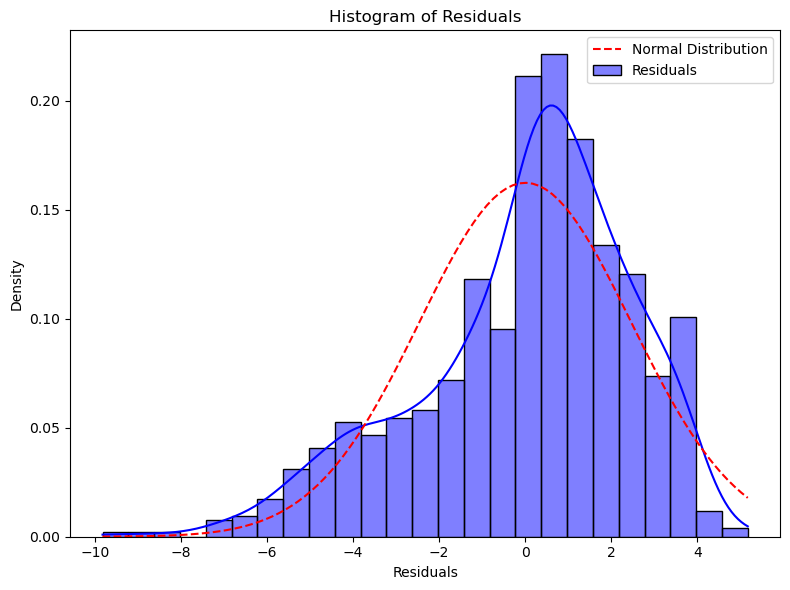

<Figure size 800x600 with 0 Axes>

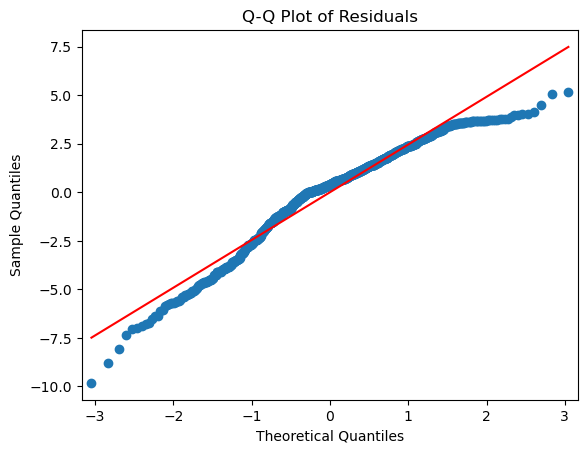

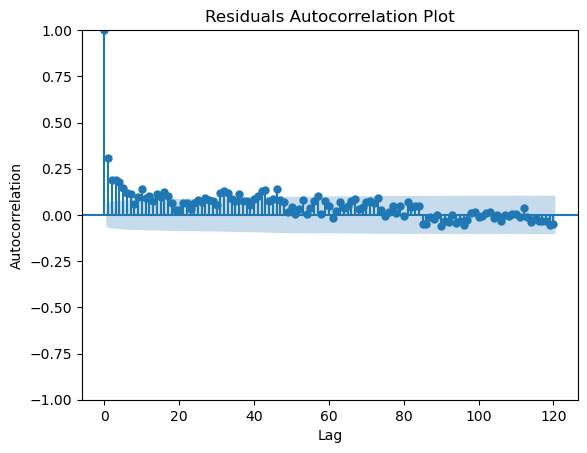

In [24]:
from scipy.stats import norm

mean_residuals = np.mean(residuals_3)
std_residuals = np.std(residuals_3)

plt.figure(figsize=(8, 6))
sns.histplot(residuals_3, kde=True, stat='density', color='blue', label='Residuals')

sns.lineplot(x=np.linspace(min(residuals_3), max(residuals_3), 100),
             y=norm.pdf(np.linspace(min(residuals_3), max(residuals_3), 100), mean_residuals, std_residuals),
             color='red', linestyle='--', label='Normal Distribution')

plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(8, 6))
sm.qqplot(residuals_3, line='s')
plt.title('Q-Q Plot of Residuals')
plt.show()

sm.graphics.tsa.plot_acf(residuals_3, lags=120)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Residuals Autocorrelation Plot')
plt.show()

In [25]:
regression_4_data = hourly_datasets[12]
regression_4_endo = regression_4_data['production']
regression_4_data = regression_4_data.drop(['hour', 'date_hour', 'production', 'TCDC_high_cloud_layer_data'], axis=1)
#Since TCDC_high_cloud_layer_data rejected in earlier run

exogenous_data_with_const = sm.add_constant(regression_4_data)
model_4 = sm.OLS(regression_4_endo, exogenous_data_with_const)
result_4 = model_4.fit()
print(result_4.summary())

                            OLS Regression Results                            
Dep. Variable:             production   R-squared:                       0.482
Model:                            OLS   Adj. R-squared:                  0.477
Method:                 Least Squares   F-statistic:                     87.92
Date:                Wed, 05 Jun 2024   Prob (F-statistic):          3.83e-115
Time:                        11:26:31   Log-Likelihood:                -1854.4
No. Observations:                 860   AIC:                             3729.
Df Residuals:                     850   BIC:                             3776.
Df Model:                           9                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

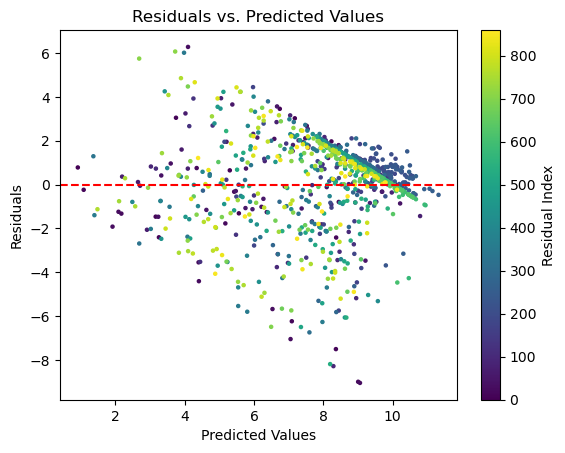

/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


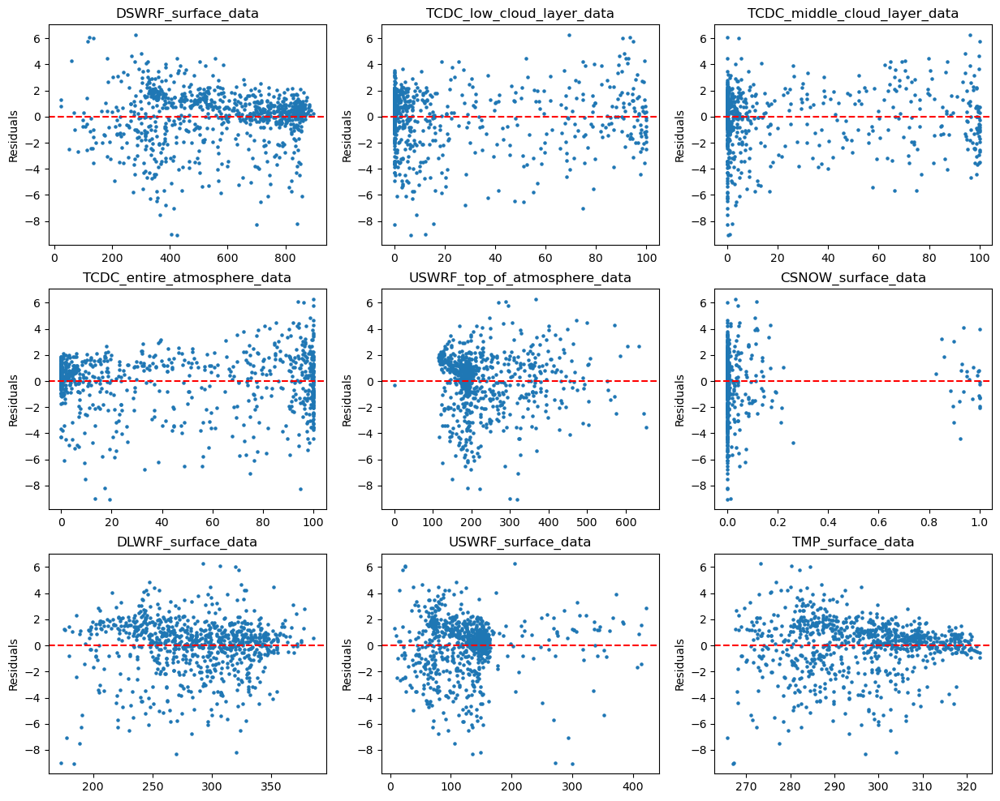

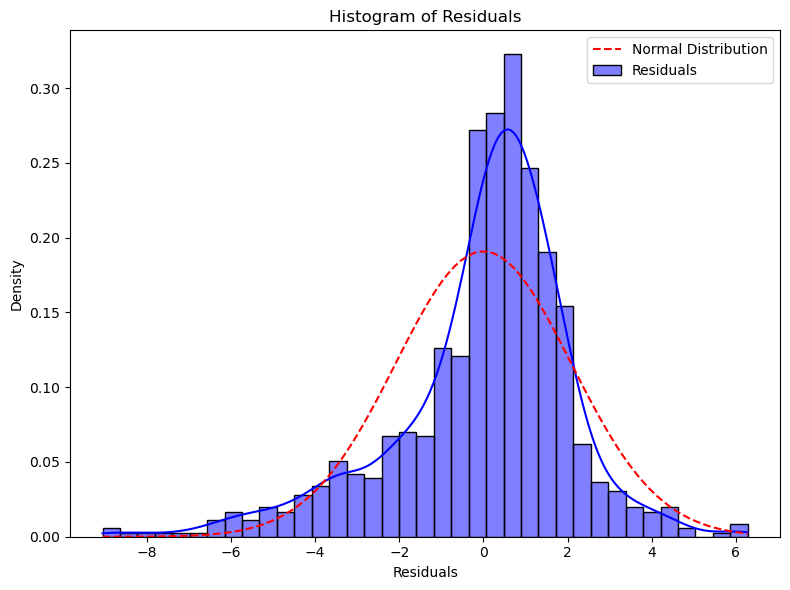

<Figure size 800x600 with 0 Axes>

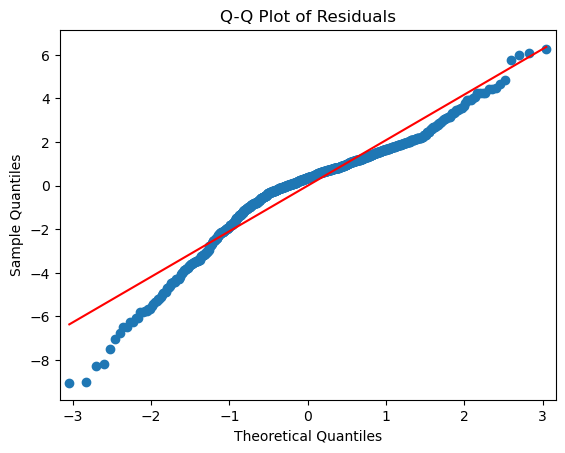

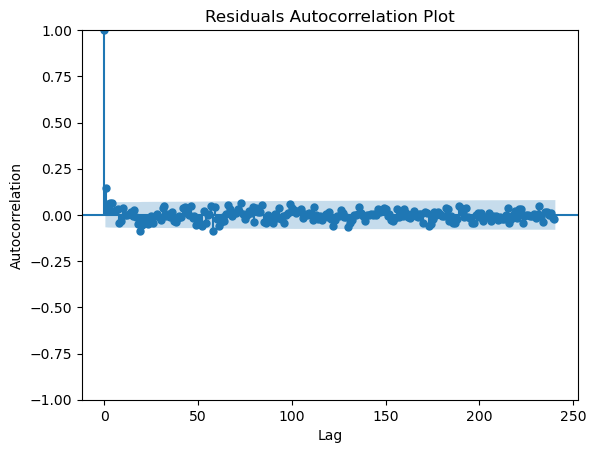

In [26]:
residuals_4 = result_4.resid
predicted_values_4 = result_4.predict()

colors = range(len(residuals_4))
plt.scatter(predicted_values_4, residuals_4, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

num_columns = regression_4_data.shape[1]
num_rows = (num_columns + 2) // 3

fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 4*num_rows))
axes = axes.flatten()

for i, column in enumerate(regression_4_data.columns):
    if i < num_columns:
        axes[i].scatter(regression_4_data[column], residuals_4[:len(regression_4_data)], s=5)
        axes[i].axhline(y=0, color='red', linestyle='--')
        axes[i].set_title('{}'.format(column))
        axes[i].set_ylabel('Residuals')

mean_residuals = np.mean(residuals_4)
std_residuals = np.std(residuals_4)

plt.figure(figsize=(8, 6))
sns.histplot(residuals_4, kde=True, stat='density', color='blue', label='Residuals')

sns.lineplot(x=np.linspace(min(residuals_4), max(residuals_4), 100),
             y=norm.pdf(np.linspace(min(residuals_4), max(residuals_4), 100), mean_residuals, std_residuals),
             color='red', linestyle='--', label='Normal Distribution')

plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 6))
sm.qqplot(residuals_4, line='s')
plt.title('Q-Q Plot of Residuals')
plt.show()

sm.graphics.tsa.plot_acf(residuals_4, lags=240)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Residuals Autocorrelation Plot')
plt.show()

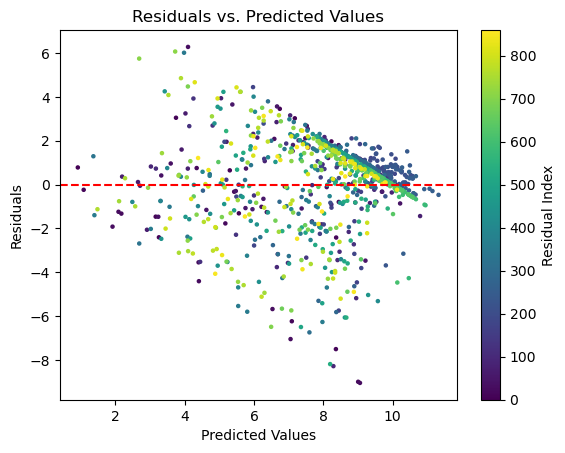

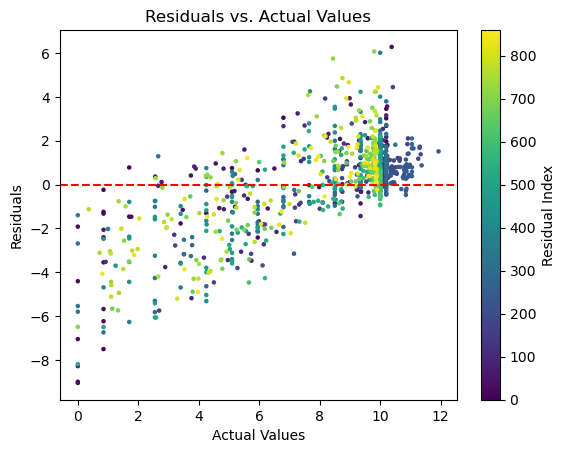

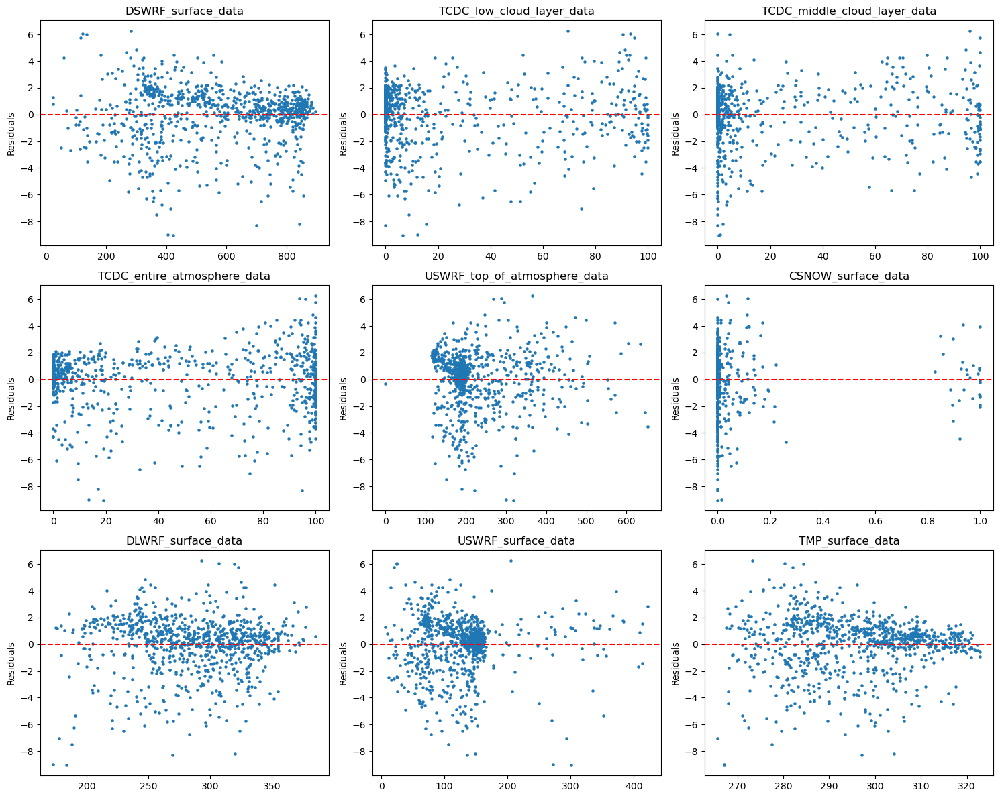

In [27]:
residuals_4 = result_4.resid
predicted_values_4 = result_4.predict()

colors = range(len(residuals_4))
plt.scatter(predicted_values_4, residuals_4, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

plt.scatter(regression_4_endo, residuals_4, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Actual Values')
plt.xlabel('Actual Values')
plt.ylabel('Residuals')
plt.show()

num_columns = regression_4_data.shape[1]
num_rows = (num_columns + 2) // 3

fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 4*num_rows))
axes = axes.flatten()

for i, column in enumerate(regression_4_data.columns):
    if i < num_columns:
        axes[i].scatter(regression_4_data[column], residuals_4[:len(regression_4_data)], s=5)
        axes[i].axhline(y=0, color='red', linestyle='--')
        axes[i].set_title('{}'.format(column))
        axes[i].set_ylabel('Residuals')

plt.tight_layout()
plt.show()

/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


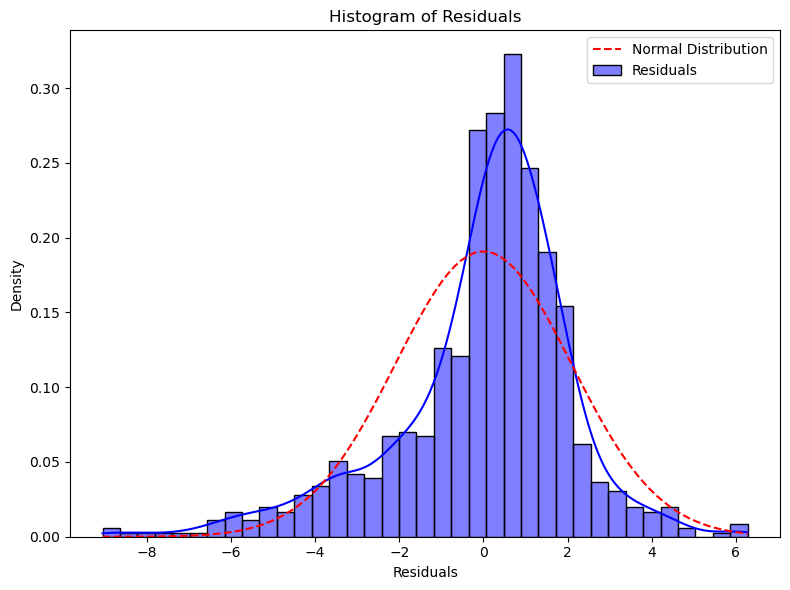

<Figure size 800x600 with 0 Axes>

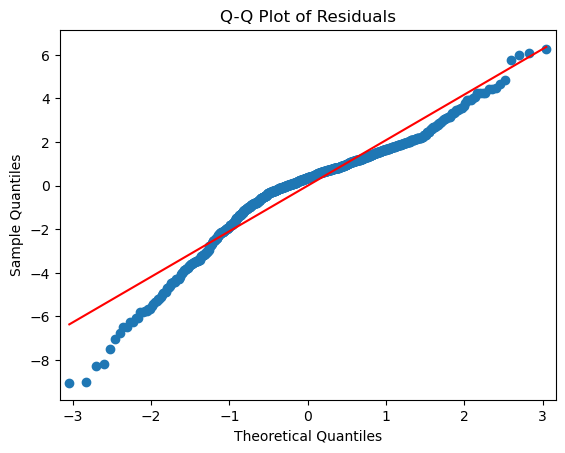

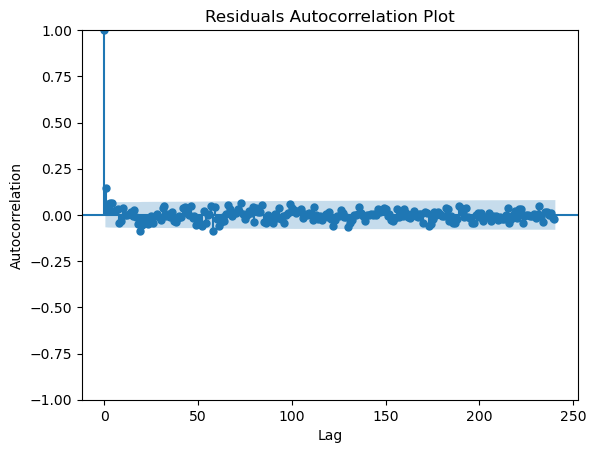

In [28]:
mean_residuals = np.mean(residuals_4)
std_residuals = np.std(residuals_4)

plt.figure(figsize=(8, 6))
sns.histplot(residuals_4, kde=True, stat='density', color='blue', label='Residuals')

sns.lineplot(x=np.linspace(min(residuals_4), max(residuals_4), 100),
             y=norm.pdf(np.linspace(min(residuals_4), max(residuals_4), 100), mean_residuals, std_residuals),
             color='red', linestyle='--', label='Normal Distribution')

plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 6))
sm.qqplot(residuals_4, line='s')
plt.title('Q-Q Plot of Residuals')
plt.show()

sm.graphics.tsa.plot_acf(residuals_4, lags=240)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Residuals Autocorrelation Plot')
plt.show()

In [29]:
regression_6_data = hourly_datasets[5]
#regression_6_data = regression_6_data[(regression_6_data['date_hour'] >= '2023-06-01') & (regression_6_data['date_hour'] <= '2023-08-01')]

regression_6_endo = regression_6_data['production']
regression_6_data = regression_6_data.drop(['hour', 'date_hour', 'production', 'DSWRF_surface_data', 'USWRF_surface_data','CSNOW_surface_data','USWRF_top_of_atmosphere_data', 'TCDC_entire_atmosphere_data', 'TCDC_middle_cloud_layer_data'], axis=1)

model_6 = sm.OLS(regression_6_endo, regression_6_data)
result_6 = model_6.fit()
print(result_6.summary())

                                 OLS Regression Results                                
Dep. Variable:             production   R-squared (uncentered):                   0.211
Model:                            OLS   Adj. R-squared (uncentered):              0.208
Method:                 Least Squares   F-statistic:                              57.39
Date:                Wed, 05 Jun 2024   Prob (F-statistic):                    6.32e-43
Time:                        11:26:38   Log-Likelihood:                          249.46
No. Observations:                 860   AIC:                                     -490.9
Df Residuals:                     856   BIC:                                     -471.9
Df Model:                           4                                                  
Covariance Type:            nonrobust                                                  
                                 coef    std err          t      P>|t|      [0.025      0.975]
-------------------------

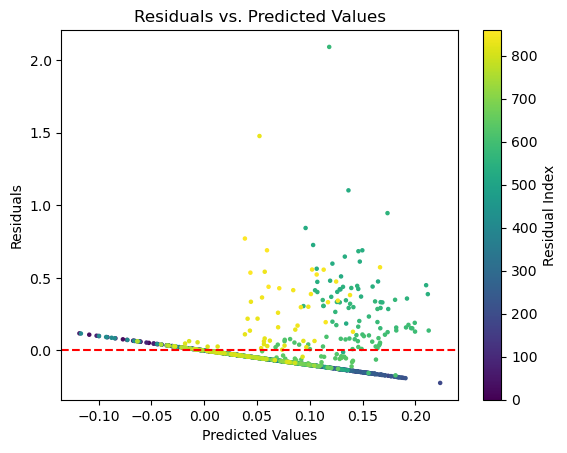

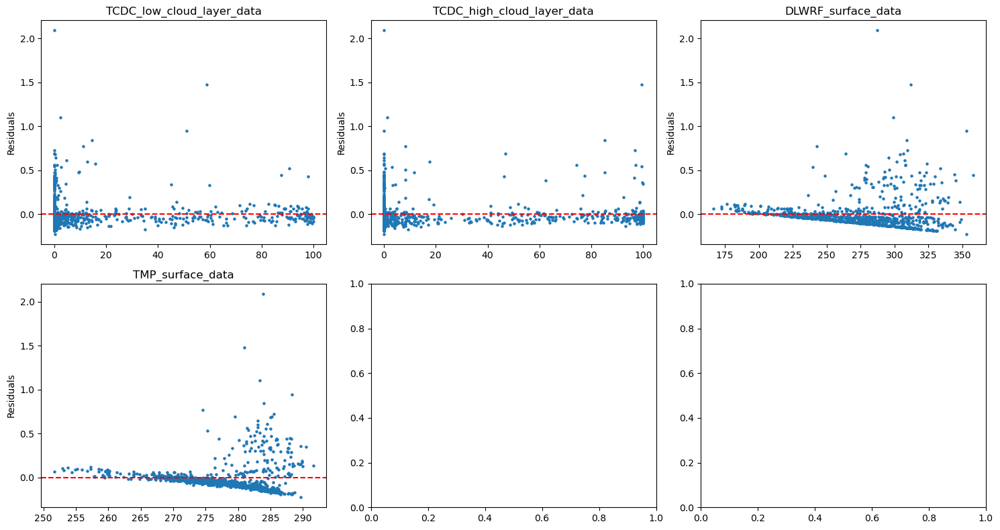

In [30]:
residuals_6 = result_6.resid
predicted_values_6 = result_6.predict()

colors = range(len(residuals_6))
plt.scatter(predicted_values_6, residuals_6, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

num_columns = regression_6_data.shape[1]
num_rows = (num_columns + 2) // 3

fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 4*num_rows))
axes = axes.flatten()

for i, column in enumerate(regression_6_data.columns):
    if i < num_columns:
        axes[i].scatter(regression_6_data[column], residuals_6[:len(regression_6_data)], s=5)
        axes[i].axhline(y=0, color='red', linestyle='--')
        axes[i].set_title('{}'.format(column))
        axes[i].set_ylabel('Residuals')

plt.tight_layout()
plt.show()

/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


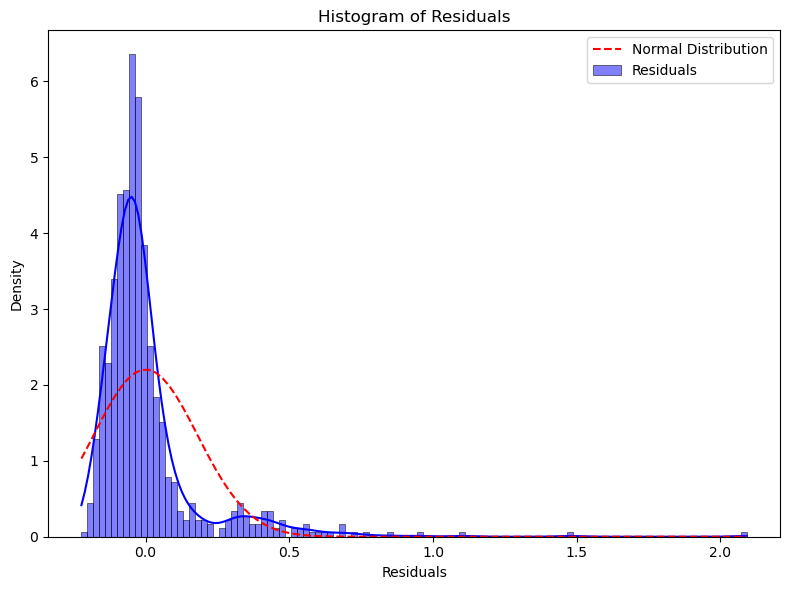

<Figure size 800x600 with 0 Axes>

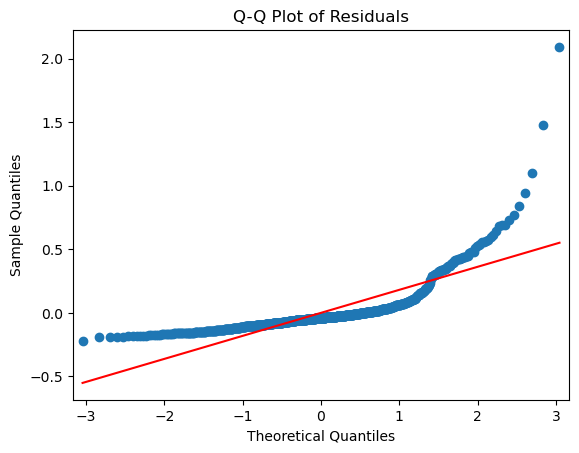

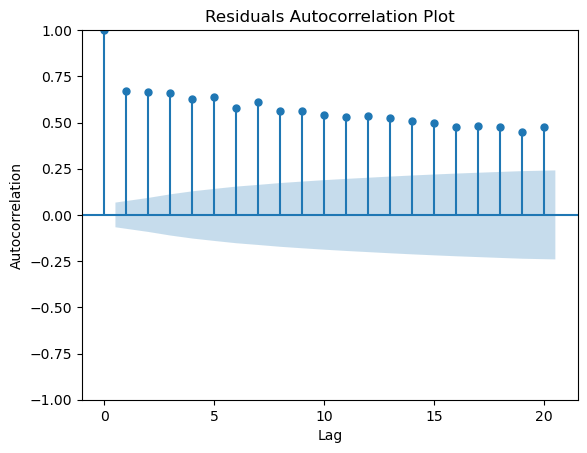

In [31]:
from scipy.stats import norm
mean_residuals = np.mean(residuals_6)
std_residuals = np.std(residuals_6)

plt.figure(figsize=(8, 6))
sns.histplot(residuals_6, kde=True, stat='density', color='blue', label='Residuals')

sns.lineplot(x=np.linspace(min(residuals_6), max(residuals_6), 100),
             y=norm.pdf(np.linspace(min(residuals_6), max(residuals_6), 100), mean_residuals, std_residuals),
             color='red', linestyle='--', label='Normal Distribution')

plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 6))
sm.qqplot(residuals_6, line='s')
plt.title('Q-Q Plot of Residuals')
plt.show()

sm.graphics.tsa.plot_acf(residuals_6, lags=20)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Residuals Autocorrelation Plot')
plt.show()

In [32]:
def best_ma_length(data):
    window_lengths = range(1, 8)
    best_window = 0
    best_mse = np.mean((np.array(data) - np.zeros(len(data))) ** 2)
    print(best_mse)

    for window in window_lengths:
        if window == 1:
            forecast = data.shift(1)
        else:
            forecast = data.rolling(window=window, min_periods=1).mean()

        mse = np.mean((data - forecast) ** 2)
        print(mse)
        if mse < best_mse:
            best_mse = mse
            best_window = window

    return best_window

In [33]:
final_model_sma_hour_4_data = hourly_datasets[4]
final_model_sma_hour_4_endo = final_model_sma_hour_4_data['production']

print(best_ma_length(final_model_sma_hour_4_endo))

0.00043720930232558143
0.0001579743888242142
3.944767441860465e-05
5.1847545219638256e-05
6.179505813953488e-05
6.22046511627907e-05
7.155361757105943e-05
7.969862363550071e-05
2


In [34]:
final_model_sma_hour_5_data = hourly_datasets[5] # 19 Mart
#lower_bound_for_hour_5 = '2024-03-19'
#final_model_sma_hour_5_data = final_model_sma_hour_5_data[final_model_sma_hour_5_data['date_hour'].dt.date >= pd.to_datetime(lower_bound_for_hour_5).date()]
final_model_sma_hour_5_endo = final_model_sma_hour_5_data['production']

print(best_ma_length(final_model_sma_hour_5_endo))

0.04156709302325581
0.01990512223515716
0.00497049418604651
0.00663188630490956
0.007467071220930232
0.008122404651162788
0.008382722868217054
0.009090673943996205
2


In [35]:
final_model_sma_hour_18_data = hourly_datasets[18] # 4 Nisan
#lower_bound_for_hour_18 = '2024-04-04'
#final_model_sma_hour_18_data = final_model_sma_hour_18_data[final_model_sma_hour_18_data['date_hour'].dt.date >= pd.to_datetime(lower_bound_for_hour_18).date()]
final_model_sma_hour_18_endo = final_model_sma_hour_18_data['production']

print(best_ma_length(final_model_sma_hour_18_endo))

0.09057755813953487
0.1271627473806752
0.03175372093023255
0.040894043927648574
0.04571736918604651
0.04949336744186046
0.05098500645994832
0.05491467014712861
2


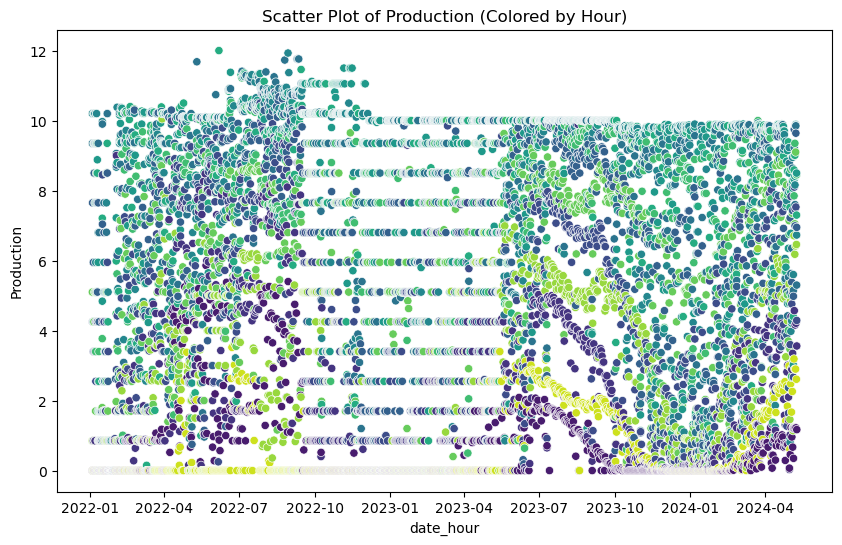

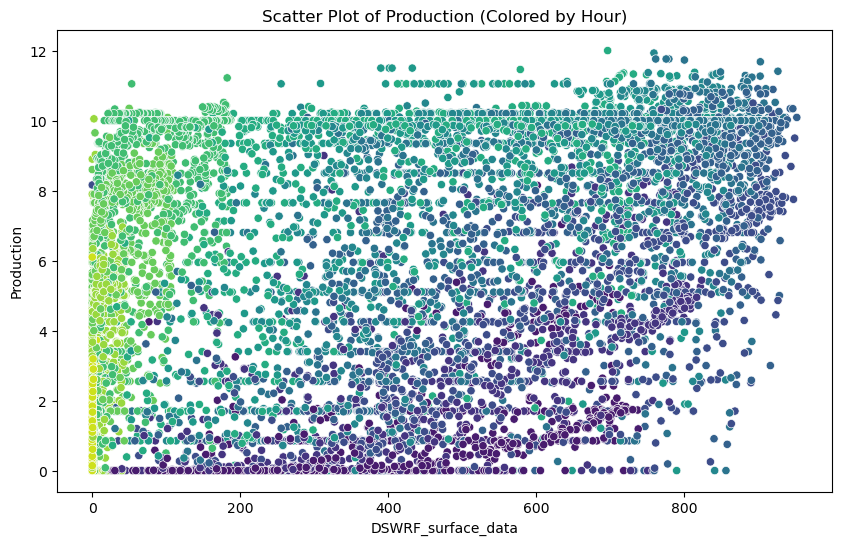

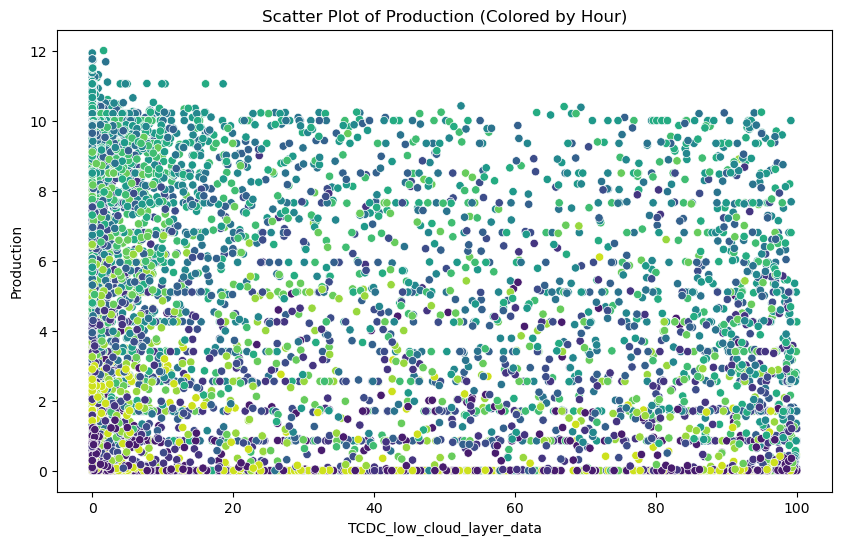

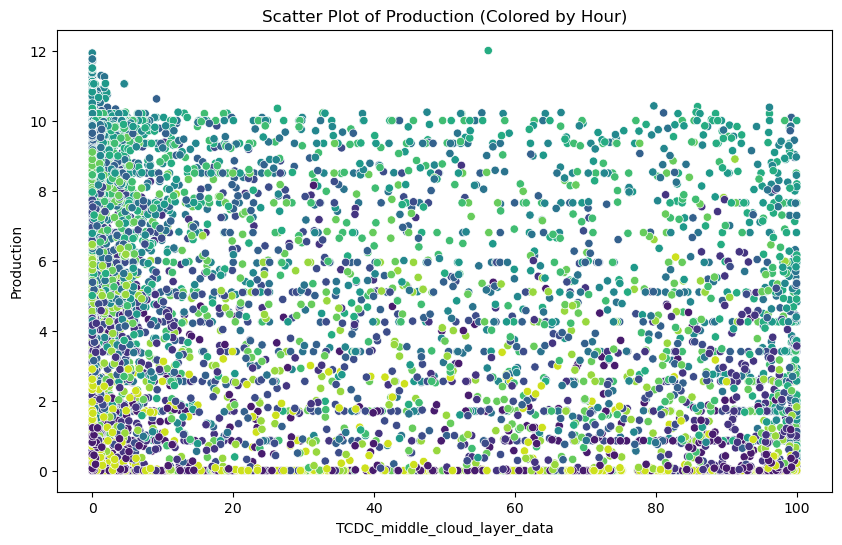

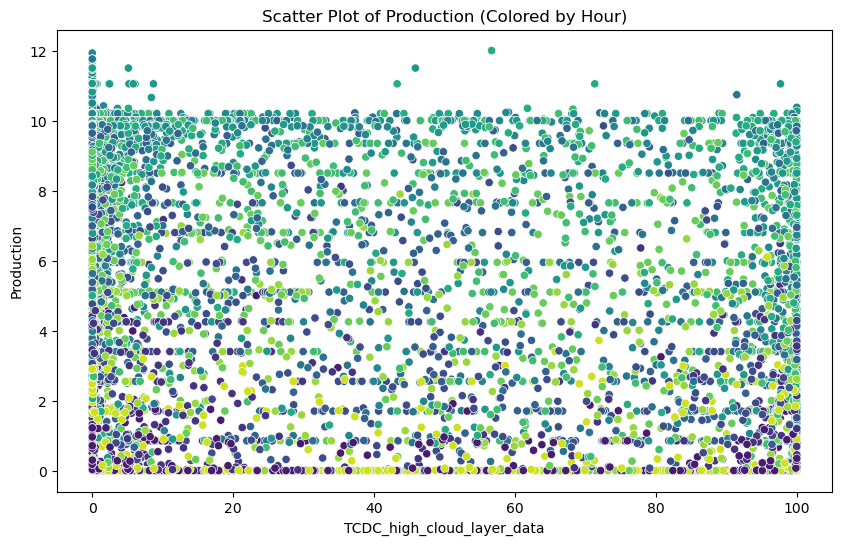

...

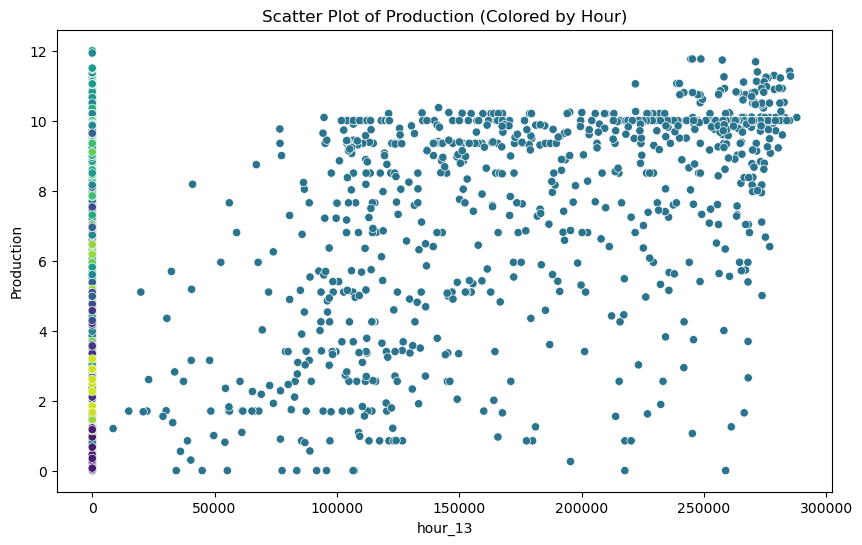

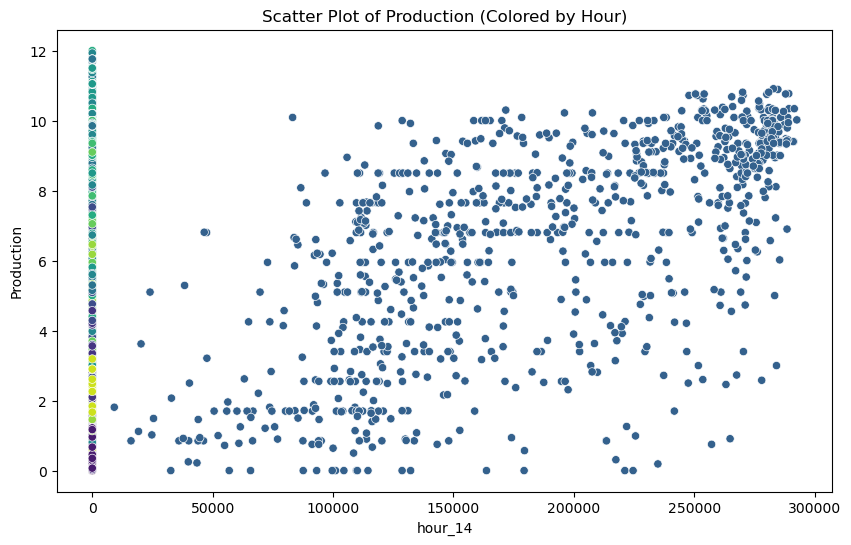

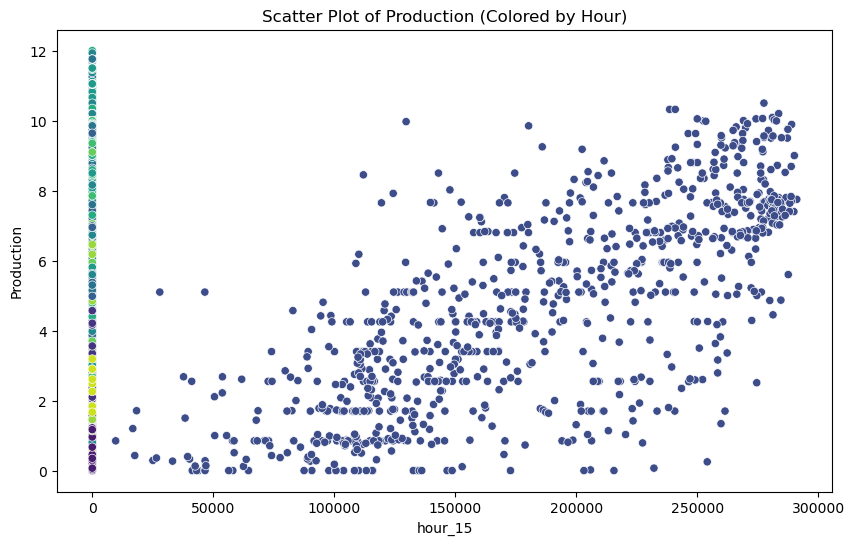

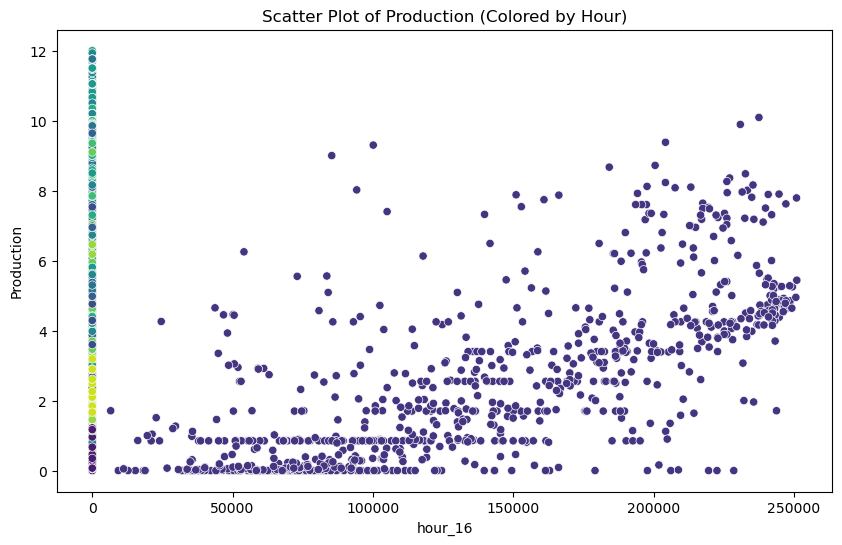

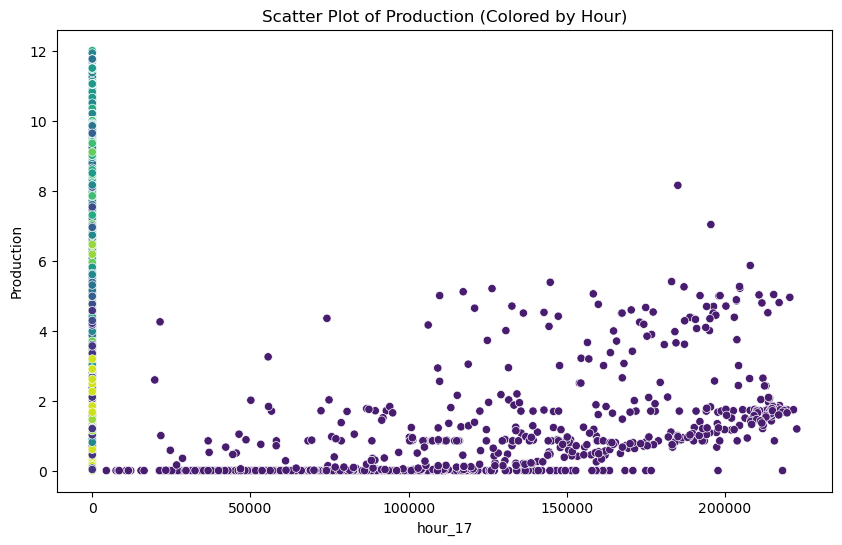

In [36]:
cluster_3_data = merged_data
cluster_3_data['production_lag2'] = cluster_3_data['production'].shift(48)
#cluster_3_data = cluster_3_data[((cluster_3_data['date_hour'].dt.hour >= 6) & (cluster_3_data['date_hour'].dt.hour <= 8)) | ((cluster_3_data['date_hour'].dt.hour >= 15) & (cluster_3_data['date_hour'].dt.hour <= 17))]
cluster_3_data = cluster_3_data[((cluster_3_data['date_hour'].dt.hour >= 6) & (cluster_3_data['date_hour'].dt.hour <= 17))]
cluster_3_data = cluster_3_data[cluster_3_data['date_hour'] >= '2022-01-03 06:00:00']

cluster_3_regression_1_endo = cluster_3_data['production']
cluster_3_regression_1_exo = cluster_3_data.drop(['production'], axis=1)

cluster_3_regression_1_exo['hour'] = cluster_3_regression_1_exo['date_hour'].dt.hour
dummy_hours = pd.get_dummies(cluster_3_regression_1_exo['hour'], prefix='hour')
dummy_hours = dummy_hours.astype(int)
cluster_3_regression_1_exo_with_dummies = pd.concat([cluster_3_regression_1_exo, dummy_hours], axis=1)

for colnamess in ['hour_6', 'hour_7', 'hour_8', 'hour_9', 'hour_10', 'hour_11', 'hour_12', 'hour_13', 'hour_14', 'hour_15', 'hour_16', 'hour_17']:
    cluster_3_regression_1_exo_with_dummies[colnamess] = cluster_3_regression_1_exo_with_dummies['DSWRF_surface_data'] * cluster_3_regression_1_exo_with_dummies[colnamess]
    cluster_3_regression_1_exo_with_dummies[colnamess] = cluster_3_regression_1_exo_with_dummies['TMP_surface_data'] * cluster_3_regression_1_exo_with_dummies[colnamess]

num_unique_hours = len(cluster_3_regression_1_exo_with_dummies['hour'].unique())
custom_palette = sns.color_palette("viridis_r", num_unique_hours)

for colname in cluster_3_regression_1_exo_with_dummies.columns:
    plt.figure(figsize=(10, 6))
    sns.scatterplot(
        x=cluster_3_regression_1_exo_with_dummies[colname],
        y=cluster_3_regression_1_endo,
        hue=cluster_3_regression_1_exo_with_dummies['hour'],
        palette=custom_palette,
        legend=False)
    plt.title('Scatter Plot of Production (Colored by Hour)')
    plt.xlabel(colname)
    plt.ylabel('Production')
    plt.show()

cluster_3_regression_1_exo_with_dummies.drop(['date_hour', 'hour', 'USWRF_surface_data'], axis=1, inplace=True)
cluster_3_regression_1_exo_with_dummies = sm.add_constant(cluster_3_regression_1_exo_with_dummies)

In [37]:
model_c3_1 = sm.OLS(cluster_3_regression_1_endo, cluster_3_regression_1_exo_with_dummies)
result_c3_1 = model_c3_1.fit()

print(result_c3_1.summary())

                            OLS Regression Results                            
Dep. Variable:             production   R-squared:                       0.680
Model:                            OLS   Adj. R-squared:                  0.679
Method:                 Least Squares   F-statistic:                     992.1
Date:                Wed, 05 Jun 2024   Prob (F-statistic):               0.00
Time:                        11:26:59   Log-Likelihood:                -22382.
No. Observations:               10296   AIC:                         4.481e+04
Df Residuals:                   10273   BIC:                         4.498e+04
Df Model:                          22                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

       n      mean        sd        CV         FBias  MAPE      RMSE  \
0  10296  5.148842  3.760644  0.730386  2.824882e-15   inf  2.127481   

             ME       MAD      MADP     WMAPE  
0  1.454487e-14  1.627822  0.316153  0.316153  


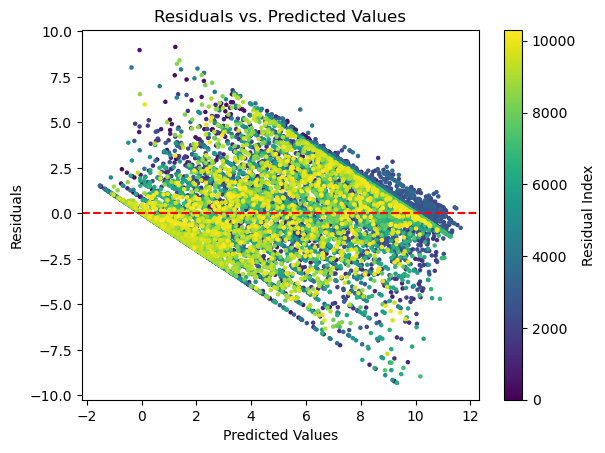

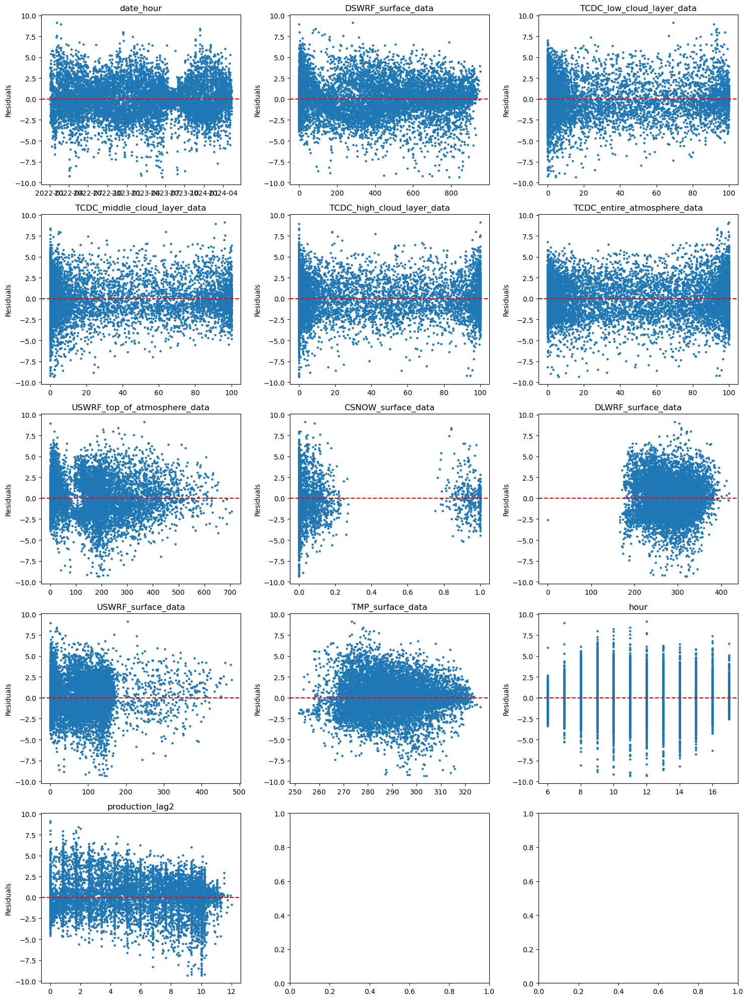

In [38]:
residuals_c3_1 = result_c3_1.resid
predicted_values_c3_1 = result_c3_1.predict()

print(model_comparison(cluster_3_regression_1_endo , predicted_values_c3_1))

colors = range(len(residuals_c3_1))
plt.scatter(predicted_values_c3_1, residuals_c3_1, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

num_columns = cluster_3_regression_1_exo.shape[1]
num_rows = (num_columns + 2) // 3

fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 4*num_rows))
axes = axes.flatten()

for i, column in enumerate(cluster_3_regression_1_exo.columns):
    if i < num_columns:
        axes[i].scatter(cluster_3_regression_1_exo[column], residuals_c3_1[:len(cluster_3_regression_1_exo)], s=5)
        axes[i].axhline(y=0, color='red', linestyle='--')
        axes[i].set_title('{}'.format(column))
        axes[i].set_ylabel('Residuals')

plt.tight_layout()
plt.show()

/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


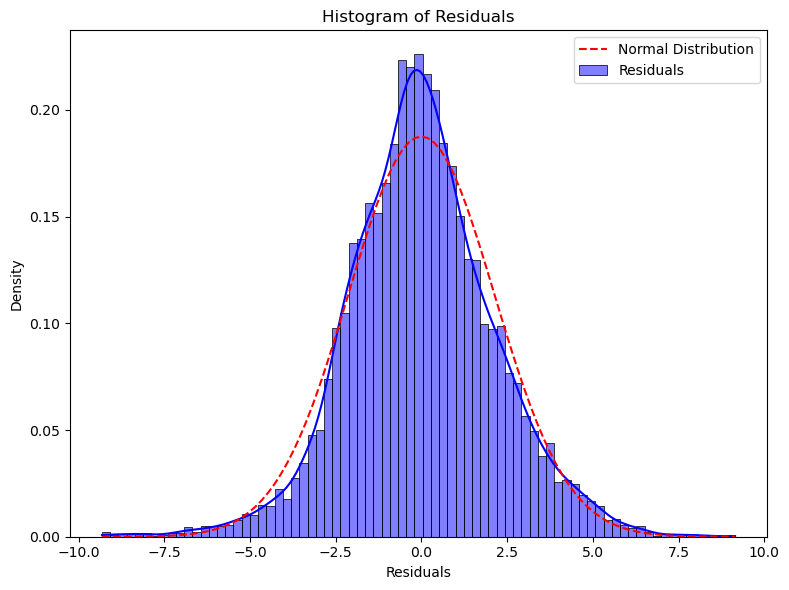

<Figure size 800x600 with 0 Axes>

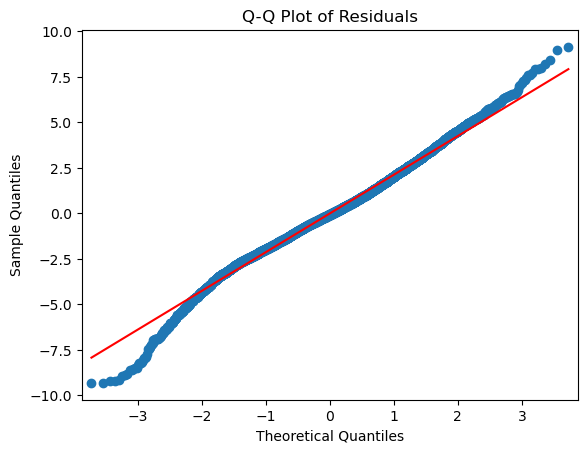

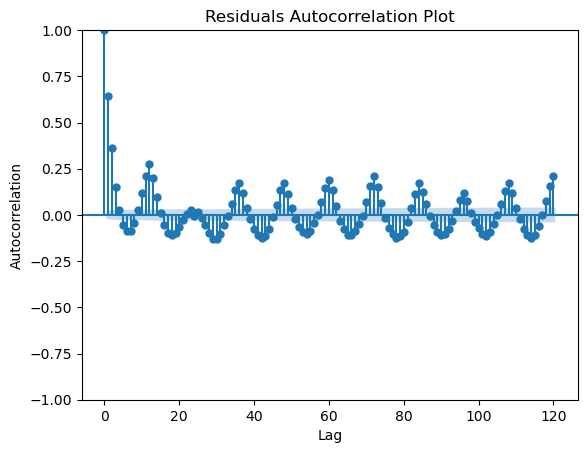

In [39]:
mean_residuals = np.mean(residuals_c3_1)
std_residuals = np.std(residuals_c3_1)

plt.figure(figsize=(8, 6))
sns.histplot(residuals_c3_1, kde=True, stat='density', color='blue', label='Residuals')

sns.lineplot(x=np.linspace(min(residuals_c3_1), max(residuals_c3_1), 100),
             y=norm.pdf(np.linspace(min(residuals_c3_1), max(residuals_c3_1), 100), mean_residuals, std_residuals),
             color='red', linestyle='--', label='Normal Distribution')

plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 6))
sm.qqplot(residuals_c3_1, line='s')
plt.title('Q-Q Plot of Residuals')
plt.show()

sm.graphics.tsa.plot_acf(residuals_c3_1, lags=120)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Residuals Autocorrelation Plot')
plt.show()

In [41]:
summed_data_1 = pd.merge(production_data, weighted_weather_data, on='date_hour', how='inner')
#summed_data_1 = summed_data_1[((summed_data_1['date_hour'].dt.hour >= 6) & (summed_data_1['date_hour'].dt.hour <= 8)) | ((summed_data_1['date_hour'].dt.hour >= 15) & (summed_data_1['date_hour'].dt.hour <= 17))]
summed_data_1 = summed_data_1[((summed_data_1['date_hour'].dt.hour >= 9) & (summed_data_1['date_hour'].dt.hour <= 14))]

summed_data_1.to_excel("data.xlsx", index=True)

summed_data_1['date'] = summed_data_1['date_hour'].dt.date

summed_data_1 = summed_data_1.drop(columns=['date_hour'])
summed_data_1 = summed_data_1.groupby('date').sum()

summed_data_1.to_excel("summed_data_2.xlsx", index=True)

summed_data_1['lag2'] = summed_data_1['production'].shift(2)

summed_data_1 = summed_data_1.dropna()
summed_data_1['cloud_layer'] = np.sum(summed_data_1[['TCDC_low_cloud_layer_data', 'TCDC_middle_cloud_layer_data', 'TCDC_high_cloud_layer_data', 'TCDC_entire_atmosphere_data']], axis=1)

summed_1_endo = summed_data_1['production']
summed_data_1 = summed_data_1.drop(['production', 'DLWRF_surface_data', 'TCDC_low_cloud_layer_data', 'TCDC_middle_cloud_layer_data', 'TCDC_high_cloud_layer_data', 'TCDC_entire_atmosphere_data'], axis=1)

exogenous_data_with_const = sm.add_constant(summed_data_1)

summed_model_1 = sm.OLS(summed_1_endo, exogenous_data_with_const)
summed_result_1 = summed_model_1.fit()

print(summed_result_1.summary())

summed_residuals_1 = summed_result_1.resid
summed_predicted_1 = summed_result_1.predict()


future_data = {
    'DSWRF_surface_data': 123,
    'USWRF_top_of_atmosphere_data': 123,
    'CSNOW_surface_data': 123,
    'USWRF_surface_data': 2,
    'TMP_surface_data': 2,
    'lag2': 2,
    'cloud_layer': 23
}

future_exogenous_data = pd.DataFrame(future_data, index=[0])

future_exogenous_data_with_const = sm.add_constant(future_exogenous_data, has_constant='add')
future_forecast = summed_result_1.predict(future_exogenous_data_with_const)

print(future_forecast)

                            OLS Regression Results                            
Dep. Variable:             production   R-squared:                       0.582
Model:                            OLS   Adj. R-squared:                  0.578
Method:                 Least Squares   F-statistic:                     168.9
Date:                Wed, 05 Jun 2024   Prob (F-statistic):          3.71e-156
Time:                        11:28:15   Log-Likelihood:                -3212.6
No. Observations:                 858   AIC:                             6441.
Df Residuals:                     850   BIC:                             6479.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

     n       mean         sd        CV         FBias  MAPE       RMSE  \
0  858  45.031282  15.818706  0.351283  8.900901e-16   inf  10.230067   

             ME       MAD      MADP     WMAPE  
0  4.008190e-14  7.480123  0.166109  0.166109  


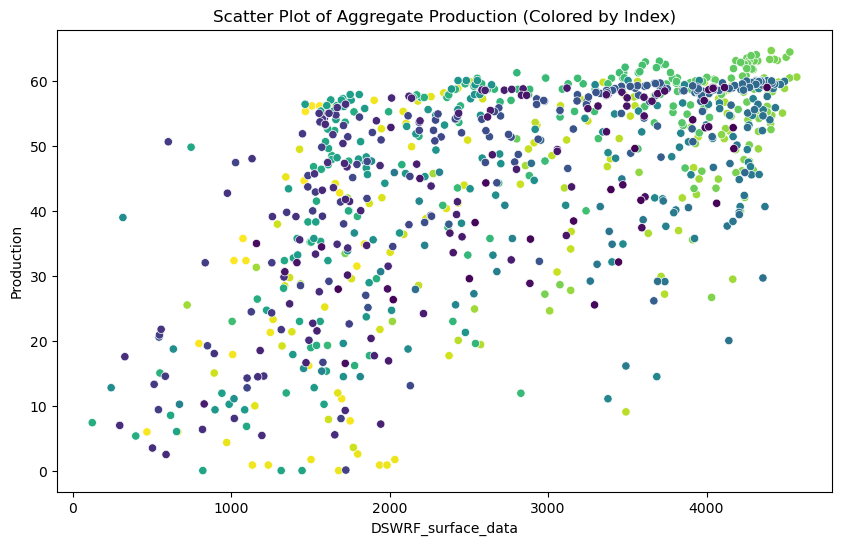

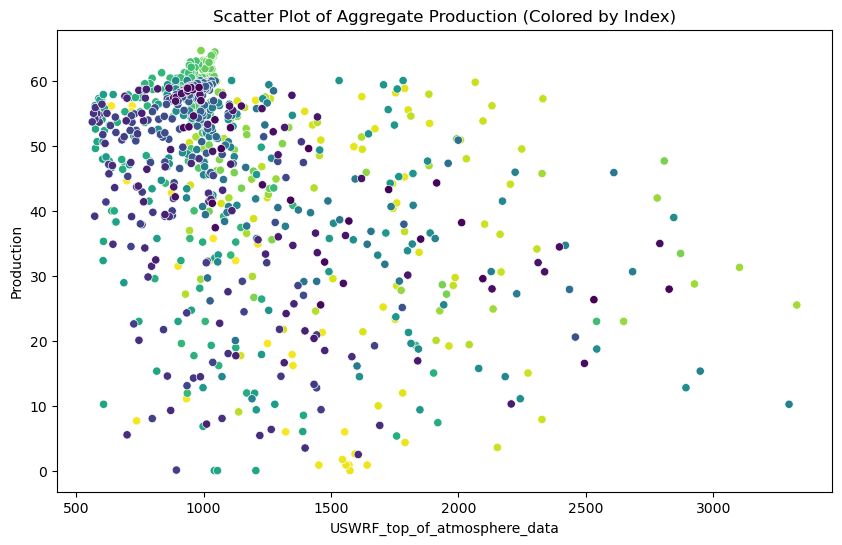

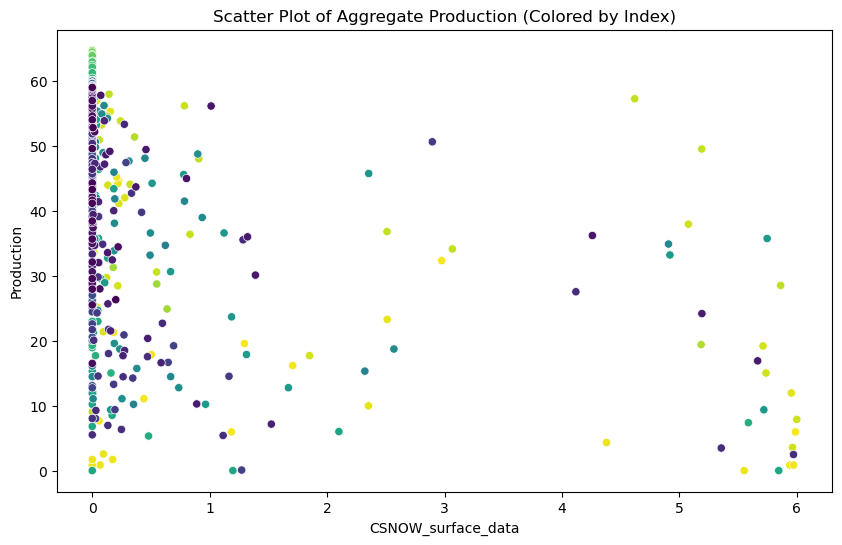

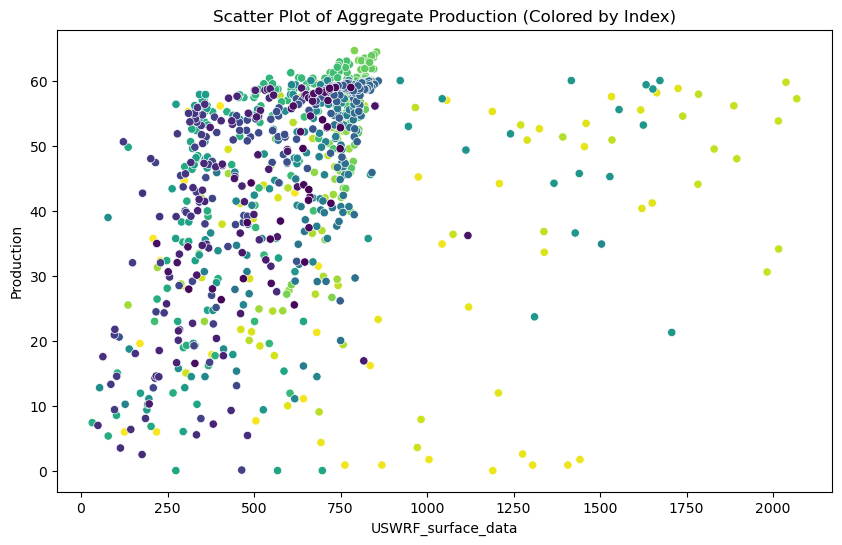

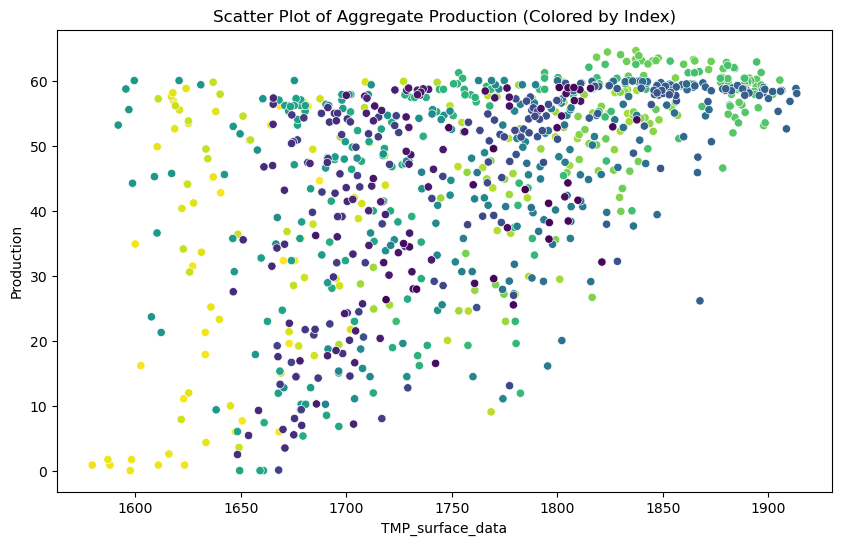

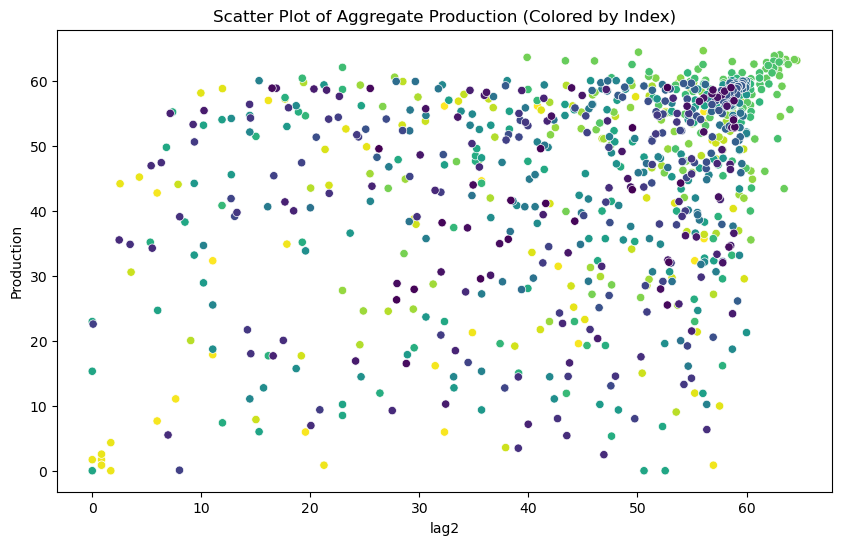

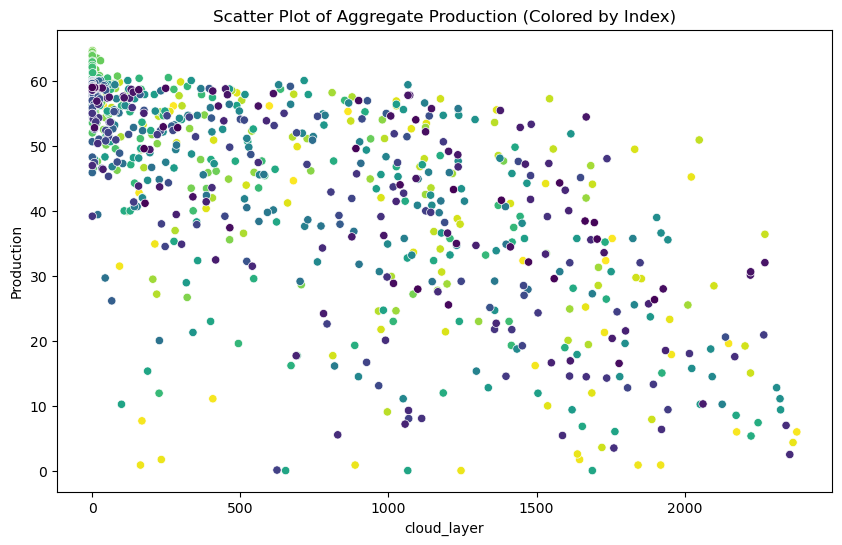

In [42]:
print(model_comparison(summed_1_endo, summed_predicted_1))

for colname in summed_data_1.columns:
    plt.figure(figsize=(10, 6))
    colormap = plt.cm.viridis_r
    norm = plt.Normalize(vmin=0, vmax=len(summed_data_1))
    colors = [colormap(norm(i)) for i in range(len(summed_data_1))]
    sns.scatterplot(x=summed_data_1[colname], y=summed_1_endo, hue=range(len(summed_data_1)), palette=colors, legend=False)
    plt.title('Scatter Plot of Aggregate Production (Colored by Index)')
    plt.xlabel(colname)
    plt.ylabel('Production')
    plt.show()

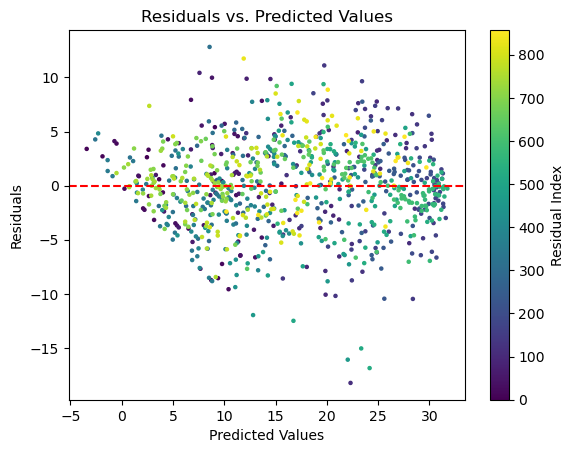

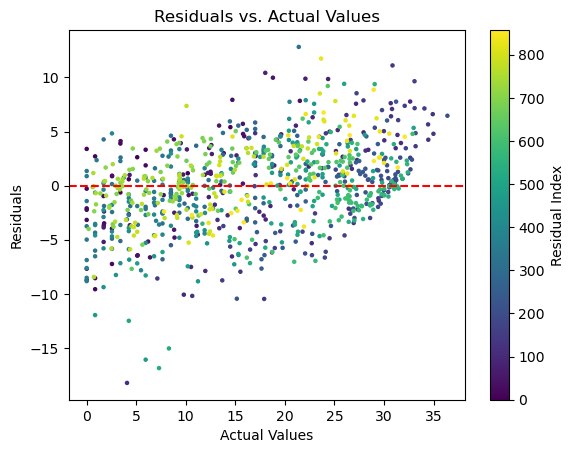

/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


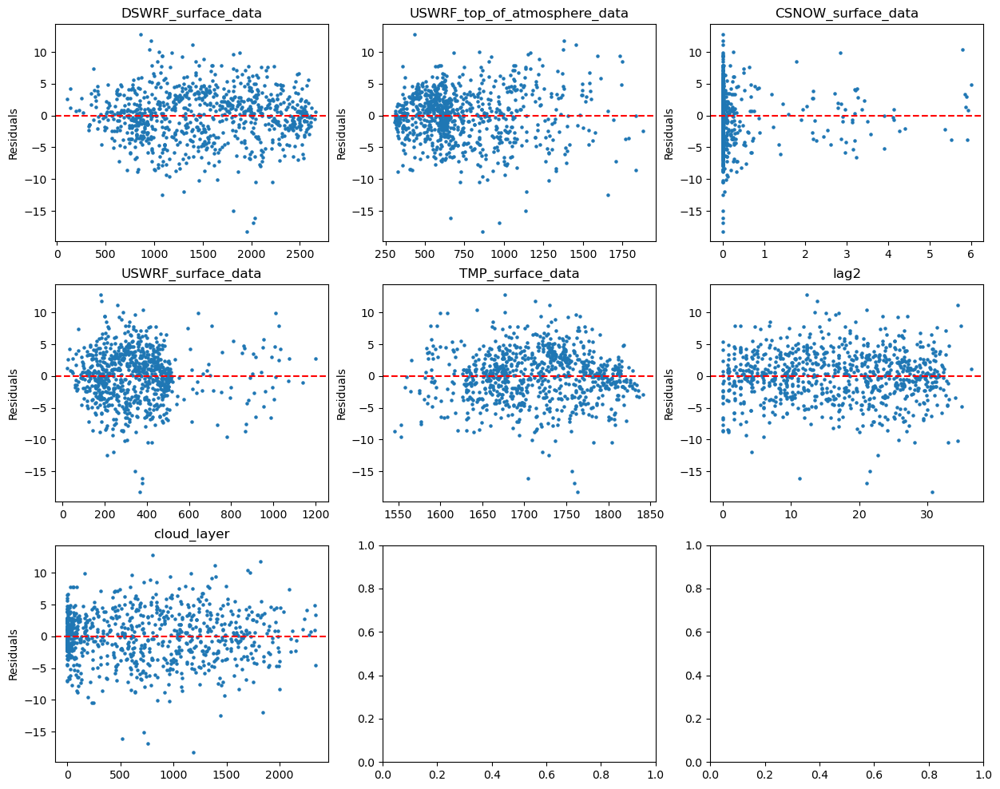

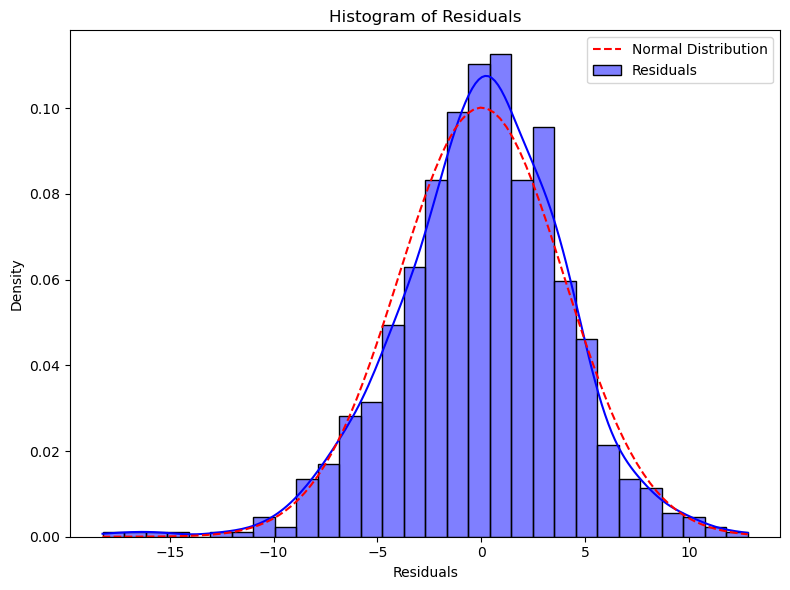

<Figure size 800x600 with 0 Axes>

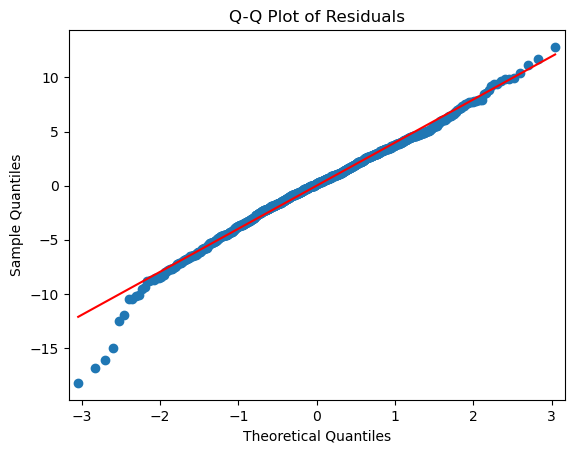

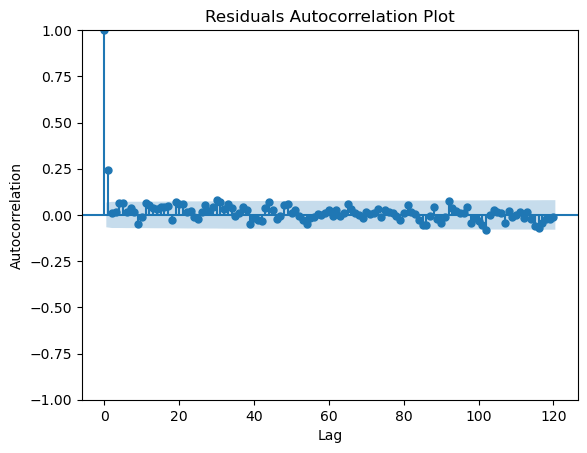

In [ ]:
from scipy.stats import norm

colors = range(len(summed_residuals_1))
plt.scatter(summed_predicted_1, summed_residuals_1, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

plt.scatter(summed_1_endo, summed_residuals_1, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Actual Values')
plt.xlabel('Actual Values')
plt.ylabel('Residuals')
plt.show()

num_columns = summed_data_1.shape[1]
num_rows = (num_columns + 2) // 3

fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 4*num_rows))
axes = axes.flatten()

for i, column in enumerate(summed_data_1.columns):
    if i < num_columns:
        axes[i].scatter(summed_data_1[column], summed_residuals_1[:len(summed_data_1)], s=5)
        axes[i].axhline(y=0, color='red', linestyle='--')
        axes[i].set_title('{}'.format(column))
        axes[i].set_ylabel('Residuals')

mean_residuals = np.mean(summed_residuals_1)
std_residuals = np.std(summed_residuals_1)

plt.figure(figsize=(8, 6))
sns.histplot(summed_residuals_1, kde=True, stat='density', color='blue', label='Residuals')

sns.lineplot(x=np.linspace(min(summed_residuals_1), max(summed_residuals_1), 100),
             y=norm.pdf(np.linspace(min(summed_residuals_1), max(summed_residuals_1), 100), mean_residuals, std_residuals),
             color='red', linestyle='--', label='Normal Distribution')

plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 6))
sm.qqplot(summed_residuals_1, line='s')
plt.title('Q-Q Plot of Residuals')
plt.show()

sm.graphics.tsa.plot_acf(summed_residuals_1, lags=120)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Residuals Autocorrelation Plot')
plt.show()

In [ ]:
summed_data_2 = pd.merge(production_data, weighted_weather_data, on='date_hour', how='inner')
summed_data_2 = summed_data_2[(summed_data_2['date_hour'].dt.hour >= 9) & (summed_data_2['date_hour'].dt.hour <= 14)]

summed_data_2['date'] = summed_data_2['date_hour'].dt.date
summed_data_2 = summed_data_2.drop(columns=['date_hour'])
summed_data_2 = summed_data_2.groupby('date').sum()
#summed_data_2.to_excel("summed_data_2.xlsx", index=True)

summed_data_2['DSWRF_higher_piece'] = np.where(summed_data_2['DSWRF_surface_data'] > 3000, summed_data_2['DSWRF_surface_data'], 0)
summed_data_2['DSWRF_lower_piece'] = np.where(summed_data_2['DSWRF_surface_data'] <= 3000, summed_data_2['DSWRF_surface_data'], 0)

summed_data_2['lag2'] = summed_data_2['production'].shift(2)
summed_data_2 = summed_data_2.dropna()

summed_2_endo = summed_data_2['production']
summed_data_2 = summed_data_2.drop(['production', 'DSWRF_surface_data'], axis=1)

exogenous_data_with_const = sm.add_constant(summed_data_2)

summed_model_2 = sm.OLS(summed_2_endo, exogenous_data_with_const)
summed_result_2 = summed_model_2.fit()

print(summed_result_2.summary())

                            OLS Regression Results                            
Dep. Variable:             production   R-squared:                       0.630
Model:                            OLS   Adj. R-squared:                  0.625
Method:                 Least Squares   F-statistic:                     120.0
Date:                Tue, 04 Jun 2024   Prob (F-statistic):          3.29e-173
Time:                        21:30:52   Log-Likelihood:                -3159.8
No. Observations:                 858   AIC:                             6346.
Df Residuals:                     845   BIC:                             6407.
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

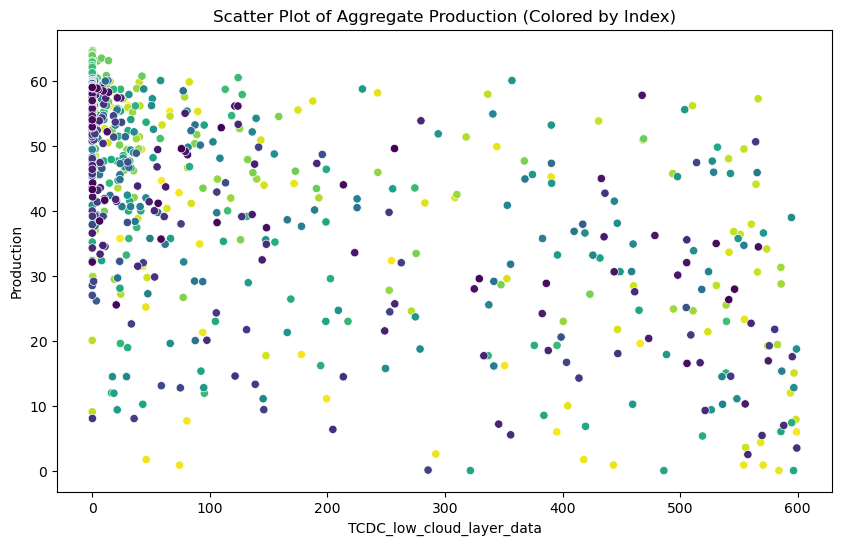

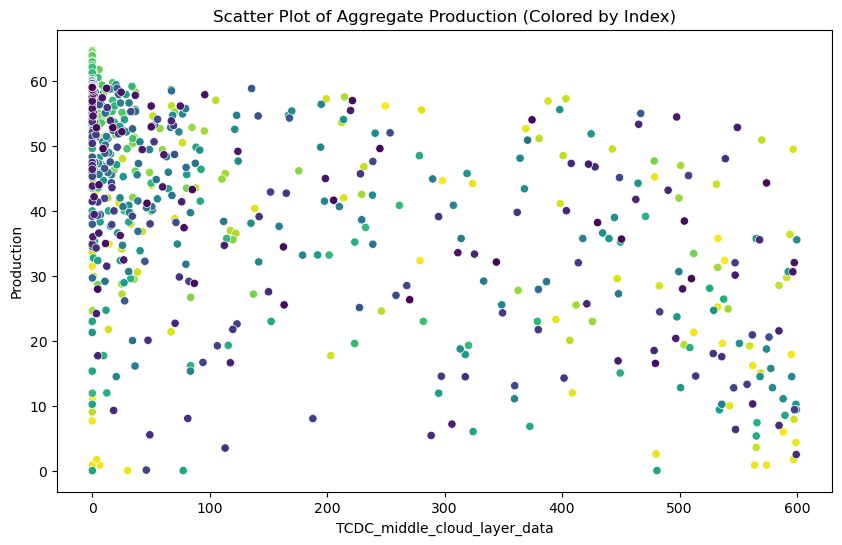

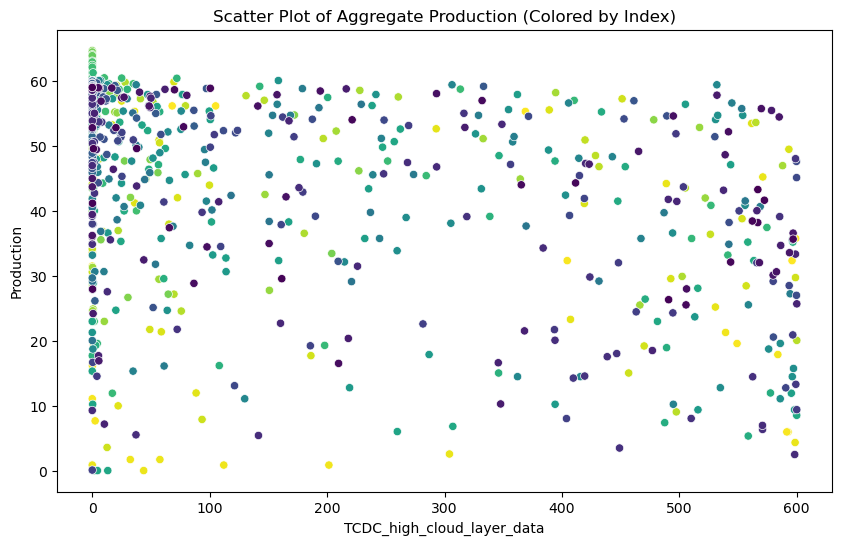

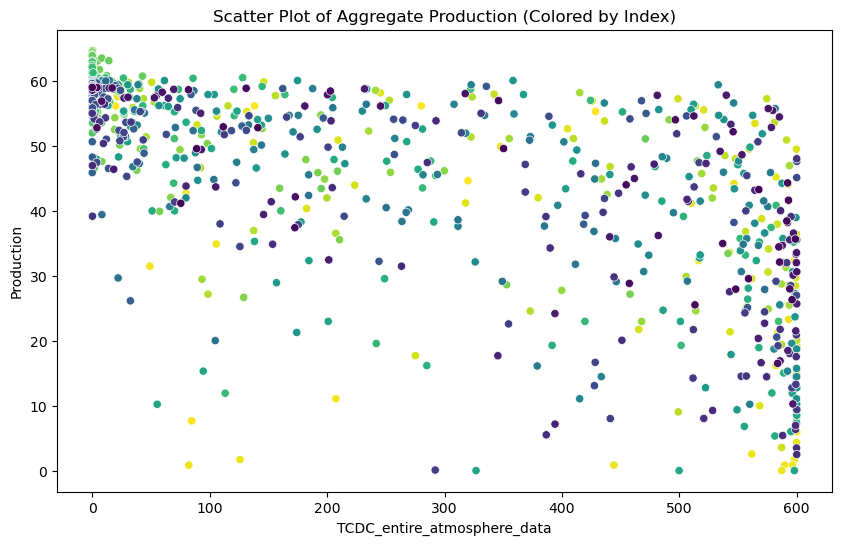

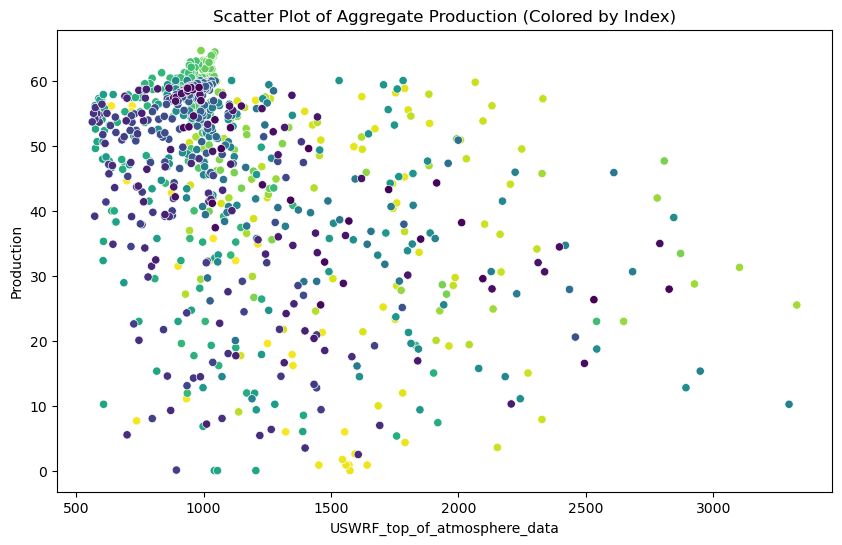

...

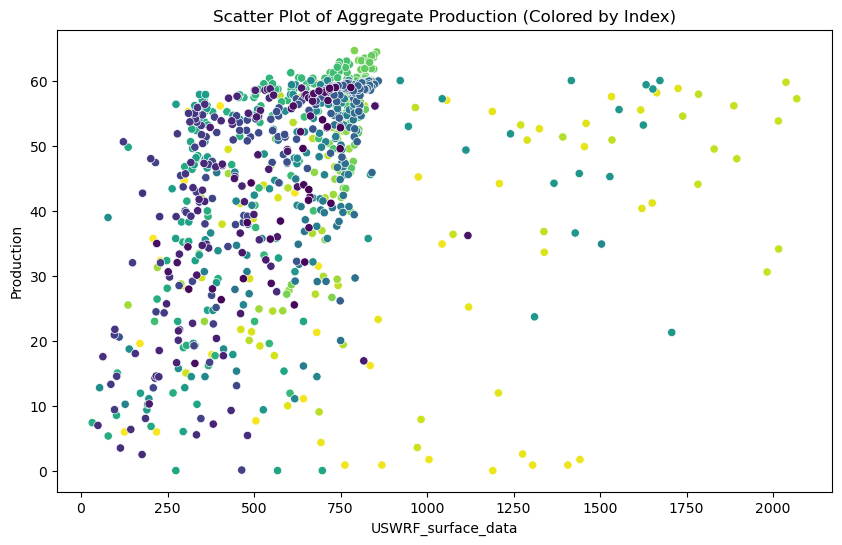

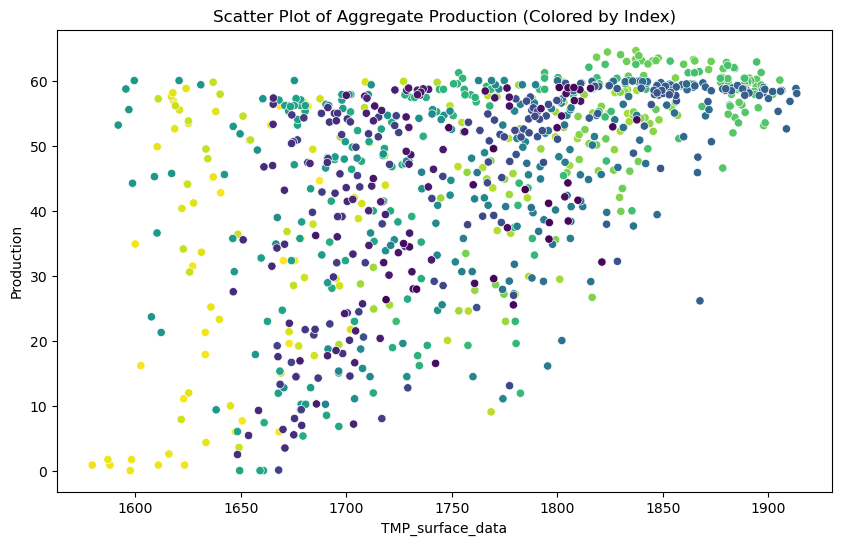

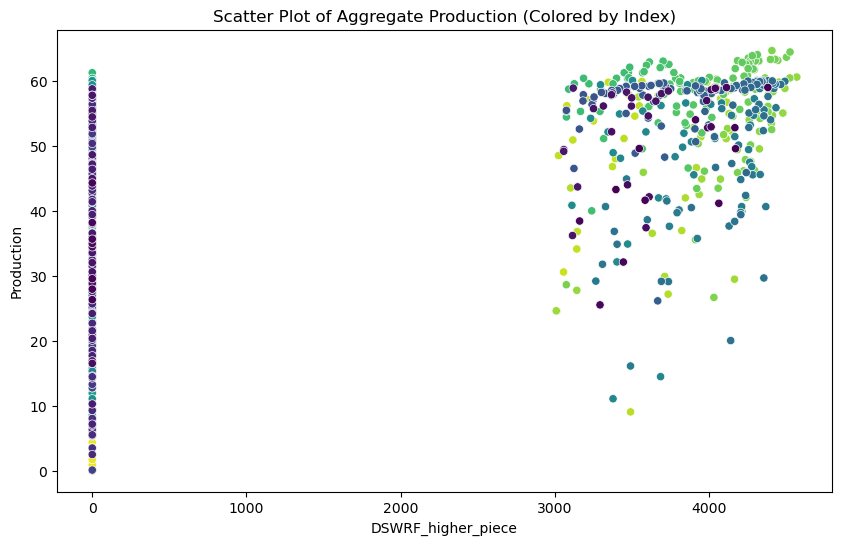

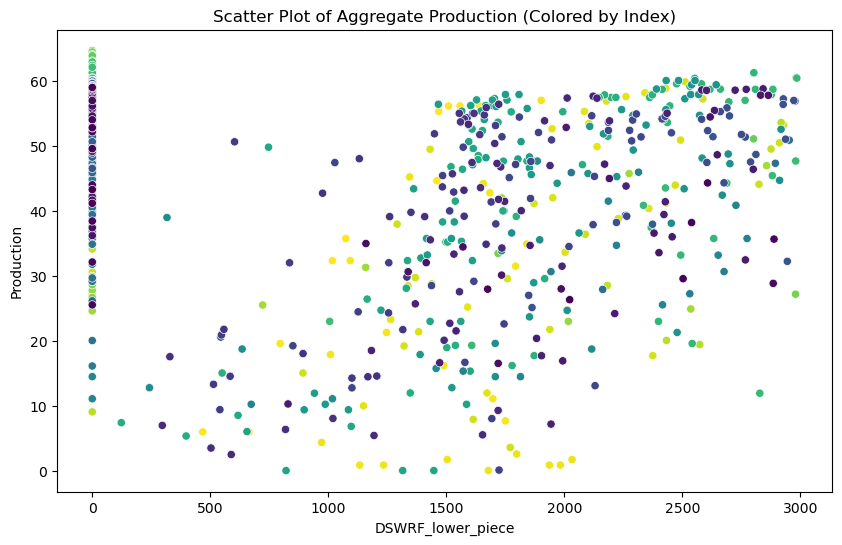

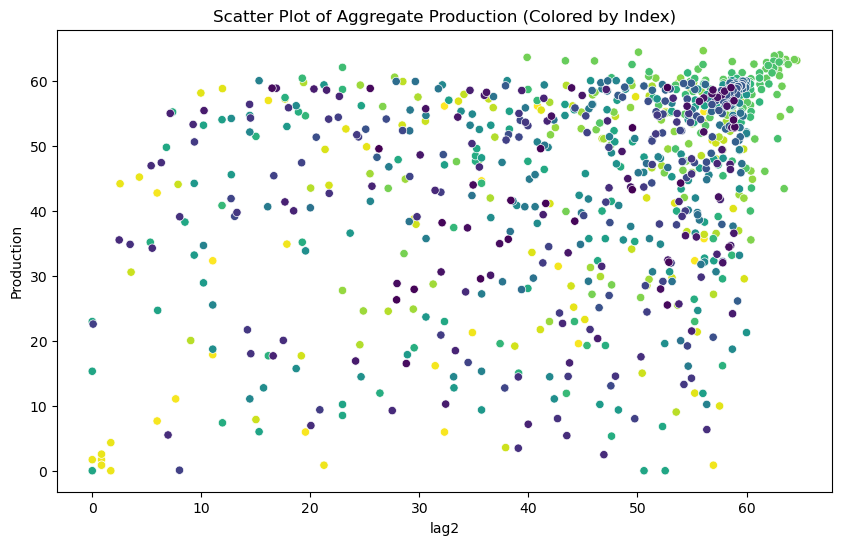

In [ ]:
for colname in summed_data_2.columns:
    plt.figure(figsize=(10, 6))
    colormap = plt.cm.viridis_r
    norm = plt.Normalize(vmin=0, vmax=len(summed_data_2))
    colors = [colormap(norm(i)) for i in range(len(summed_data_2))]
    sns.scatterplot(x=summed_data_2[colname], y=summed_2_endo, hue=range(len(summed_data_2)), palette=colors, legend=False)
    plt.title('Scatter Plot of Aggregate Production (Colored by Index)')
    plt.xlabel(colname)
    plt.ylabel('Production')
    plt.show()

     n       mean         sd        CV         FBias  MAPE     RMSE  \
0  858  45.031282  15.818706  0.351283  4.812371e-15   inf  9.61916   

             ME       MAD      MADP     WMAPE  
0  2.167073e-13  6.814484  0.151328  0.151328  


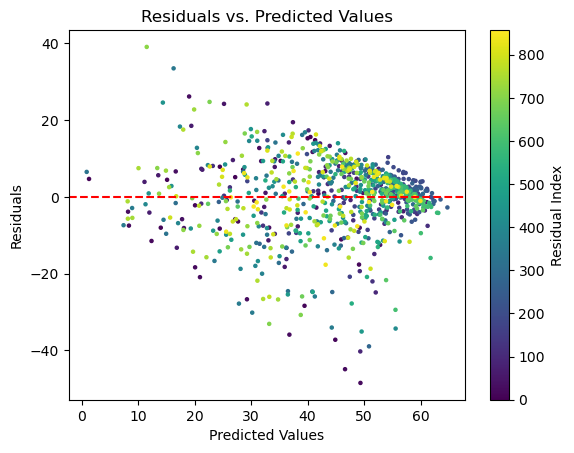

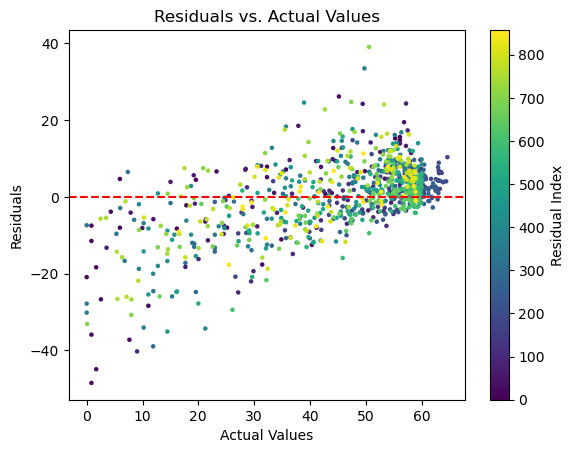

/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


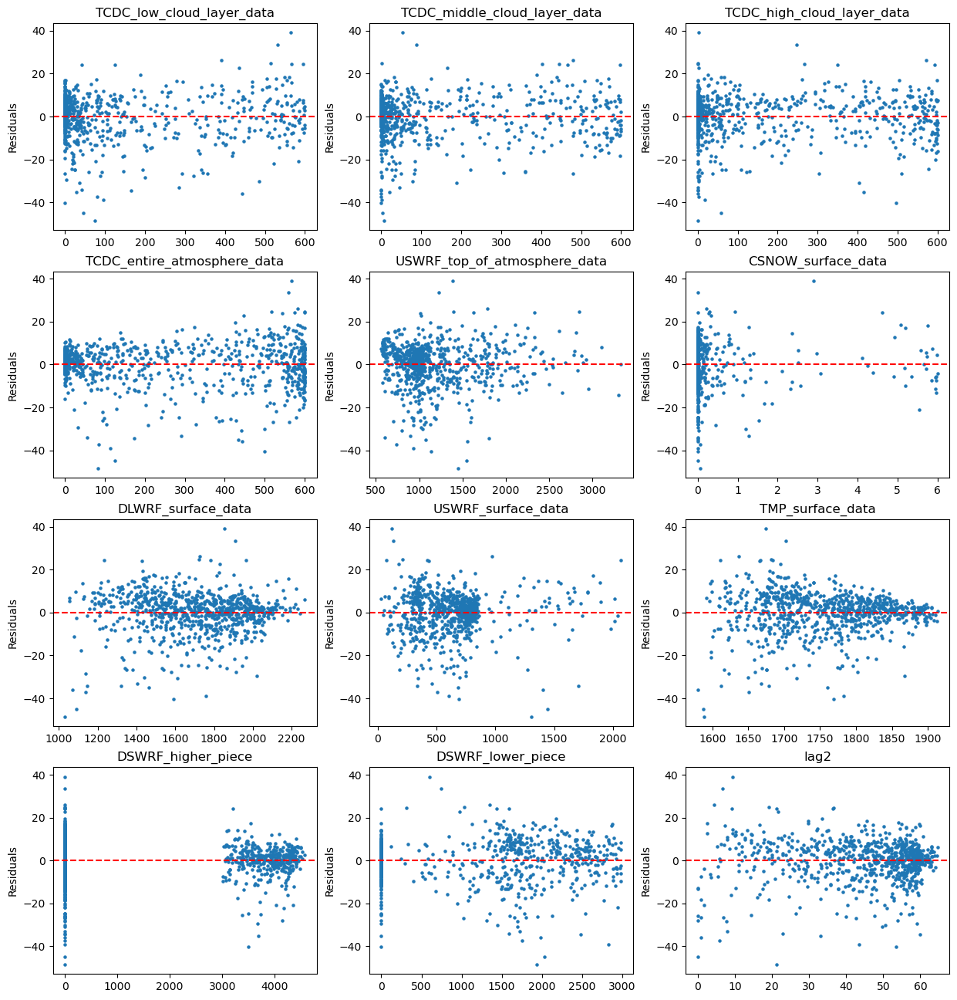

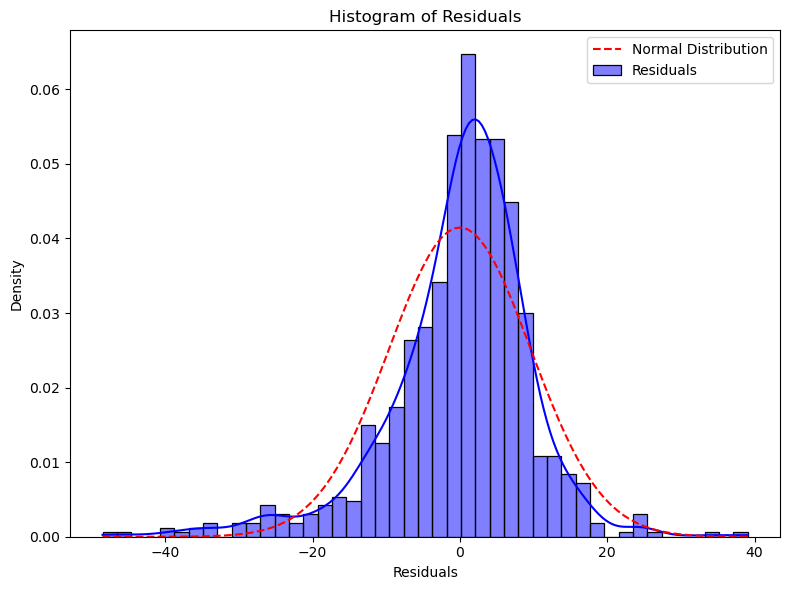

<Figure size 800x600 with 0 Axes>

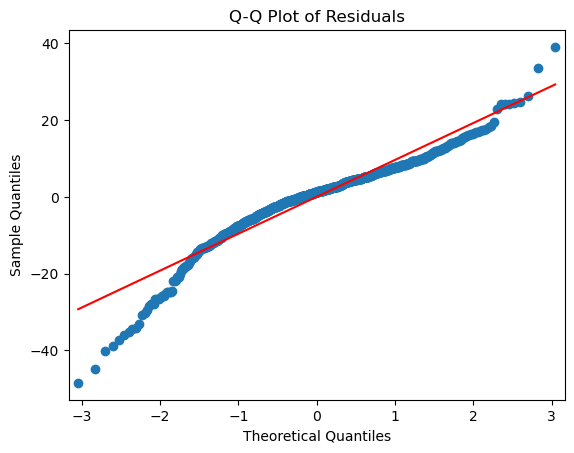

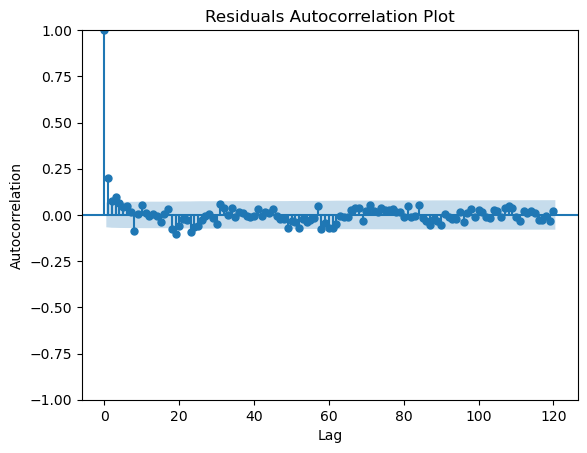

In [ ]:
summed_residuals_2 = summed_result_2.resid
summed_predicted_2 = summed_result_2.predict()

print(model_comparison(summed_2_endo, summed_predicted_2))

colors = range(len(summed_residuals_2))
plt.scatter(summed_predicted_2, summed_residuals_2, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

plt.scatter(summed_2_endo, summed_residuals_2, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Actual Values')
plt.xlabel('Actual Values')
plt.ylabel('Residuals')
plt.show()

num_columns = summed_data_2.shape[1]
num_rows = (num_columns + 2) // 3

fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 4*num_rows))
axes = axes.flatten()

for i, column in enumerate(summed_data_2.columns):
    if i < num_columns:
        axes[i].scatter(summed_data_2[column], summed_residuals_2[:len(summed_data_2)], s=5)
        axes[i].axhline(y=0, color='red', linestyle='--')
        axes[i].set_title('{}'.format(column))
        axes[i].set_ylabel('Residuals')

from scipy.stats import norm
mean_residuals = np.mean(summed_residuals_2)
std_residuals = np.std(summed_residuals_2)

plt.figure(figsize=(8, 6))
sns.histplot(summed_residuals_2, kde=True, stat='density', color='blue', label='Residuals')

sns.lineplot(x=np.linspace(min(summed_residuals_2), max(summed_residuals_2), 100),
             y=norm.pdf(np.linspace(min(summed_residuals_2), max(summed_residuals_2), 100), mean_residuals, std_residuals),
             color='red', linestyle='--', label='Normal Distribution')

plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(8, 6))
sm.qqplot(summed_residuals_2, line='s')
plt.title('Q-Q Plot of Residuals')
plt.show()

sm.graphics.tsa.plot_acf(summed_residuals_2, lags=120)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Residuals Autocorrelation Plot')
plt.show()

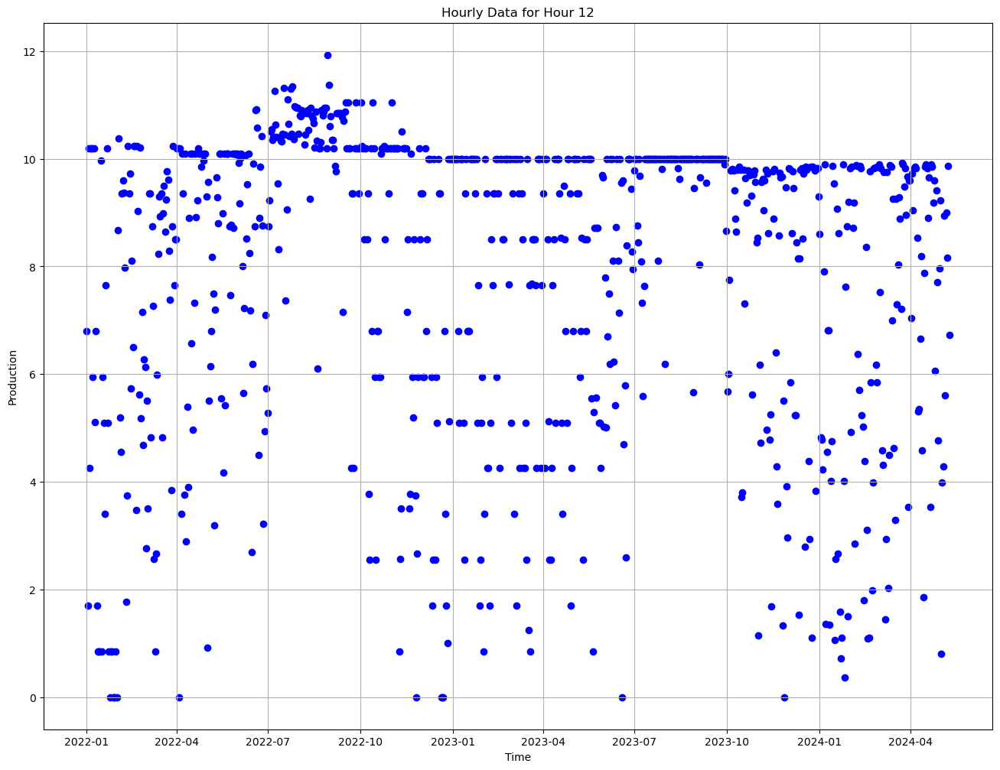

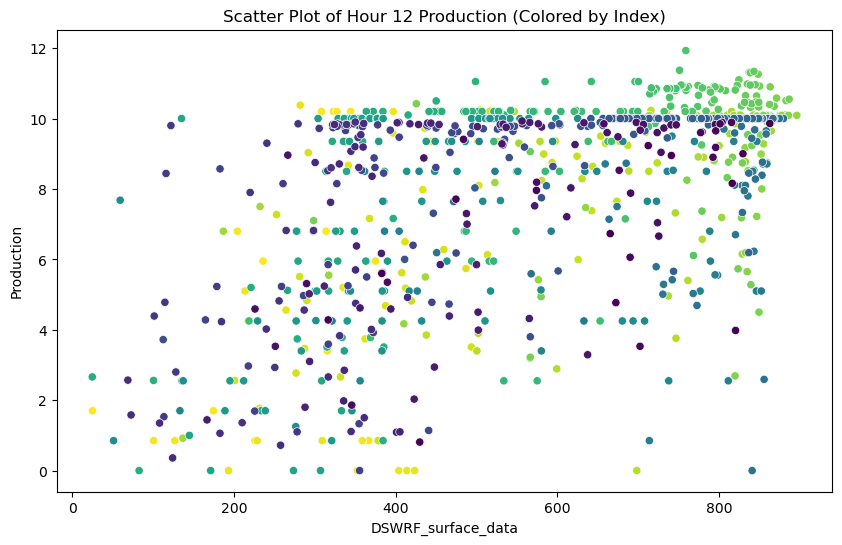

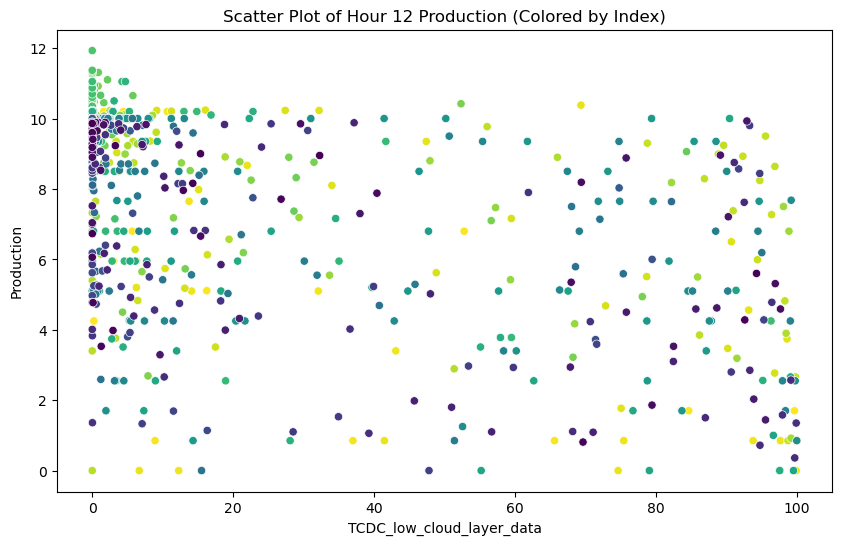

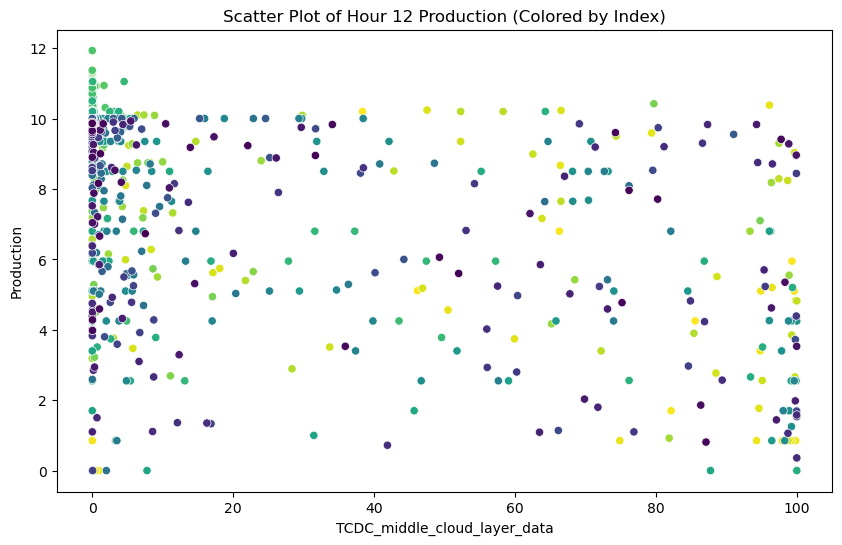

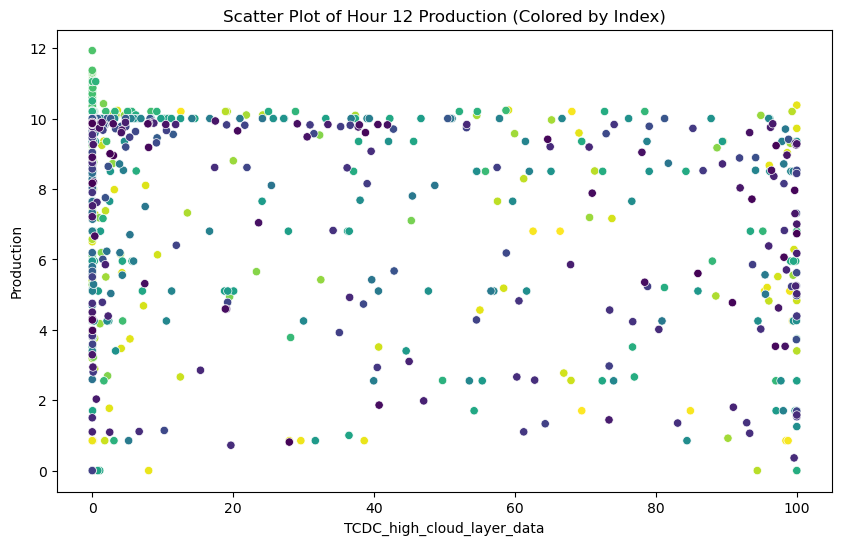

...

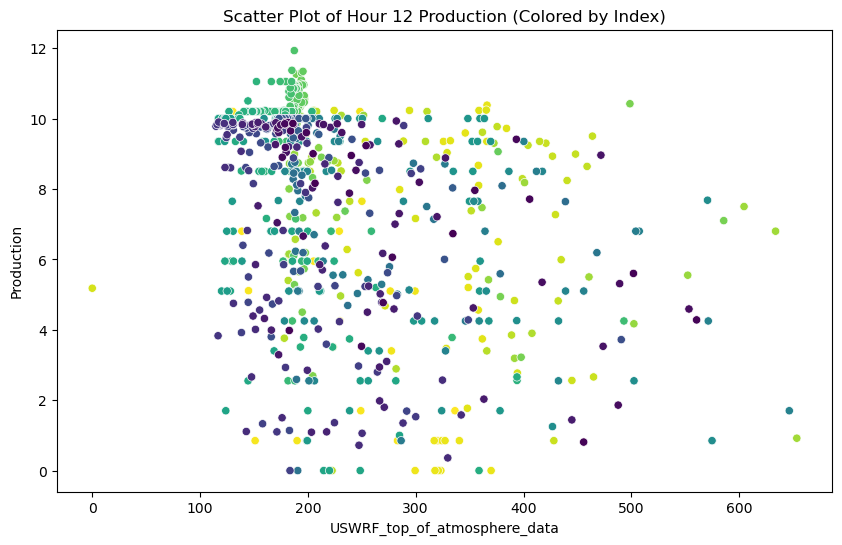

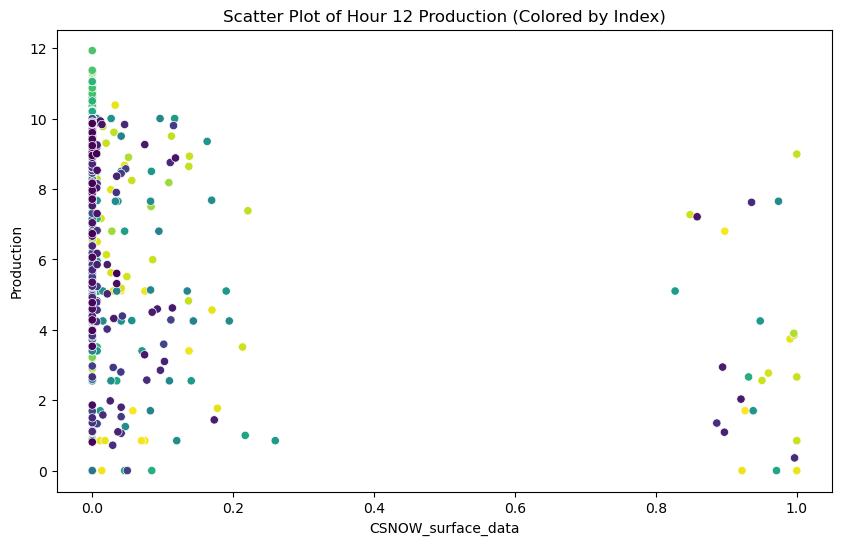

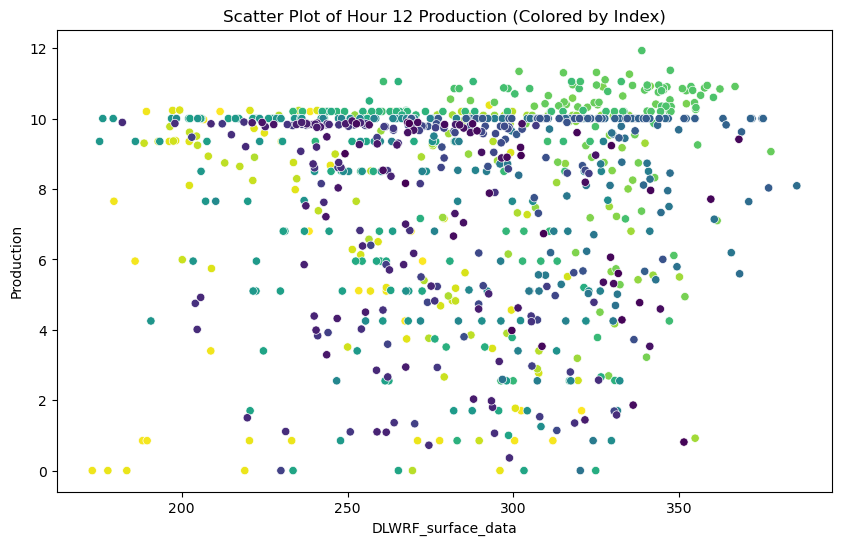

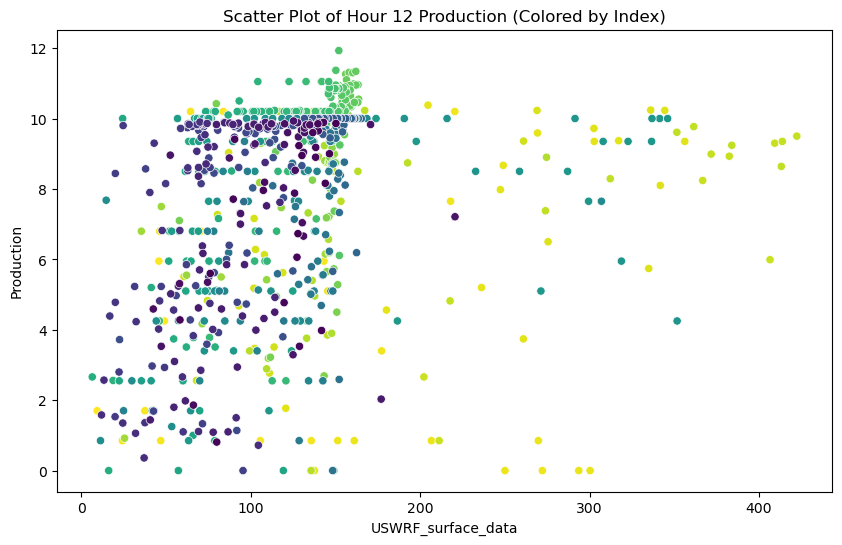

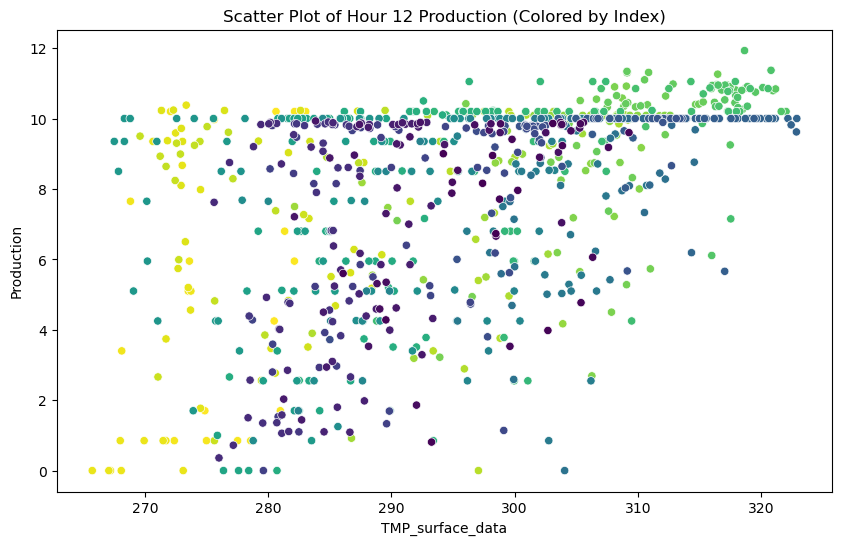

In [ ]:
hour = 12
regression_hour_6_final = hourly_datasets[hour]
regression_hour_6_final_endo = regression_hour_6_final['production']
regression_hour_6_final = regression_hour_6_final.drop(['hour', 'date_hour', 'production'], axis=1)

plt.figure(figsize=(16, 12))
plt.scatter(hourly_datasets[hour]['date_hour'], hourly_datasets[hour]['production'], marker='o', color='blue')
plt.xlabel('Time')
plt.ylabel('Production')
plt.title(f'Hourly Data for Hour {hour}')
plt.grid(True)
plt.show()

for colname in regression_hour_6_final.columns:
    plt.figure(figsize=(10, 6))
    colormap = plt.cm.viridis_r
    norm = plt.Normalize(vmin=0, vmax=len(regression_hour_6_final))
    colors = [colormap(norm(i)) for i in range(len(regression_hour_6_final))]
    sns.scatterplot(x=regression_hour_6_final[colname], y=regression_hour_6_final_endo, hue=range(len(regression_hour_6_final)), palette=colors, legend=False)
    plt.title(f'Scatter Plot of Hour {hour} Production (Colored by Index)')
    plt.xlabel(colname)
    plt.ylabel('Production')
    plt.show()

                            OLS Regression Results                            
Dep. Variable:             production   R-squared:                       0.482
Model:                            OLS   Adj. R-squared:                  0.476
Method:                 Least Squares   F-statistic:                     79.06
Date:                Tue, 04 Jun 2024   Prob (F-statistic):          3.52e-114
Time:                        21:31:06   Log-Likelihood:                -1854.4
No. Observations:                 860   AIC:                             3731.
Df Residuals:                     849   BIC:                             3783.
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

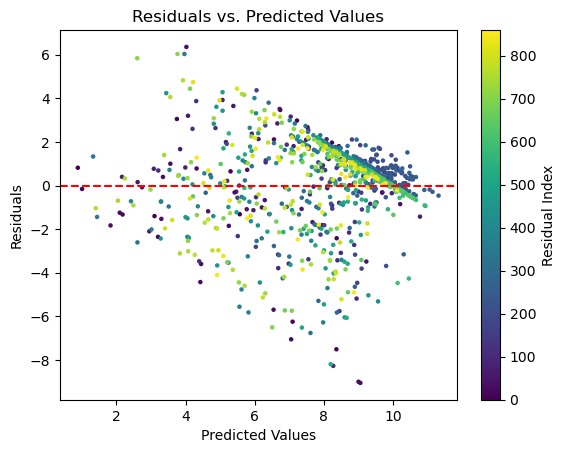

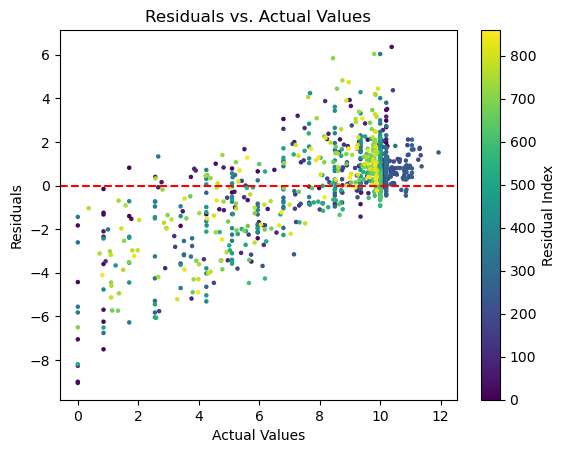

/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


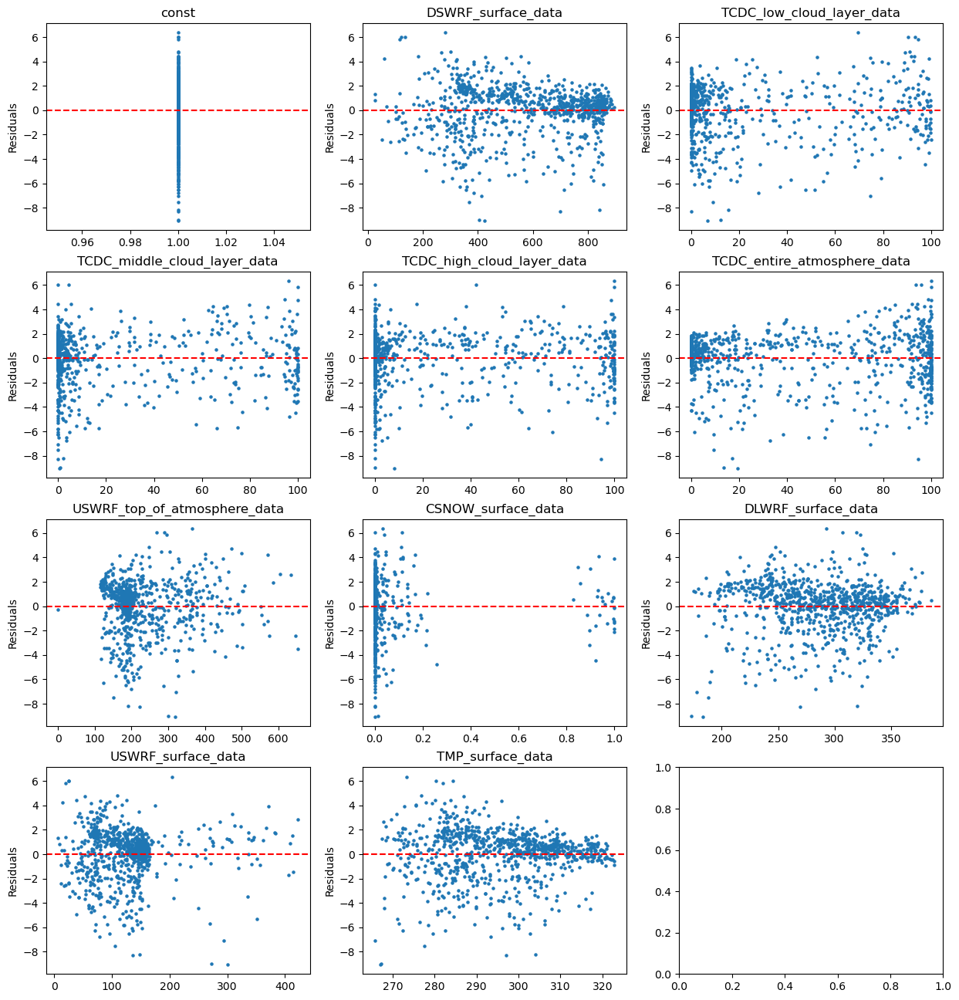

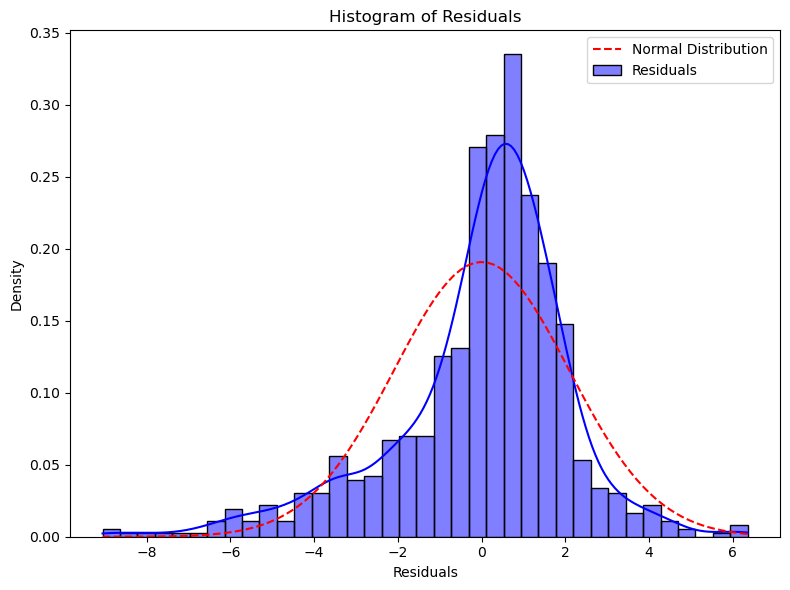

<Figure size 800x600 with 0 Axes>

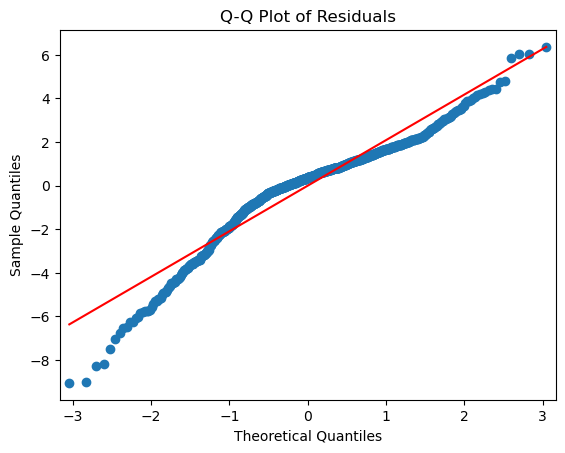

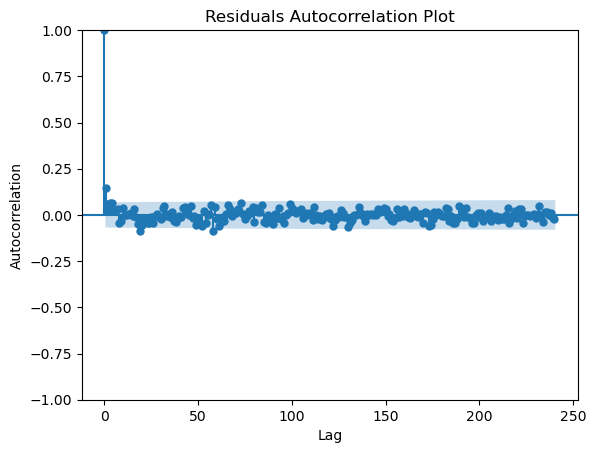

In [ ]:
regression_hour_6_final_wc = sm.add_constant(regression_hour_6_final)
model_hour_6_final = sm.OLS(regression_hour_6_final_endo, regression_hour_6_final_wc)
result_hour_6_final = model_hour_6_final.fit()
print(result_hour_6_final.summary())

residuals_hour_6_final = result_hour_6_final.resid
predicted_hour_6_final = result_hour_6_final.predict()

colors = range(len(residuals_hour_6_final))
plt.scatter(predicted_hour_6_final, residuals_hour_6_final, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

plt.scatter(regression_hour_6_final_endo, residuals_hour_6_final, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Actual Values')
plt.xlabel('Actual Values')
plt.ylabel('Residuals')
plt.show()

num_columns = regression_hour_6_final_wc.shape[1]
num_rows = (num_columns + 2) // 3

fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 4*num_rows))
axes = axes.flatten()

for i, column in enumerate(regression_hour_6_final_wc.columns):
    if i < num_columns:
        axes[i].scatter(regression_hour_6_final_wc[column], residuals_hour_6_final[:len(regression_hour_6_final_wc)], s=5)
        axes[i].axhline(y=0, color='red', linestyle='--')
        axes[i].set_title('{}'.format(column))
        axes[i].set_ylabel('Residuals')

from scipy.stats import norm
mean_residuals = np.mean(residuals_hour_6_final)
std_residuals = np.std(residuals_hour_6_final)

plt.figure(figsize=(8, 6))
sns.histplot(residuals_hour_6_final, kde=True, stat='density', color='blue', label='Residuals')

sns.lineplot(x=np.linspace(min(residuals_hour_6_final), max(residuals_hour_6_final), 100),
             y=norm.pdf(np.linspace(min(residuals_hour_6_final), max(residuals_hour_6_final), 100), mean_residuals, std_residuals),
             color='red', linestyle='--', label='Normal Distribution')

plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(8, 6))
sm.qqplot(residuals_hour_6_final, line='s')
plt.title('Q-Q Plot of Residuals')
plt.show()

sm.graphics.tsa.plot_acf(residuals_hour_6_final, lags=240)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Residuals Autocorrelation Plot')
plt.show()

In [ ]:
summed_data_2 = pd.merge(production_data, weighted_weather_data, on='date_hour', how='inner')
summed_data_2 = summed_data_2[(summed_data_2['date_hour'].dt.hour >= 9) & (summed_data_2['date_hour'].dt.hour <= 14)]

summed_data_2['date'] = summed_data_2['date_hour'].dt.date
summed_data_2 = summed_data_2.drop(columns=['date_hour'])

summed_data_2 = summed_data_2.groupby('date').sum()

summed_data_2['lag2'] = summed_data_2['production'].shift(2)
summed_data_2['cloud_layer'] = np.sum(summed_data_2[['TCDC_low_cloud_layer_data', 'TCDC_middle_cloud_layer_data', 'TCDC_entire_atmosphere_data']], axis=1)

summed_data_2 = summed_data_2.dropna()

summed_data_2_lower = summed_data_2[summed_data_2['DSWRF_surface_data'] <= 2800]
summed_data_2_higher = summed_data_2[summed_data_2['DSWRF_surface_data'] > 2800]
summed_data_2_higher = summed_data_2_higher[summed_data_2_higher['production'] > 10]

summed_2_endo_lower = summed_data_2_lower['production']
summed_2_endo_higher = summed_data_2_higher['production']

columns_to_drop = ['production', 'TCDC_low_cloud_layer_data', 'TCDC_middle_cloud_layer_data', 'TCDC_high_cloud_layer_data', 'TCDC_entire_atmosphere_data']
summed_data_2_lower = summed_data_2_lower.drop(columns_to_drop, axis=1)
summed_data_2_higher = summed_data_2_higher.drop(columns_to_drop, axis=1)

exogenous_data_with_const_lower = sm.add_constant(summed_data_2_lower)
exogenous_data_with_const_higher = sm.add_constant(summed_data_2_higher)

summed_model_2_lower = sm.OLS(summed_2_endo_lower, exogenous_data_with_const_lower)
summed_result_2_lower = summed_model_2_lower.fit()

summed_model_2_higher = sm.OLS(summed_2_endo_higher, exogenous_data_with_const_higher)
summed_result_2_higher = summed_model_2_higher.fit()

print(summed_result_2_lower.summary())

                            OLS Regression Results                            
Dep. Variable:             production   R-squared:                       0.542
Model:                            OLS   Adj. R-squared:                  0.533
Method:                 Least Squares   F-statistic:                     61.00
Date:                Tue, 04 Jun 2024   Prob (F-statistic):           2.99e-65
Time:                        21:31:10   Log-Likelihood:                -1626.1
No. Observations:                 421   AIC:                             3270.
Df Residuals:                     412   BIC:                             3307.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

In [ ]:
print(summed_result_2_higher.summary())

                            OLS Regression Results                            
Dep. Variable:             production   R-squared:                       0.468
Model:                            OLS   Adj. R-squared:                  0.458
Method:                 Least Squares   F-statistic:                     47.02
Date:                Tue, 04 Jun 2024   Prob (F-statistic):           4.59e-54
Time:                        21:31:10   Log-Likelihood:                -1464.2
No. Observations:                 436   AIC:                             2946.
Df Residuals:                     427   BIC:                             2983.
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

     n      mean         sd        CV         FBias  MAPE      RMSE  \
0  421  37.15981  17.017097  0.457944  7.466379e-15   inf  11.51342   

             ME       MAD      MADP     WMAPE  
0  2.774492e-13  8.838607  0.237854  0.237854  


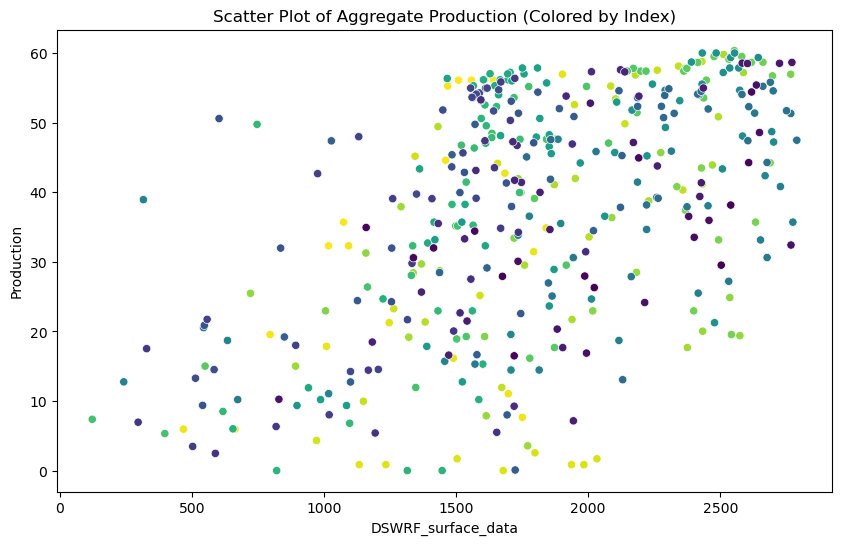

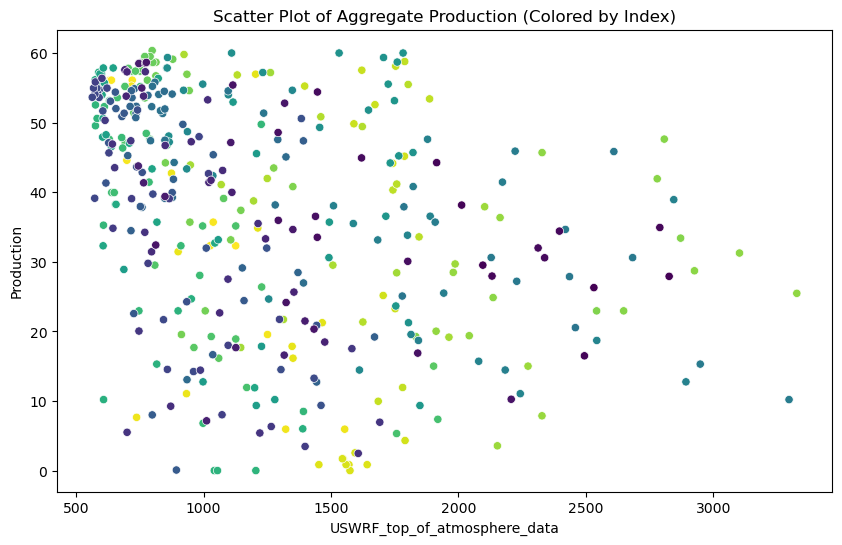

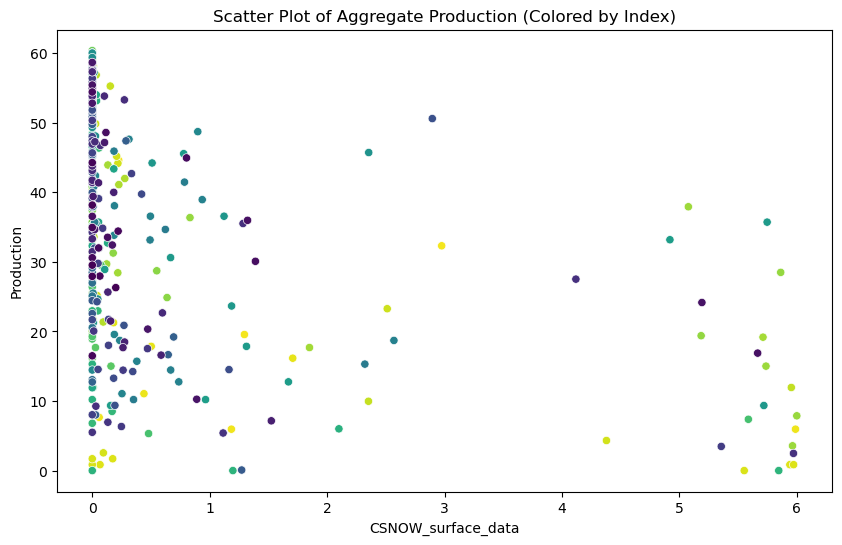

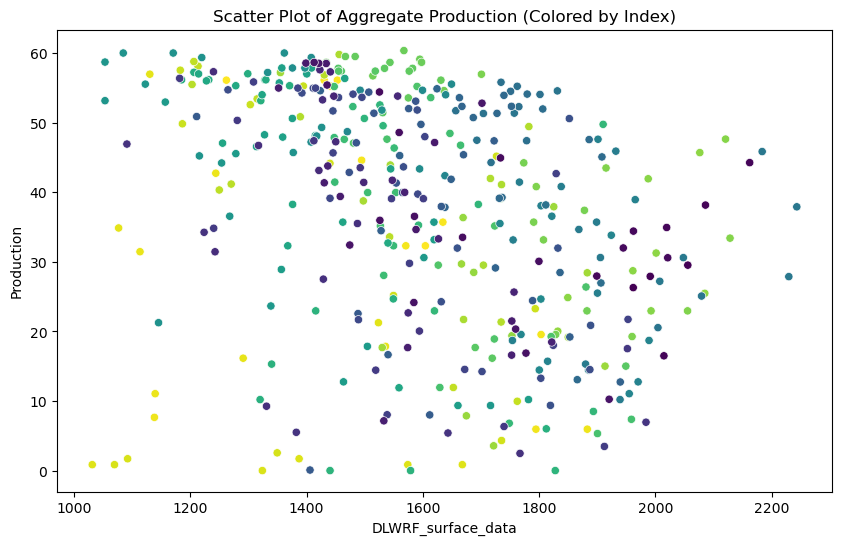

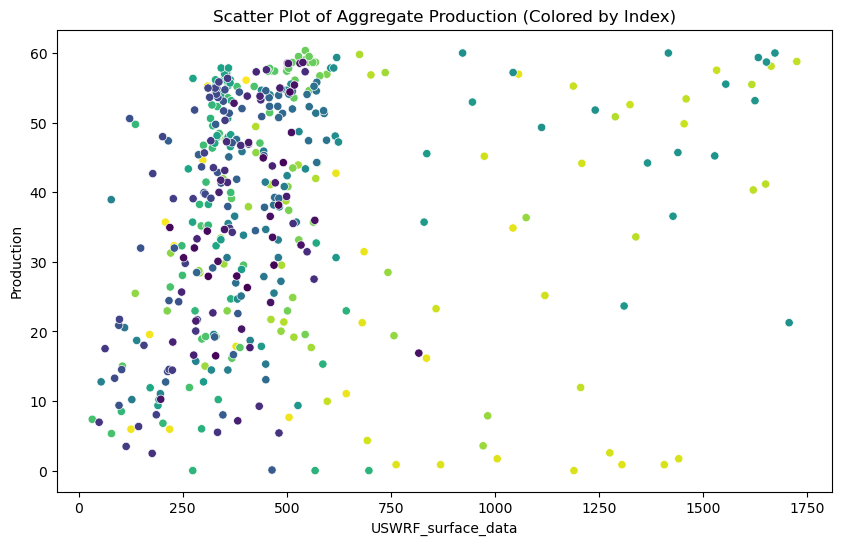

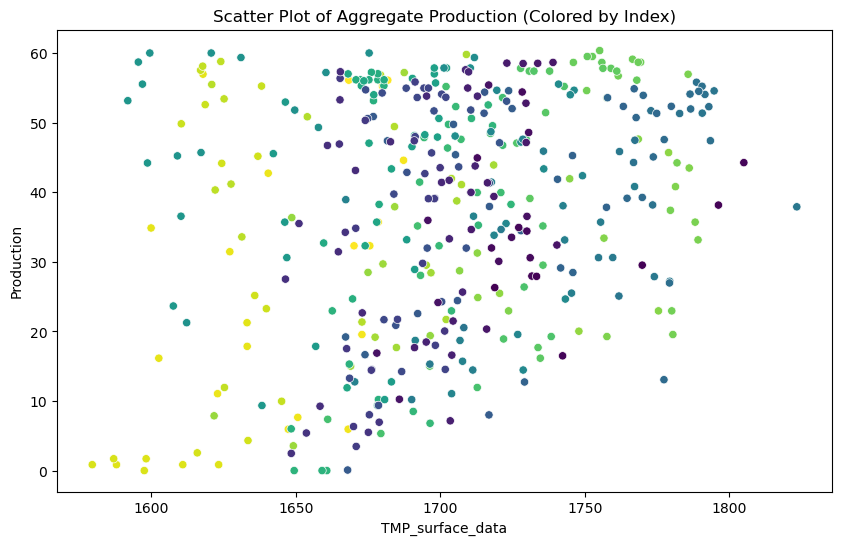

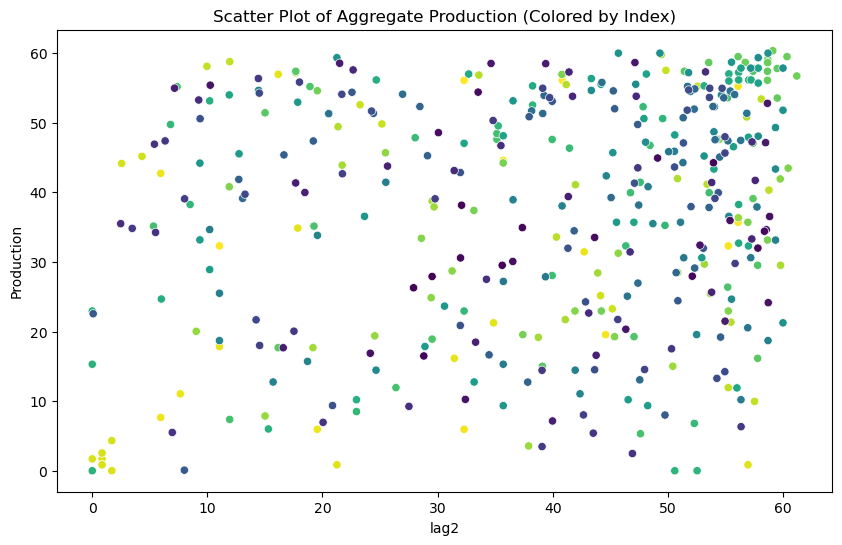

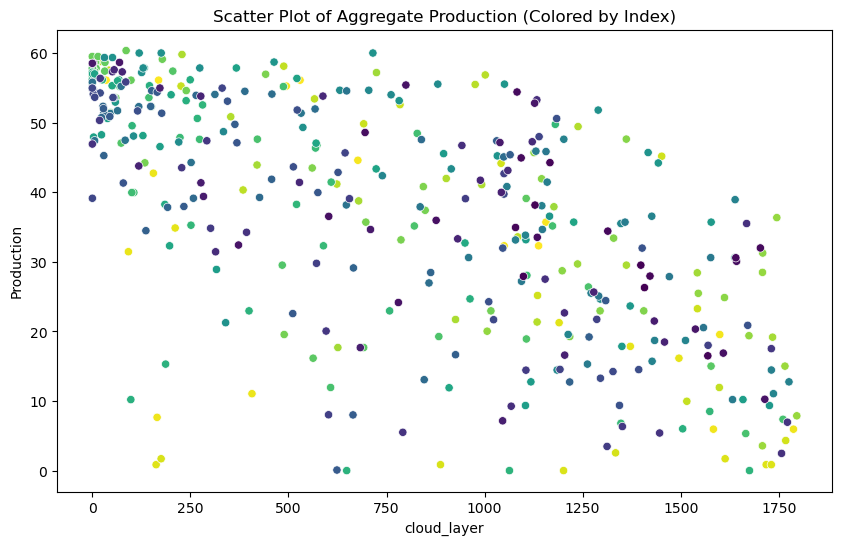

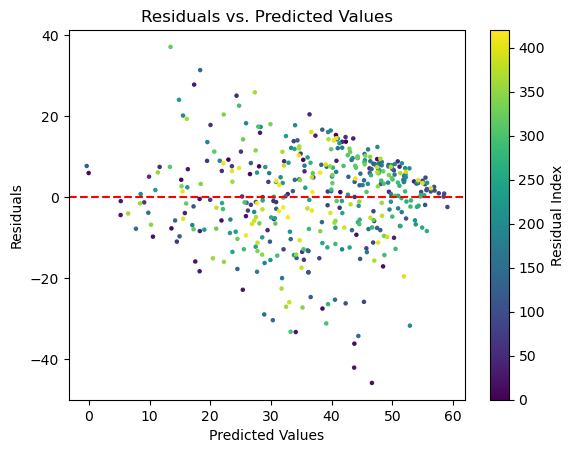

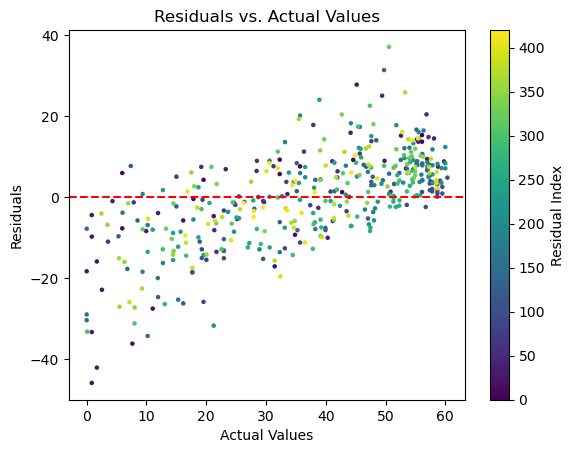

/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


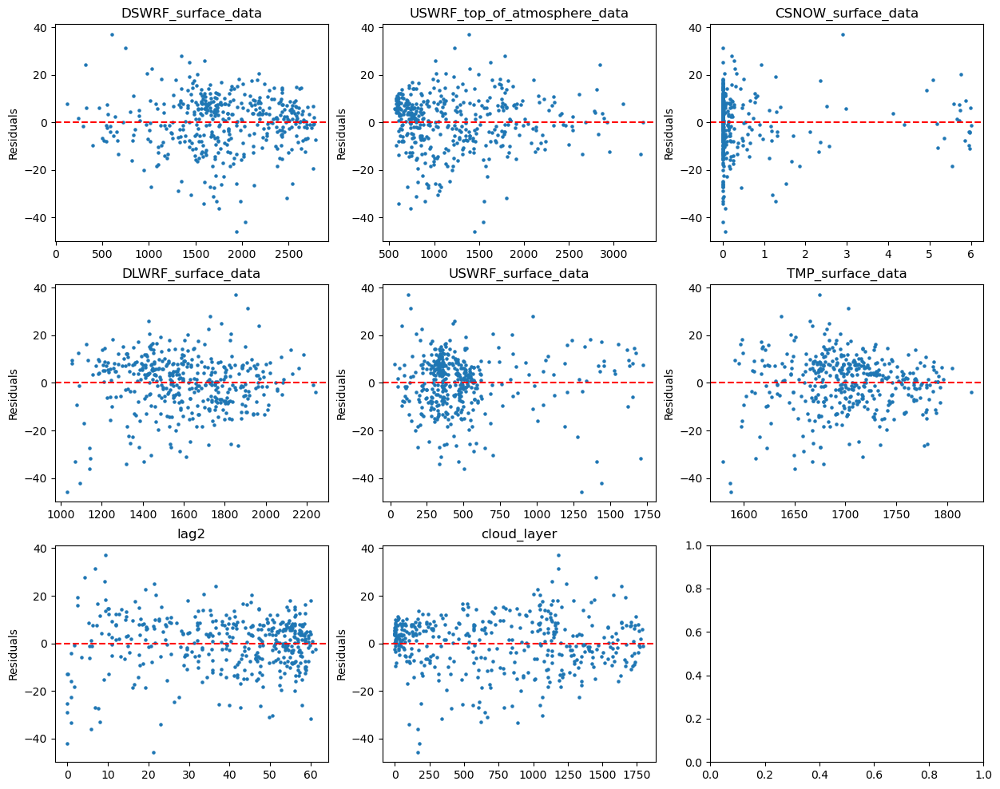

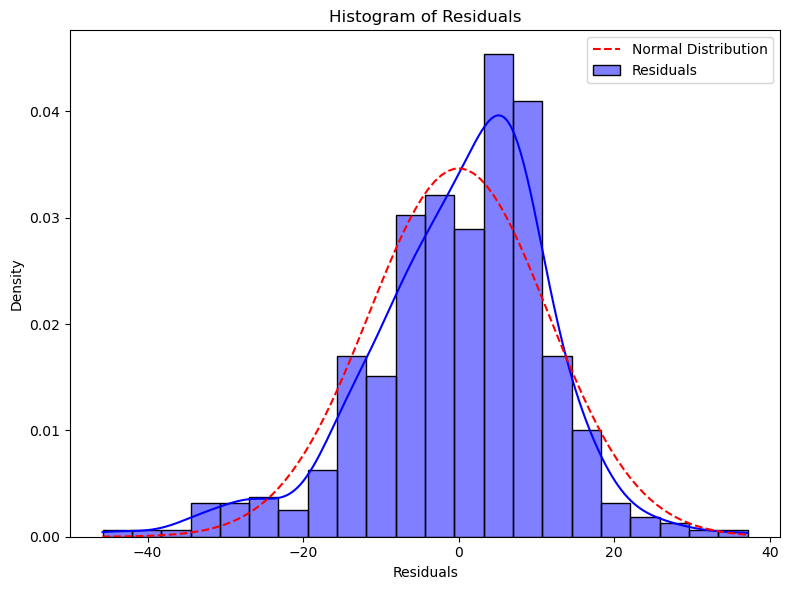

<Figure size 800x600 with 0 Axes>

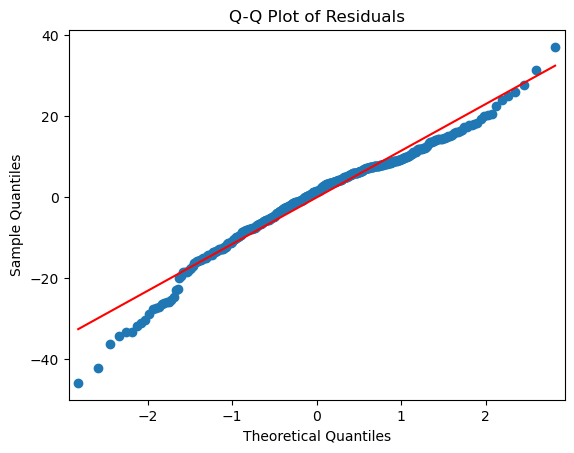

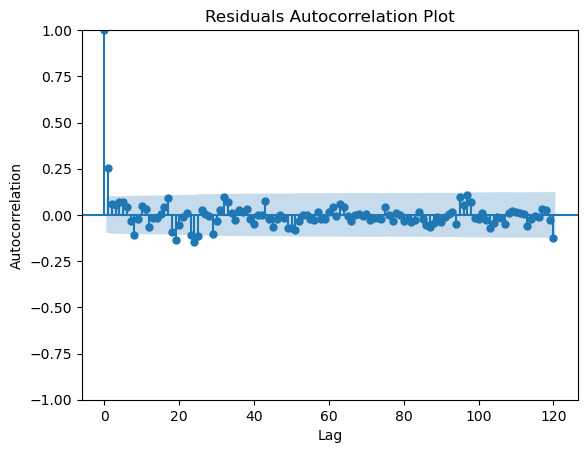

In [ ]:
summed_residuals_2 = summed_result_2_lower.resid
summed_predicted_2 = summed_result_2_lower.predict()

print(model_comparison(summed_2_endo_lower, summed_predicted_2))

for colname in summed_data_2_lower.columns:
    plt.figure(figsize=(10, 6))
    colormap = plt.cm.viridis_r
    norm = plt.Normalize(vmin=0, vmax=len(summed_data_2_lower))
    colors = [colormap(norm(i)) for i in range(len(summed_data_2_lower))]
    sns.scatterplot(x=summed_data_2_lower[colname], y=summed_2_endo_lower, hue=range(len(summed_data_2_lower)), palette=colors, legend=False)
    plt.title('Scatter Plot of Aggregate Production (Colored by Index)')
    plt.xlabel(colname)
    plt.ylabel('Production')
    plt.show()

colors = range(len(summed_residuals_2))
plt.scatter(summed_predicted_2, summed_residuals_2, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

plt.scatter(summed_2_endo_lower, summed_residuals_2, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Actual Values')
plt.xlabel('Actual Values')
plt.ylabel('Residuals')
plt.show()

num_columns = summed_data_2_lower.shape[1]
num_rows = (num_columns + 2) // 3

fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 4*num_rows))
axes = axes.flatten()

for i, column in enumerate(summed_data_2_lower.columns):
    if i < num_columns:
        axes[i].scatter(summed_data_2_lower[column], summed_residuals_2[:len(summed_data_2_lower)], s=5)
        axes[i].axhline(y=0, color='red', linestyle='--')
        axes[i].set_title('{}'.format(column))
        axes[i].set_ylabel('Residuals')

from scipy.stats import norm
mean_residuals = np.mean(summed_residuals_2)
std_residuals = np.std(summed_residuals_2)

plt.figure(figsize=(8, 6))
sns.histplot(summed_residuals_2, kde=True, stat='density', color='blue', label='Residuals')

sns.lineplot(x=np.linspace(min(summed_residuals_2), max(summed_residuals_2), 100),
             y=norm.pdf(np.linspace(min(summed_residuals_2), max(summed_residuals_2), 100), mean_residuals, std_residuals),
             color='red', linestyle='--', label='Normal Distribution')

plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(8, 6))
sm.qqplot(summed_residuals_2, line='s')
plt.title('Q-Q Plot of Residuals')
plt.show()

sm.graphics.tsa.plot_acf(summed_residuals_2, lags=120)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Residuals Autocorrelation Plot')
plt.show()

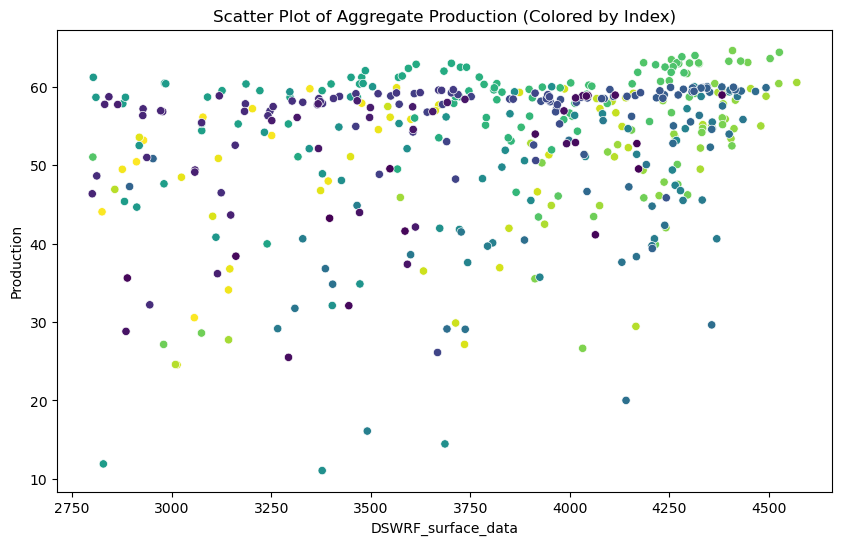

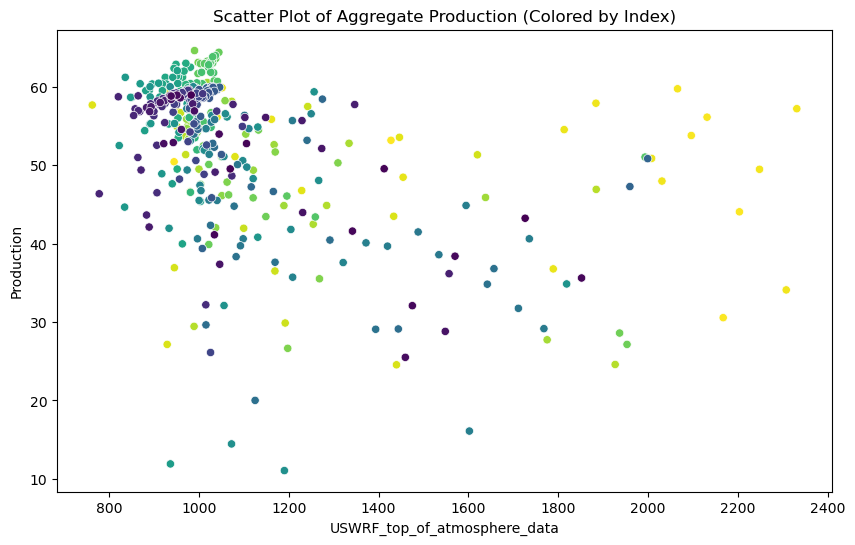

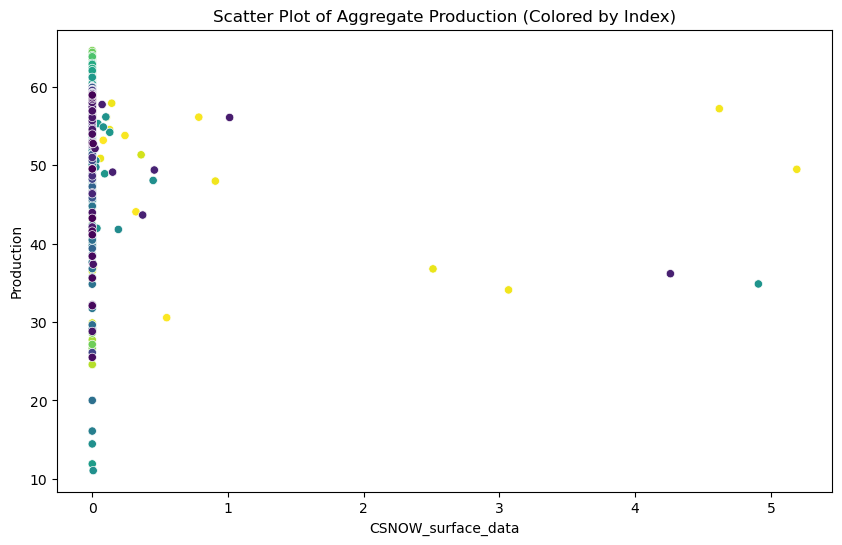

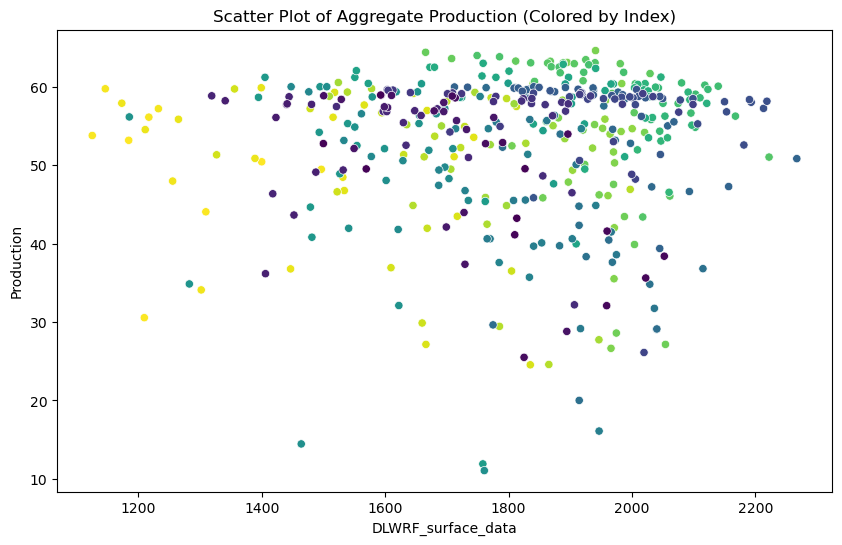

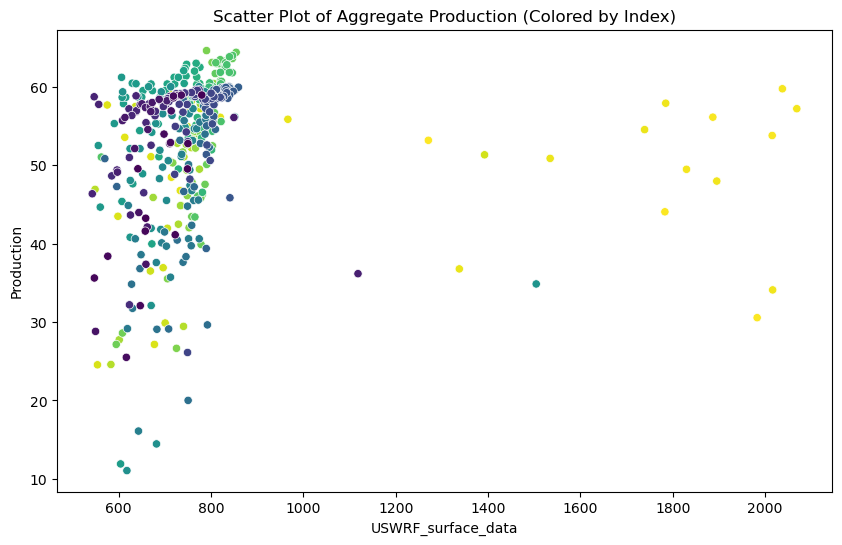

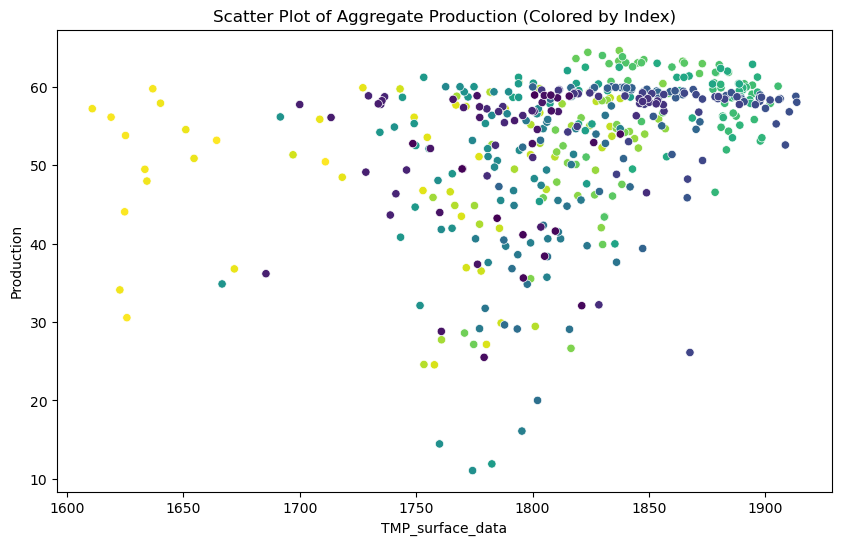

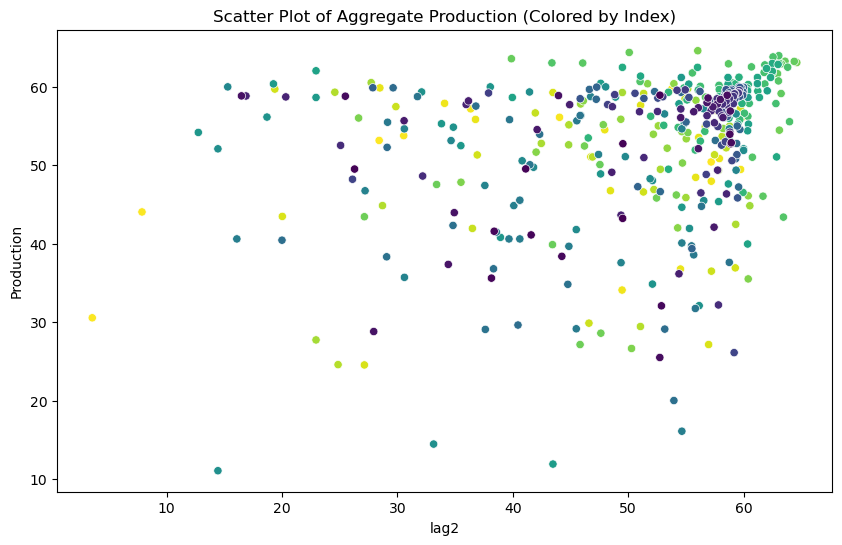

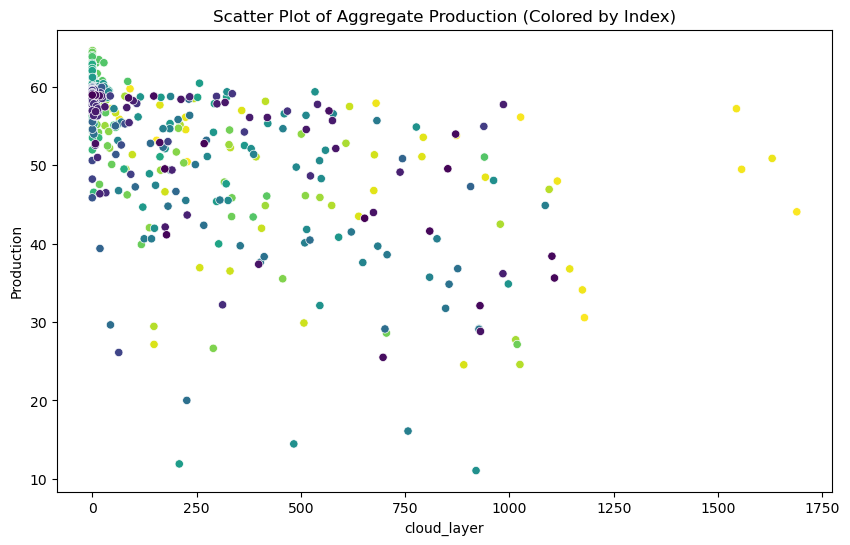

     n       mean        sd        CV         FBias      MAPE      RMSE  \
0  436  52.714518  9.538124  0.180939 -2.304426e-15  0.121534  6.954672   

             ME       MAD      MADP     WMAPE  
0 -1.214767e-13  4.757399  0.090248  0.090248  


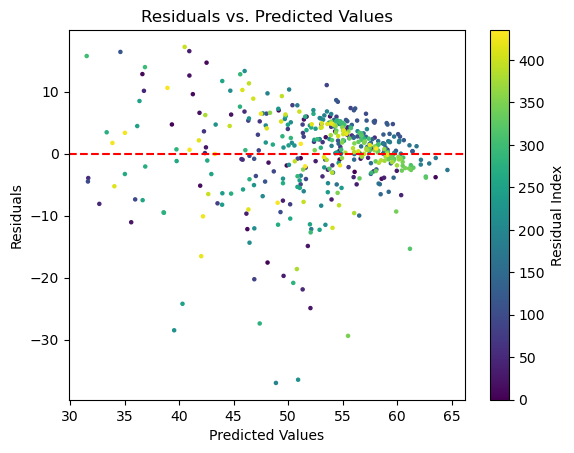

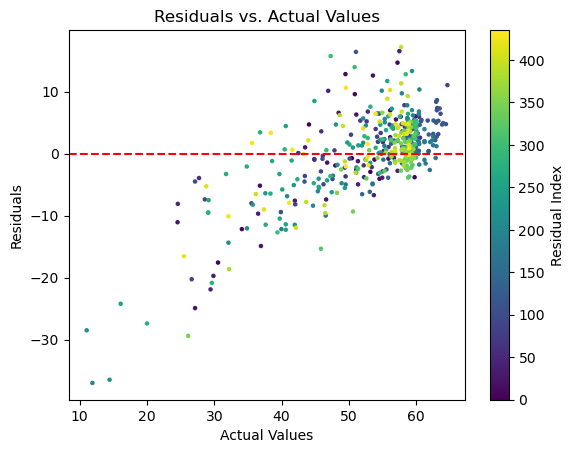

/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/emirsener/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


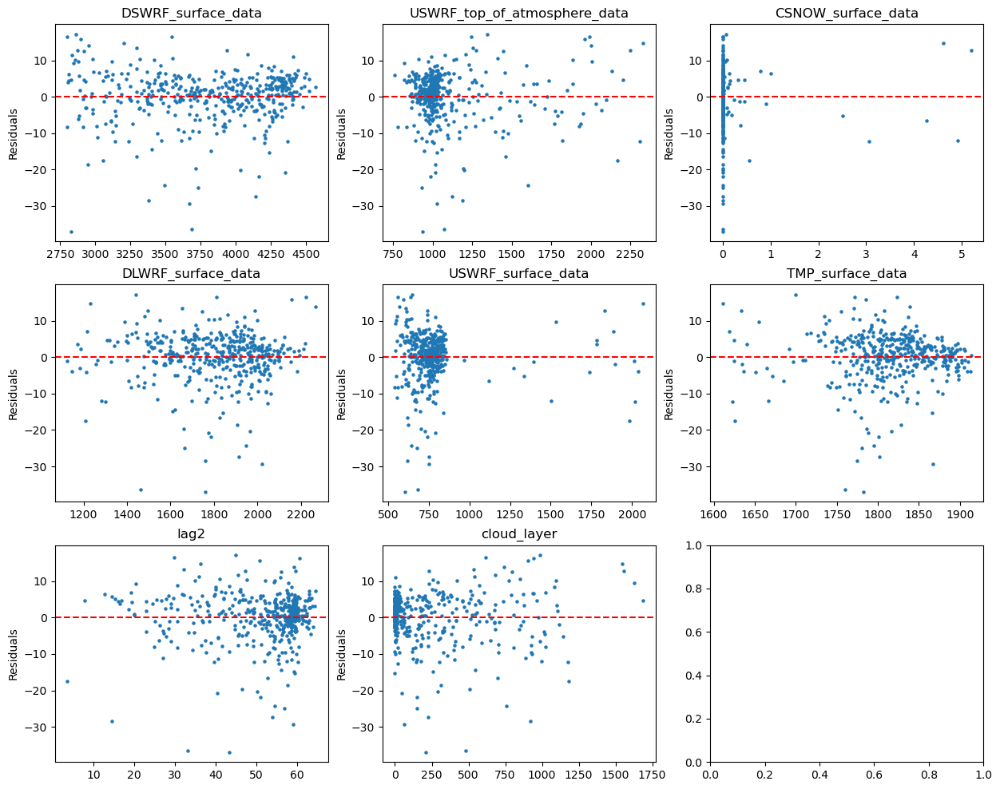

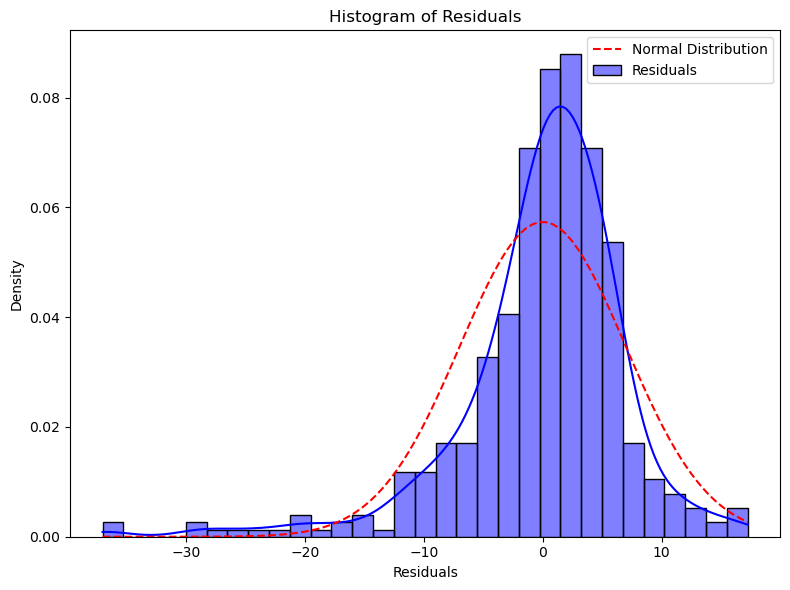

<Figure size 800x600 with 0 Axes>

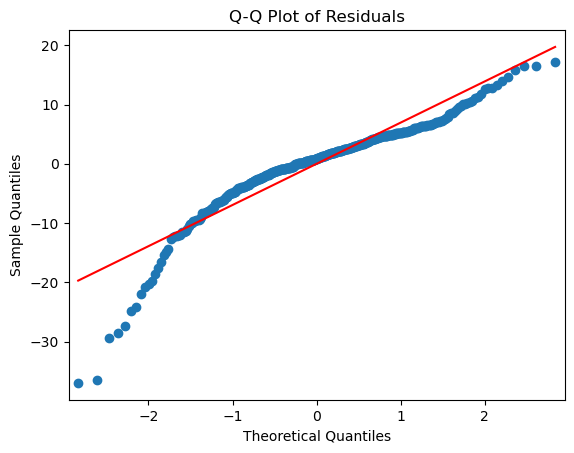

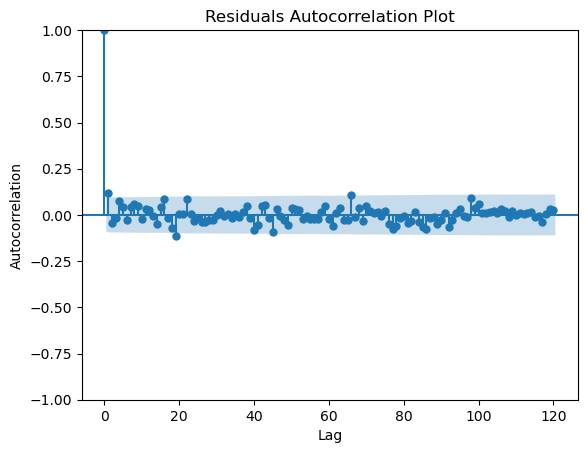

In [ ]:
for colname in summed_data_2_higher.columns:
    plt.figure(figsize=(10, 6))
    colormap = plt.cm.viridis_r
    norm = plt.Normalize(vmin=0, vmax=len(summed_data_2_higher))
    colors = [colormap(norm(i)) for i in range(len(summed_data_2_higher))]
    sns.scatterplot(x=summed_data_2_higher[colname], y=summed_2_endo_higher, hue=range(len(summed_data_2_higher)), palette=colors, legend=False)
    plt.title('Scatter Plot of Aggregate Production (Colored by Index)')
    plt.xlabel(colname)
    plt.ylabel('Production')
    plt.show()

summed_residuals_2 = summed_result_2_higher.resid
summed_predicted_2 = summed_result_2_higher.predict()

print(model_comparison(summed_2_endo_higher, summed_predicted_2))

colors = range(len(summed_residuals_2))
plt.scatter(summed_predicted_2, summed_residuals_2, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Predicted Values')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

plt.scatter(summed_2_endo_higher, summed_residuals_2, c=colors, cmap='viridis', s=5)
plt.axhline(y=0, color='red', linestyle='--')
plt.colorbar(label='Residual Index')
plt.title('Residuals vs. Actual Values')
plt.xlabel('Actual Values')
plt.ylabel('Residuals')
plt.show()

num_columns = summed_data_2_higher.shape[1]
num_rows = (num_columns + 2) // 3

fig, axes = plt.subplots(nrows=num_rows, ncols=3, figsize=(15, 4*num_rows))
axes = axes.flatten()

for i, column in enumerate(summed_data_2_higher.columns):
    if i < num_columns:
        axes[i].scatter(summed_data_2_higher[column], summed_residuals_2[:len(summed_data_2_higher)], s=5)
        axes[i].axhline(y=0, color='red', linestyle='--')
        axes[i].set_title('{}'.format(column))
        axes[i].set_ylabel('Residuals')

from scipy.stats import norm
mean_residuals = np.mean(summed_residuals_2)
std_residuals = np.std(summed_residuals_2)

plt.figure(figsize=(8, 6))
sns.histplot(summed_residuals_2, kde=True, stat='density', color='blue', label='Residuals')

sns.lineplot(x=np.linspace(min(summed_residuals_2), max(summed_residuals_2), 100),
             y=norm.pdf(np.linspace(min(summed_residuals_2), max(summed_residuals_2), 100), mean_residuals, std_residuals),
             color='red', linestyle='--', label='Normal Distribution')

plt.title('Histogram of Residuals')
plt.xlabel('Residuals')
plt.ylabel('Density')
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(8, 6))
sm.qqplot(summed_residuals_2, line='s')
plt.title('Q-Q Plot of Residuals')
plt.show()

sm.graphics.tsa.plot_acf(summed_residuals_2, lags=120)
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.title('Residuals Autocorrelation Plot')
plt.show()

Model 6 results that the variation in production in 7 th month might not be explained by exogenous variables

     n       mean         sd        CV         FBias  MAPE      RMSE  \
0  835  45.041485  15.928377  0.353638  5.813621e-15   inf  9.709678   

        MAD      MADP     WMAPE  
0  6.891607  0.153006  0.153006  

     n       mean         sd        CV         FBias  MAPE       RMSE  \
0  416  37.207115  17.096979  0.459508  6.582942e-15   inf  11.574824   

        MAD      MADP     WMAPE  
0  8.902253  0.239262  0.239262  

     n       mean        sd        CV         FBias      MAPE      RMSE  \
0  418  52.924522  9.464825  0.178836 -5.167245e-15  0.122189  6.986702   

        MAD      MADP     WMAPE  
0  4.786396  0.090438  0.090438  

In [ ]:

z_scores = (summed_residuals_1 - np.mean(summed_residuals_1)) / np.std(summed_residuals_1)
threshold = 3.25
outliers = np.abs(z_scores) > threshold
outlier_indices = np.where(outliers)[0]
print(outlier_indices)

summed_data_1 = pd.merge(production_data, weighted_weather_data, on='date_hour', how='inner')
summed_data_1 = summed_data_1[((summed_data_1['date_hour'].dt.hour >= 6) & (summed_data_1['date_hour'].dt.hour <= 8)) | ((summed_data_1['date_hour'].dt.hour >= 15) & (summed_data_1['date_hour'].dt.hour <= 17))]
summed_data_1['date'] = summed_data_1['date_hour'].dt.date

summed_data_1 = summed_data_1.drop(columns=['date_hour', 'TCDC_high_cloud_layer_data', 'USWRF_surface_data'])
summed_data_1 = summed_data_1.groupby('date').sum()

summed_data_1 = summed_data_1.drop(summed_data_1.index[outlier_indices])

summed_1_endo = summed_data_1['production']
summed_data_1 = summed_data_1.drop(['production'], axis=1)

exogenous_data_with_const = sm.add_constant(summed_data_1)

summed_model_1 = sm.OLS(summed_1_endo, exogenous_data_with_const)
summed_result_1 = summed_model_1.fit()

summed_residuals_1 = summed_result_1.resid
summed_predicted_1 = summed_result_1.predict()

[117 460 517 526]
